# ROI 1100

In [1]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi1100"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=1100)
        
        
    

In [2]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1100/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1100/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




Using TensorFlow backend.


Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 690us/step - loss: 0.0942 - mean_squared_error: 0.0942 - val_loss: 0.0696 - val_mean_squared_error: 0.0696
Epoch 2/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0644 - mean_squared_error: 0.0644 - val_loss: 0.0561 - val_mean_squared_error: 0.0561
Epoch 3/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0552 - mean_squared_error: 0.0552 - val_loss: 0.0486 - val_mean_squared_error: 0.0486
Epoch 4/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0494 - mean_squared_error: 0.0494 - val_loss: 0.0437 - val_mean_squared_error: 0.0437
Epoch 5/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0444 - mean_squared_error: 0.0444 - val_loss: 0.0389 - val_mean_squared_error: 0.0389
Epoch 6/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0409 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 346us/step - loss: 0.0133 - mean_squared_error: 0.0133 - val_loss: 0.0113 - val_mean_squared_error: 0.0113
Epoch 98/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0134 - mean_squared_error: 0.0134 - val_loss: 0.0116 - val_mean_squared_error: 0.0116
Epoch 99/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0133 - mean_squared_error: 0.0133 - val_loss: 0.0118 - val_mean_squared_error: 0.0118
Epoch 100/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0133 - mean_squared_error: 0.0133 - val_loss: 0.0111 - val_mean_squared_error: 0.0111
Epoch 101/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0133 - mean_squared_error: 0.0133 - val_loss: 0.0109 - val_mean_squared_error: 0.0109
Epoch 102/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0134 - mean_squared_error: 0.0134 - val_loss: 0.0105 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 334us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0079 - val_mean_squared_error: 0.0079
Epoch 194/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0102 - mean_squared_error: 0.0102 - val_loss: 0.0071 - val_mean_squared_error: 0.0071
Epoch 195/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0101 - mean_squared_error: 0.0101 - val_loss: 0.0069 - val_mean_squared_error: 0.0069
Epoch 196/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0101 - mean_squared_error: 0.0101 - val_loss: 0.0069 - val_mean_squared_error: 0.0069
Epoch 197/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0101 - mean_squared_error: 0.0101 - val_loss: 0.0072 - val_mean_squared_error: 0.0072
Epoch 198/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0100 - mean_squared_error: 0.0100 - val_loss: 0.0071 - val_mean_squared_error: 0.

Epoch 241/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0094 - mean_squared_error: 0.0094 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 242/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 243/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 244/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 245/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 246/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0063 - val_mean_sq

3600/3600 [==============================] - 1s 338us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 338/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 339/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 340/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 341/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 342/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0052 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 334us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 434/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 435/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 436/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 437/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 438/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0048 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 333us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 530/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 531/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 532/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 533/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 534/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0043 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 336us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 626/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 627/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 628/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 629/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 630/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0037 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 336us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 722/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 723/2000
3600/3600 [==============================] - 1s 328us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 724/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 725/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 726/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0037 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 818/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 819/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 820/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 821/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 822/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0048 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 334us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 914/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 915/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 916/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 917/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 918/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0036 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1010/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1011/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1012/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1013/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1014/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0039 - val_mean_squared_erro

3600/3600 [==============================] - 1s 337us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1058/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1059/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1060/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1061/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1062/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0036 - val_mean_squared_erro

3600/3600 [==============================] - 1s 331us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1106/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1107/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1108/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1109/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 1110/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1154/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1155/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1156/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1157/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1158/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1202/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1203/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1204/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1205/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1206/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 331us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1250/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1251/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1252/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1253/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1254/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 337us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1298/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1299/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1300/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1301/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1302/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0036 - val_mean_squared_erro

3600/3600 [==============================] - 1s 331us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1346/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1347/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1348/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1349/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1350/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1394/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 1395/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1396/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1397/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1398/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1442/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1443/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1444/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1445/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1446/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0031 - val_mean_squared_erro

Epoch 1489/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1490/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1491/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1492/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1493/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1494/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_m

Epoch 1537/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1538/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1539/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1540/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1541/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1542/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_m

Epoch 1585/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1586/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1587/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1588/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1589/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1590/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_m

Epoch 1633/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1634/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1635/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1636/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1637/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1638/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0031 - val_m

Epoch 1681/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1682/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1683/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1684/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1685/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1686/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_m

Epoch 1729/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1730/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1731/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1732/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1733/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1734/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_m

Epoch 1777/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1778/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1779/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1780/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1781/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1782/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_m

Epoch 1825/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1826/2000
3600/3600 [==============================] - 1s 329us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1827/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1828/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1829/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1830/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0028 - val_m

Epoch 1873/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1874/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1875/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1876/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1877/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1878/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0026 - val_m

Epoch 1921/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1922/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1923/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1924/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1925/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1926/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0026 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1970/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1971/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1972/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1973/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1974/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0023 - val_m

<Figure size 640x480 with 1 Axes>

save the model


(500, 9)


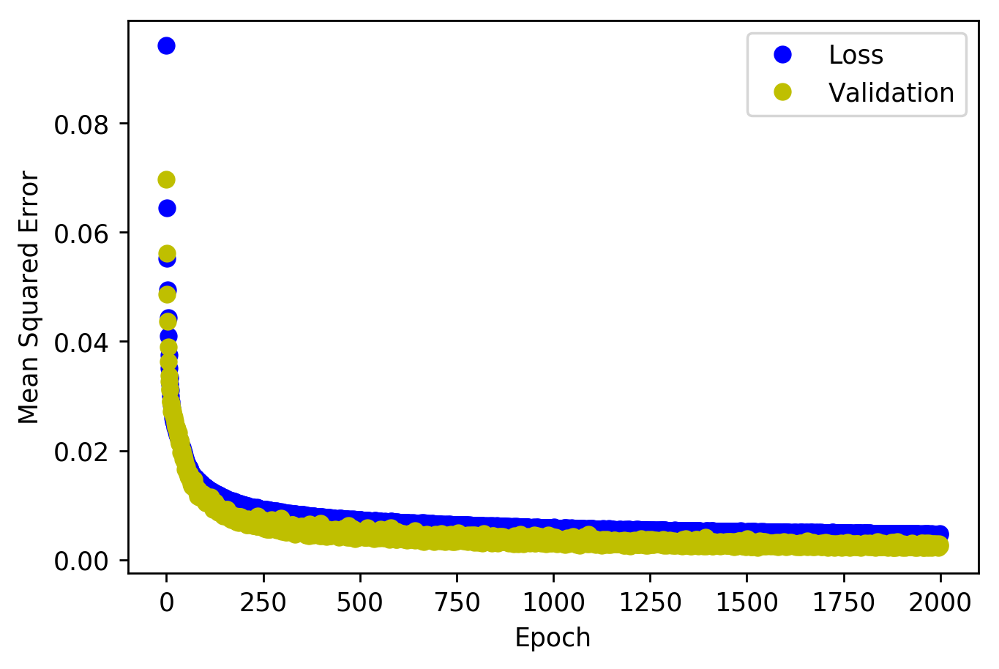

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


<Figure size 432x288 with 0 Axes>

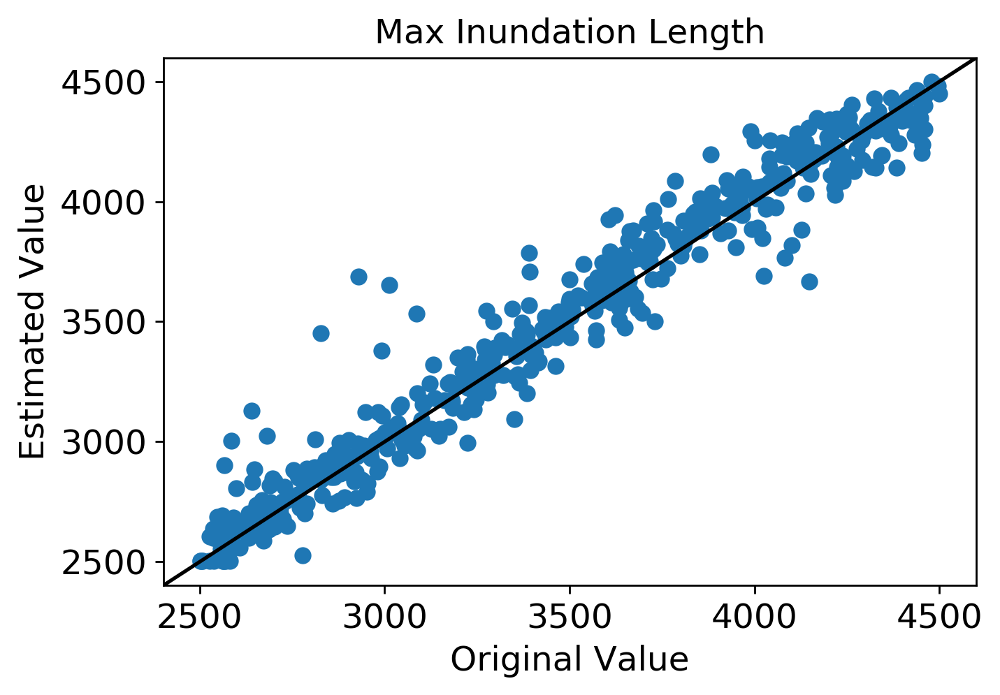

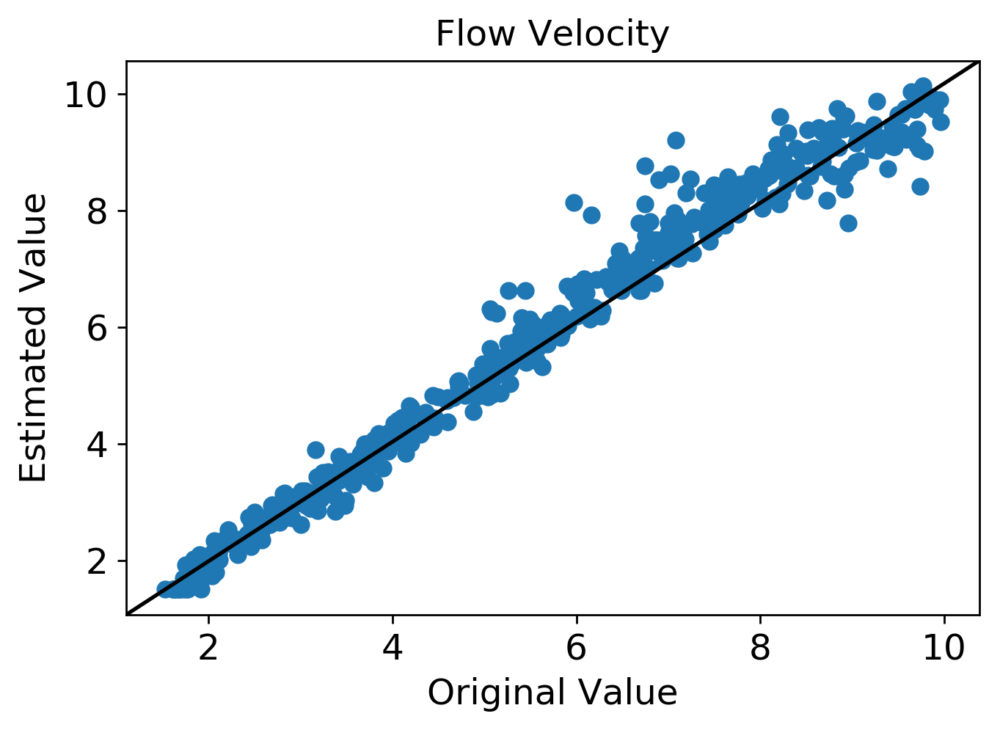

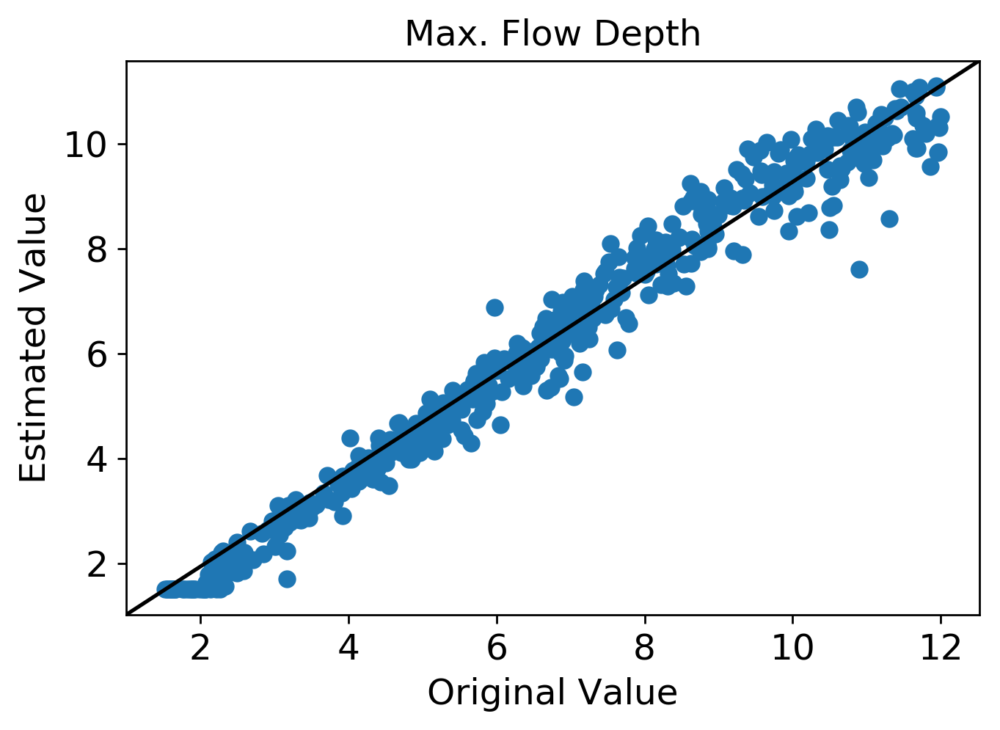

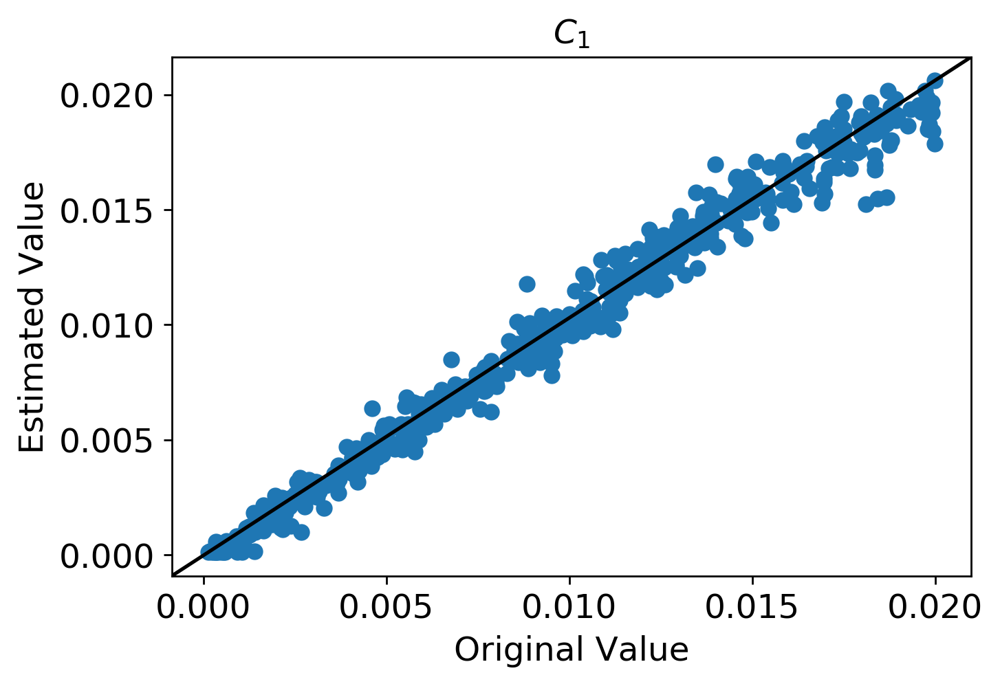

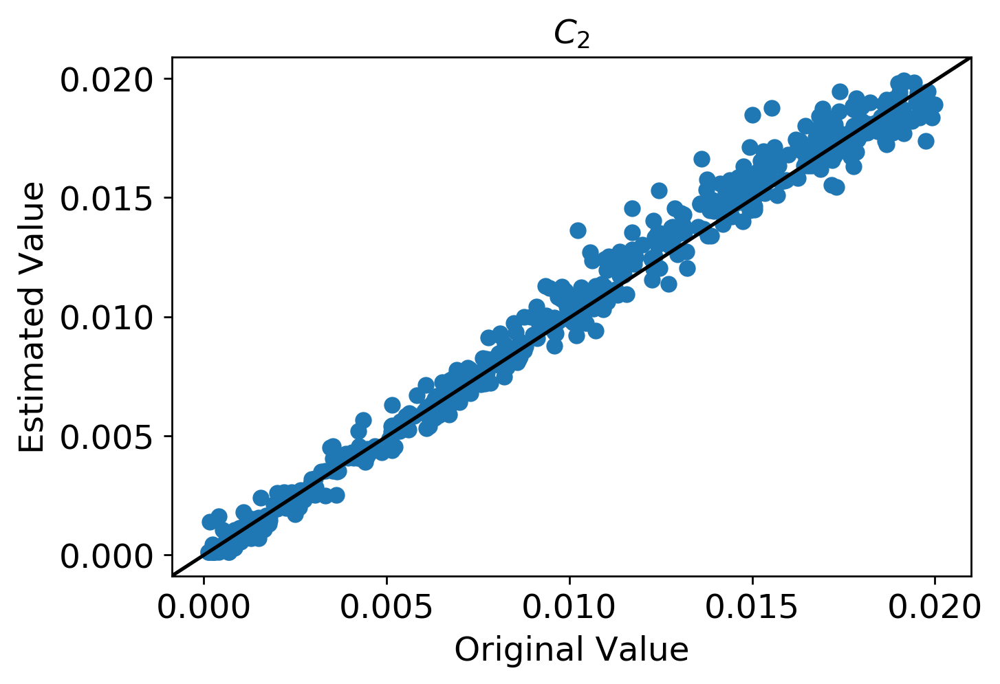

...

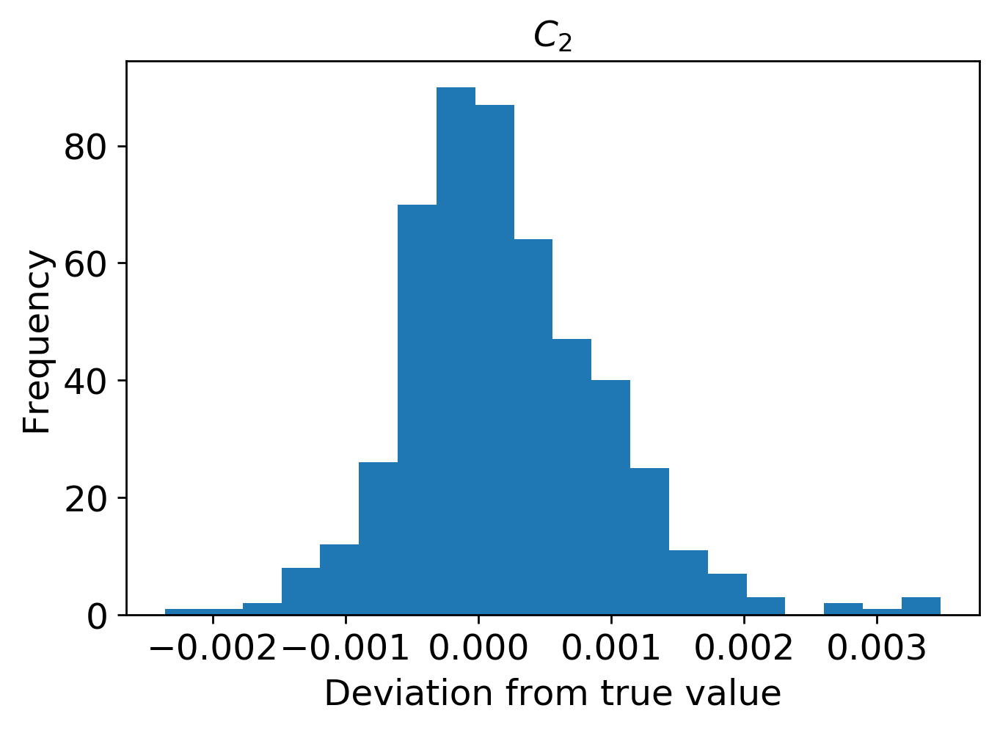

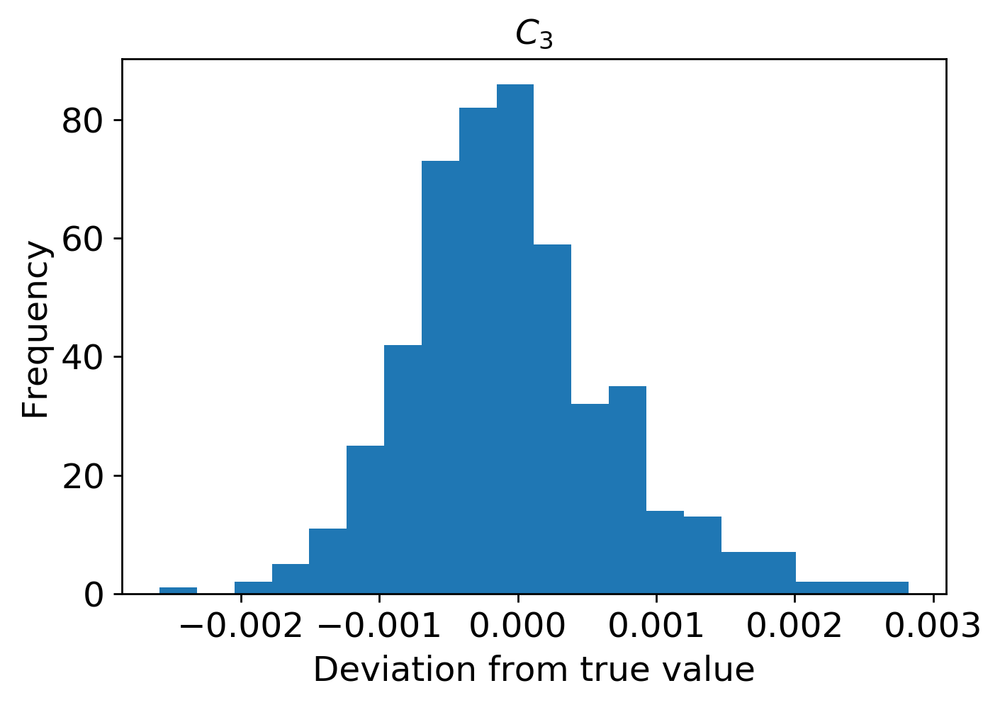

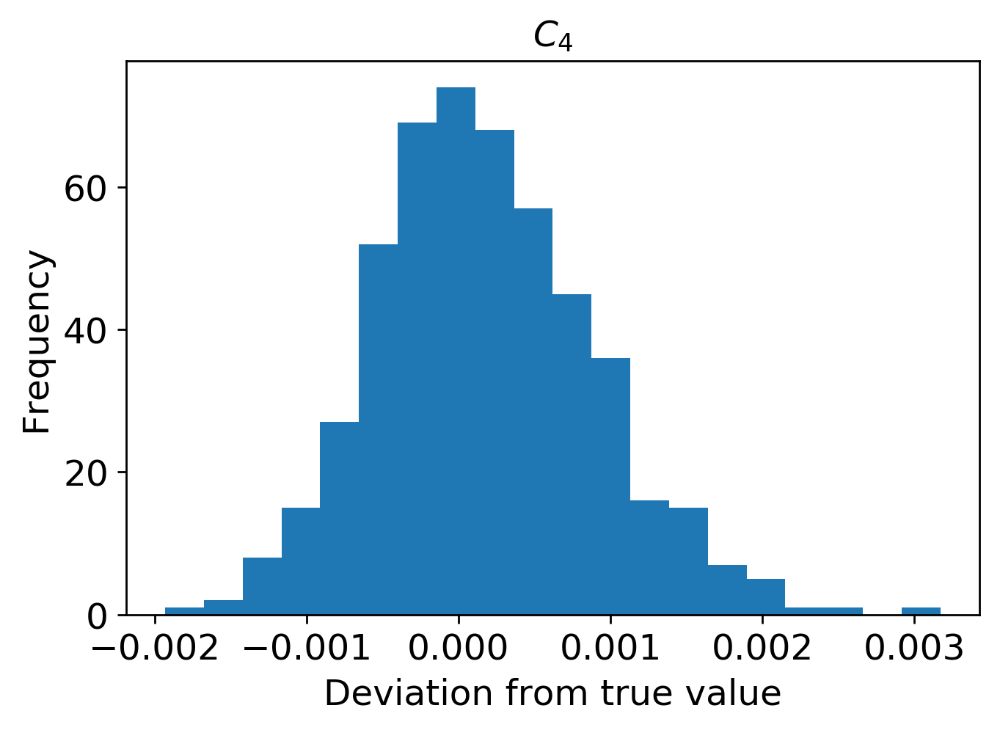

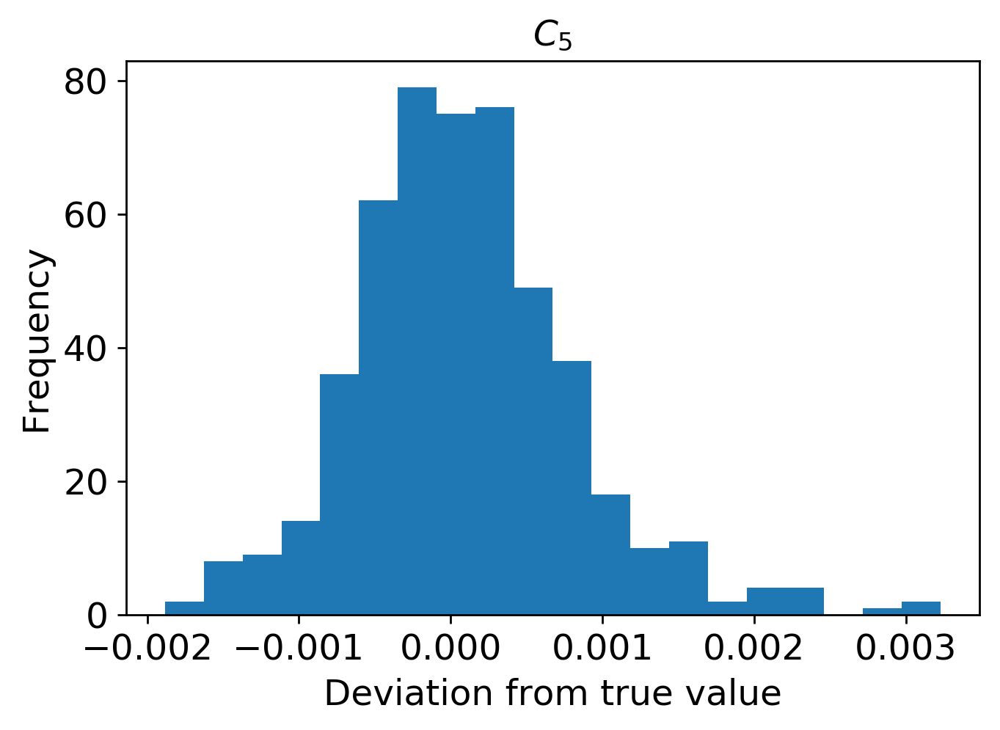

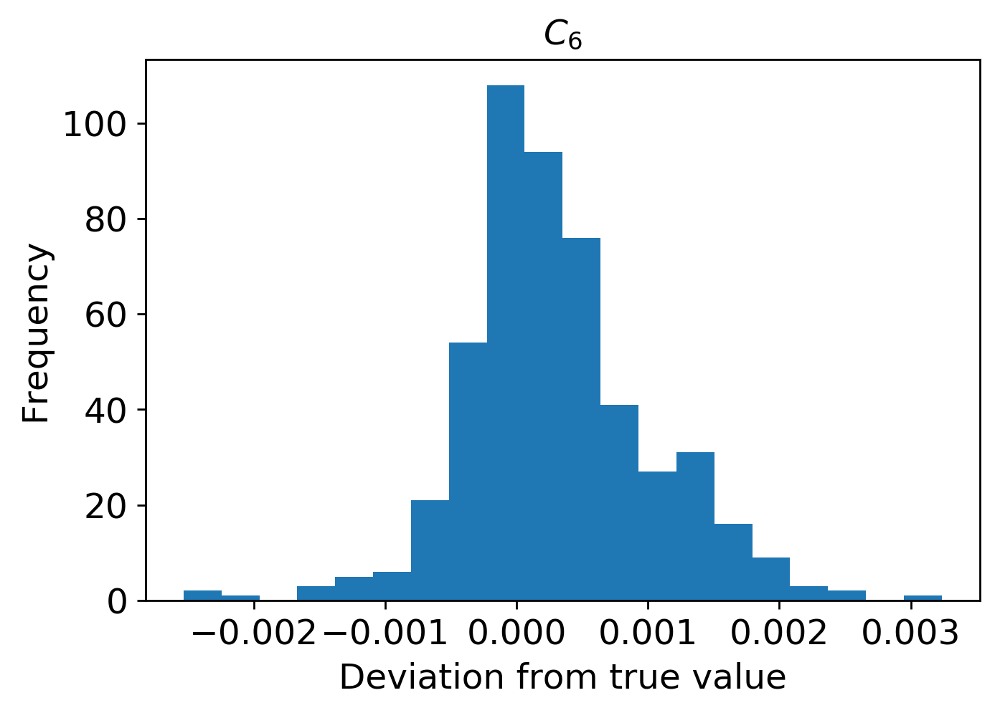

In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1100/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1100/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1100/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1100/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='power',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi1100.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

<Figure size 640x480 with 1 Axes>

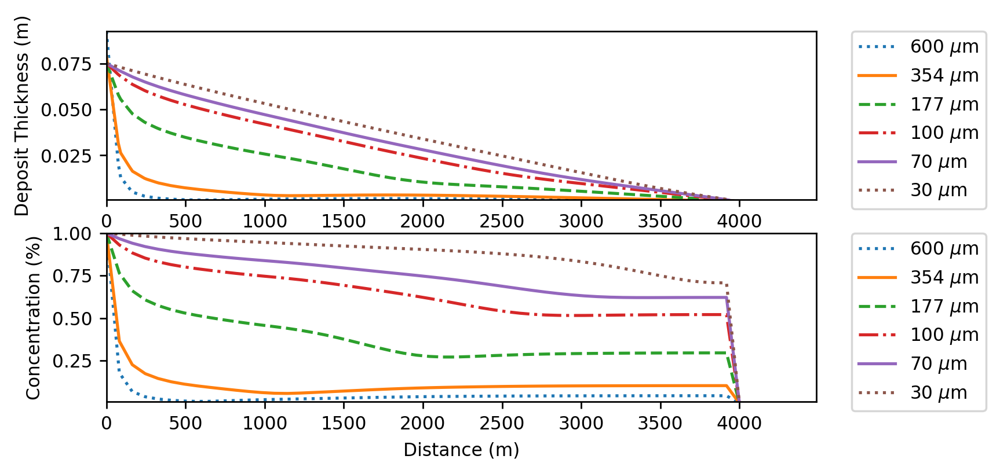

(5000, 9)
(5000, 1800)


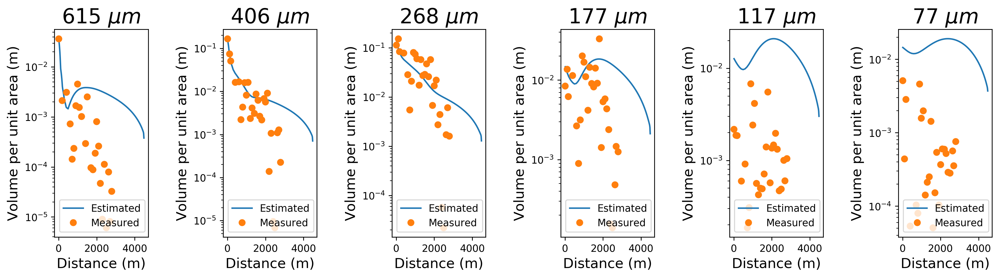

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi1100.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1100.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1100.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1100.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1100.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1100.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1100.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1100.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
5    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
6    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


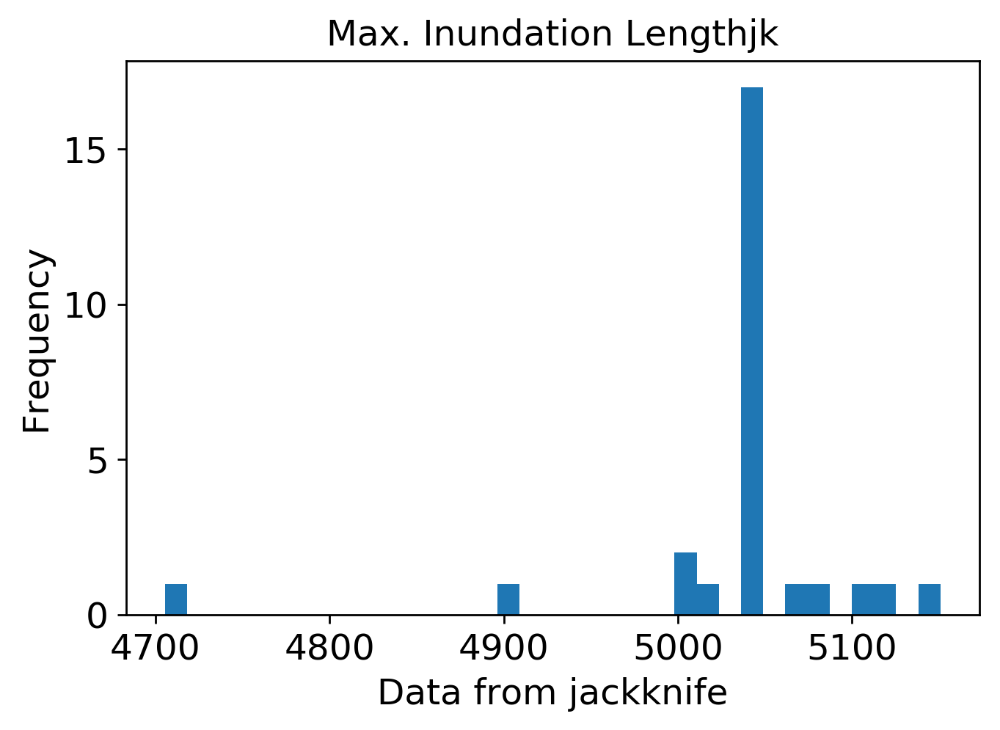

mean: 4.331873286551478
jk_e: 0.07078221984938332


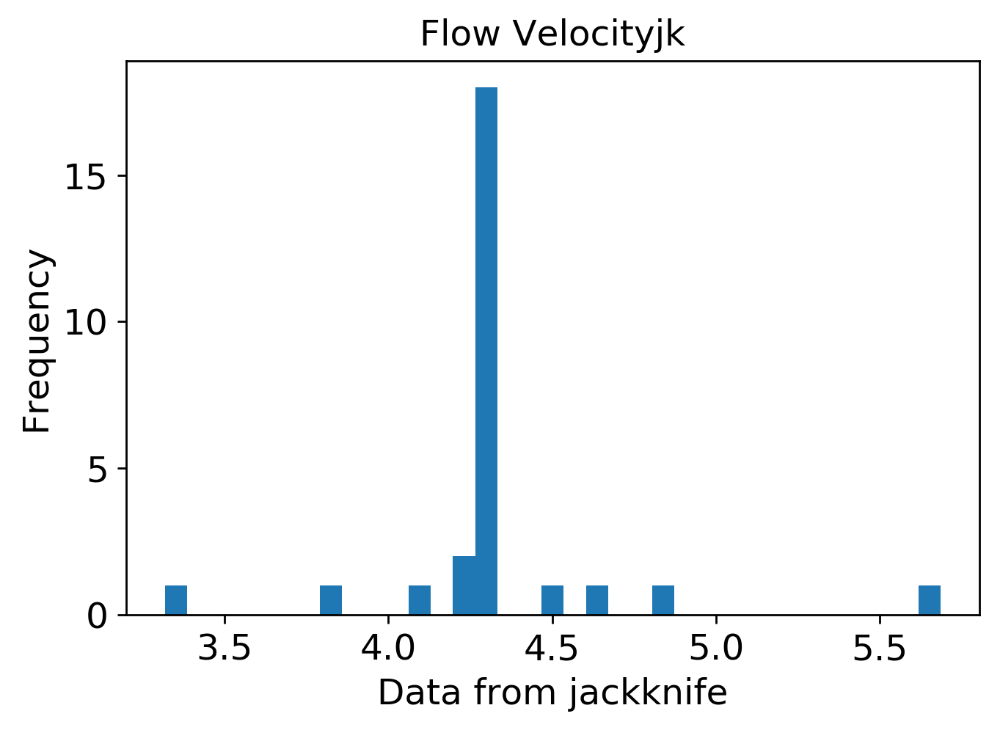

mean: 5.076625926841528
jk_e: 0.08862159144585159


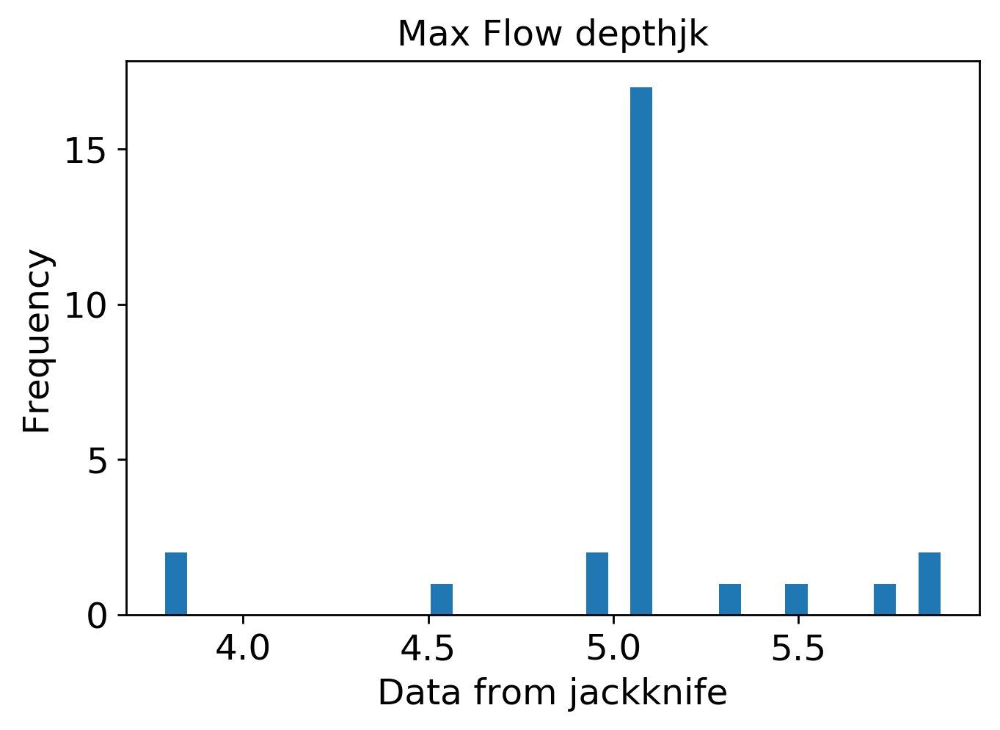

mean: 0.003967505435335851
jk_e: 0.0001603505458140273


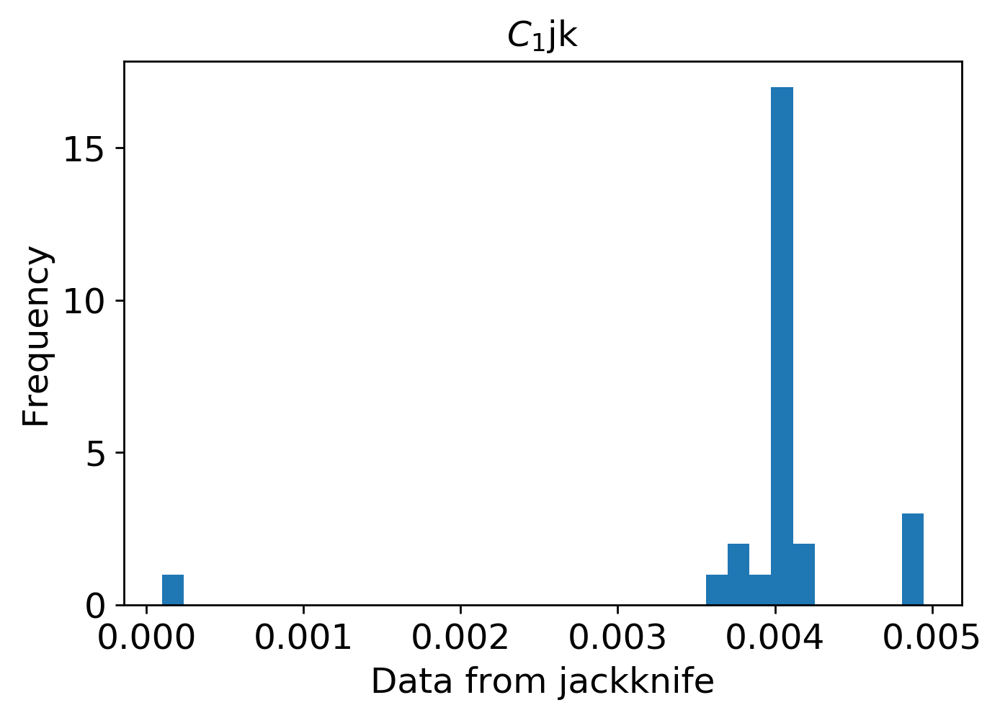

mean: 0.01978917054980993
jk_e: 0.0002898223559993373


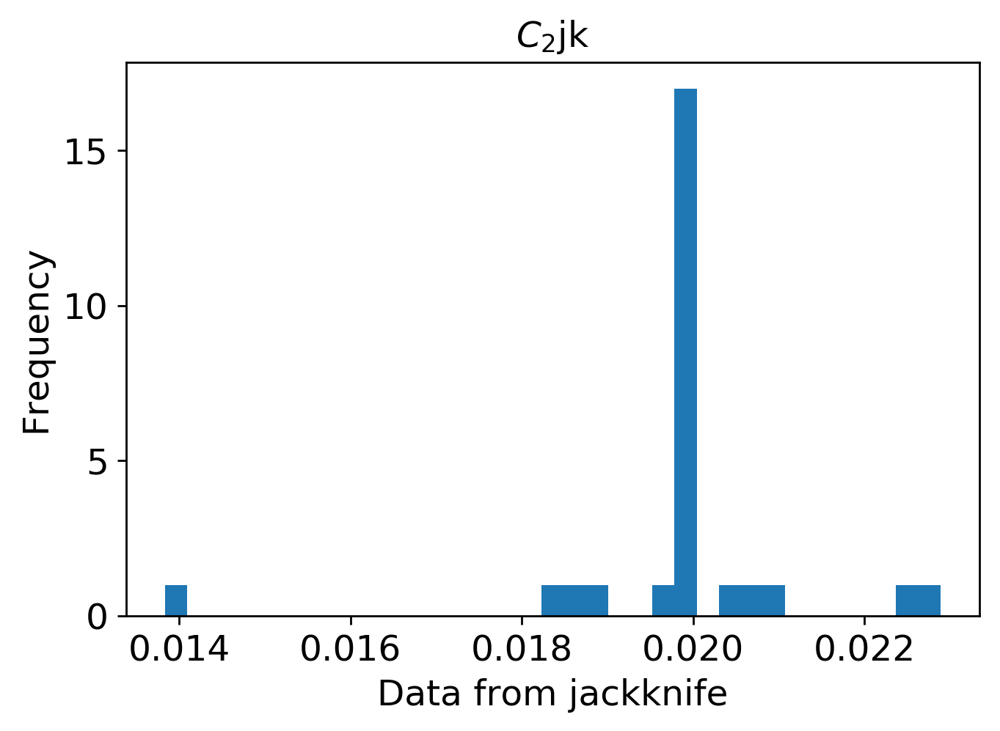

mean: 0.01822463838717053
jk_e: 0.0003478810560399602


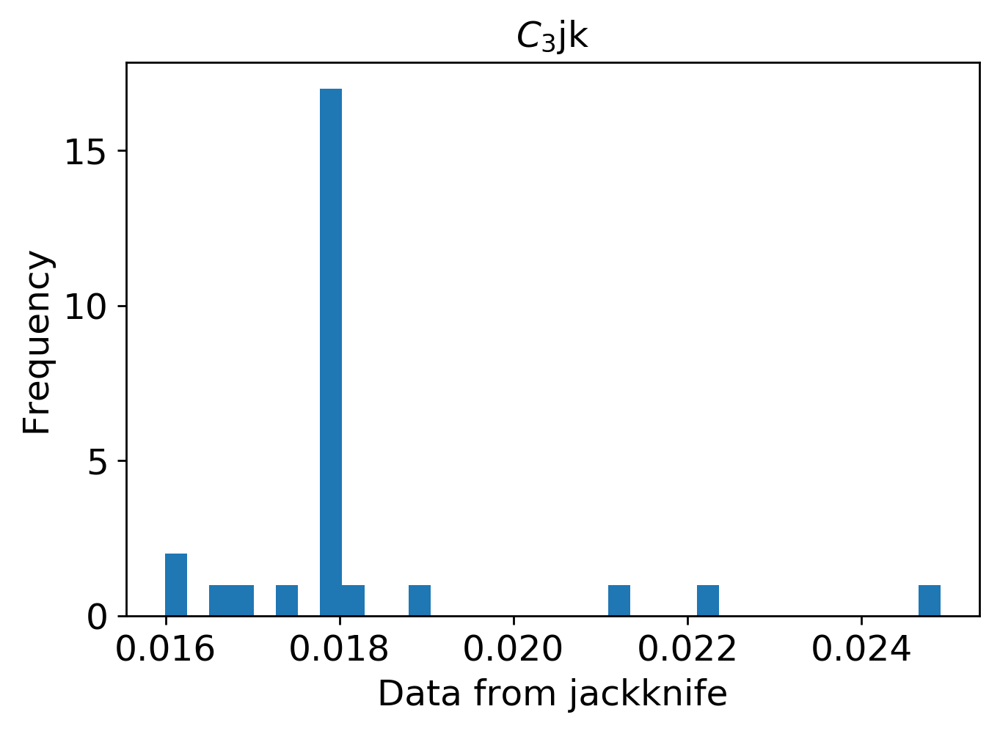

mean: 0.002052168582814508
jk_e: 7.776562087910624e-05


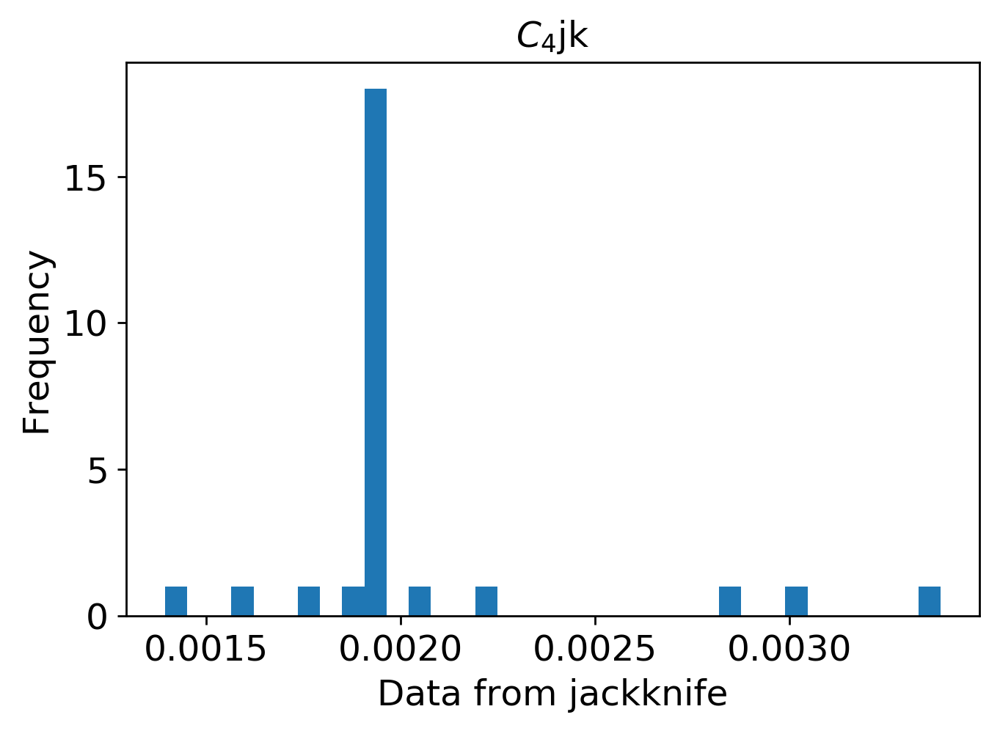

mean: 0.0016196489348604731
jk_e: 7.852690451376367e-05


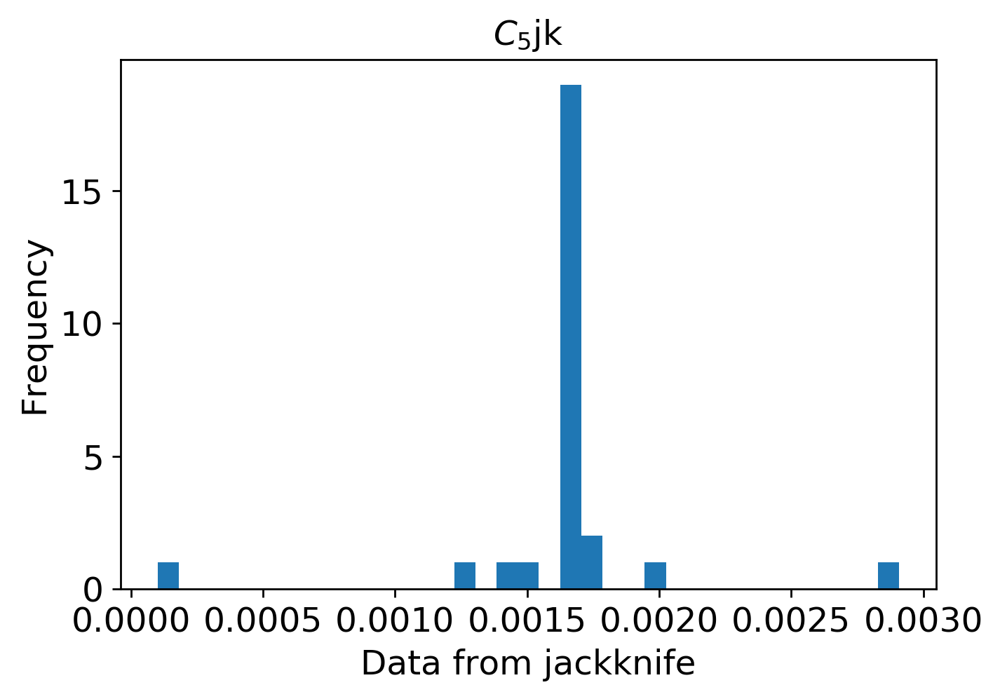

mean: 0.0016370432209222938
jk_e: 6.290408204085463e-05


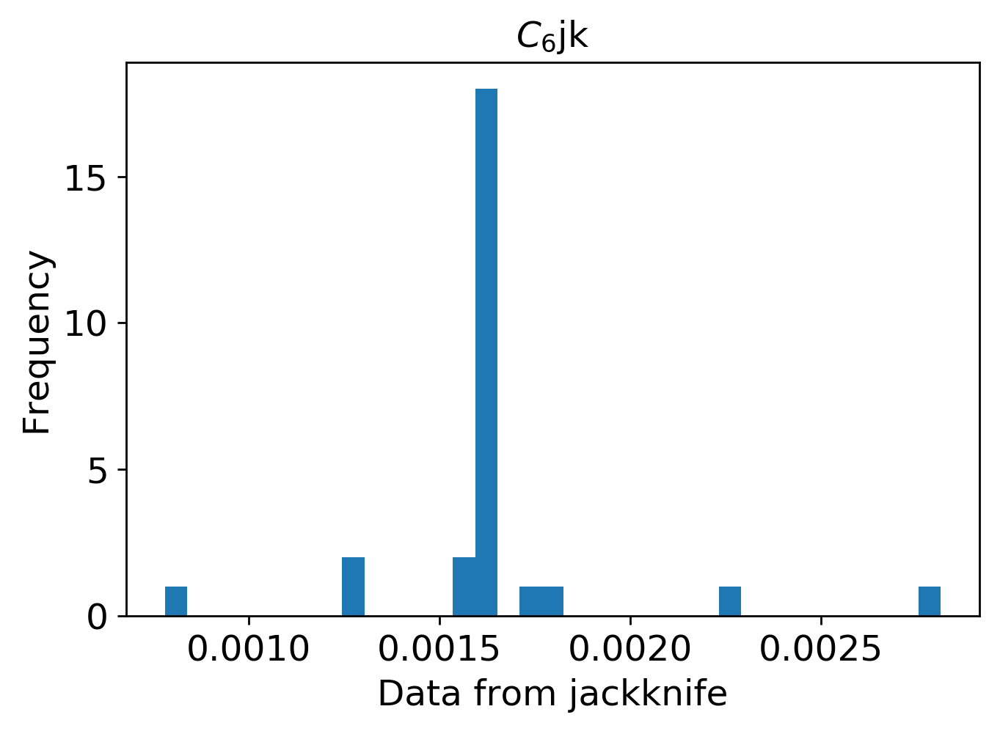

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1100/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1100/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi1100.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi1100.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi1100.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 1300

In [6]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi1300"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=1300)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 497us/step - loss: 0.0980 - mean_squared_error: 0.0980 - val_loss: 0.0708 - val_mean_squared_error: 0.0708
Epoch 2/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0650 - mean_squared_error: 0.0650 - val_loss: 0.0571 - val_mean_squared_error: 0.0571
Epoch 3/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0557 - mean_squared_error: 0.0557 - val_loss: 0.0497 - val_mean_squared_error: 0.0497
Epoch 4/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0500 - mean_squared_error: 0.0500 - val_loss: 0.0437 - val_mean_squared_error: 0.0437
Epoch 5/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0452 - mean_squared_error: 0.0452 - val_loss: 0.0396 - val_mean_squared_error: 0.0396
Epoch 6/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0409 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 342us/step - loss: 0.0127 - mean_squared_error: 0.0127 - val_loss: 0.0108 - val_mean_squared_error: 0.0108
Epoch 98/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0128 - mean_squared_error: 0.0128 - val_loss: 0.0104 - val_mean_squared_error: 0.0104
Epoch 99/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0129 - mean_squared_error: 0.0129 - val_loss: 0.0110 - val_mean_squared_error: 0.0110
Epoch 100/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0126 - mean_squared_error: 0.0126 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 101/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0127 - mean_squared_error: 0.0127 - val_loss: 0.0107 - val_mean_squared_error: 0.0107
Epoch 102/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0126 - mean_squared_error: 0.0126 - val_loss: 0.0101 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 345us/step - loss: 0.0098 - mean_squared_error: 0.0098 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 194/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0098 - mean_squared_error: 0.0098 - val_loss: 0.0067 - val_mean_squared_error: 0.0067
Epoch 195/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0098 - mean_squared_error: 0.0098 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 196/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0067 - val_mean_squared_error: 0.0067
Epoch 197/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0070 - val_mean_squared_error: 0.0070
Epoch 198/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0062 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 338us/step - loss: 0.0085 - mean_squared_error: 0.0085 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 290/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 291/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 292/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 293/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 294/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0084 - mean_squared_error: 0.0084 - val_loss: 0.0056 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 333us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 386/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 387/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 388/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 389/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 390/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0075 - mean_squared_error: 0.0075 - val_loss: 0.0044 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 334us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 482/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 483/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 484/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 485/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 486/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0053 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 343us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 578/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 579/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 580/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 581/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 582/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0041 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 346us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 674/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 675/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 676/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 677/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 678/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0035 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 339us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 770/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 771/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 772/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 773/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 774/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0041 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 347us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 866/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 867/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 868/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 869/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 870/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0032 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 346us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 962/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 963/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 964/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 965/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 966/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0036 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 343us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1058/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 1059/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1060/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1061/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1062/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1106/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1107/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 1108/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1109/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1110/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1154/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1155/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1156/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1157/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1158/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0033 - val_mean_squared_erro

3600/3600 [==============================] - 1s 342us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1202/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1203/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1204/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1205/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1206/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1250/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1251/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1252/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1253/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1254/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 345us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1298/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1299/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1300/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1301/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1302/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1346/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1347/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1348/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1349/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1350/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1394/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1395/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1396/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1397/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1398/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1442/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1443/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1444/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1445/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1446/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0030 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1490/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1491/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1492/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1493/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1494/2000
3600/3600 [==============================] - 1s 330us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1538/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1539/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1540/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1541/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1542/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 339us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1586/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1587/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1588/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1589/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1590/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1634/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1635/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1636/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1637/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1638/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 339us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1682/2000
3600/3600 [==============================] - 1s 331us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1683/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1684/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1685/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1686/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 335us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1730/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1731/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1732/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1733/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1734/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 337us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1778/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1779/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1780/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1781/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1782/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1826/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1827/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1828/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1829/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1830/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 345us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1874/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1875/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1876/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1877/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1878/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1922/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1923/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1924/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1925/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1926/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 339us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1970/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1971/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1972/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1973/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1974/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_erro

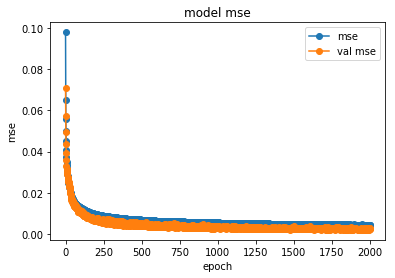

save the model


In [7]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1300/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1300/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


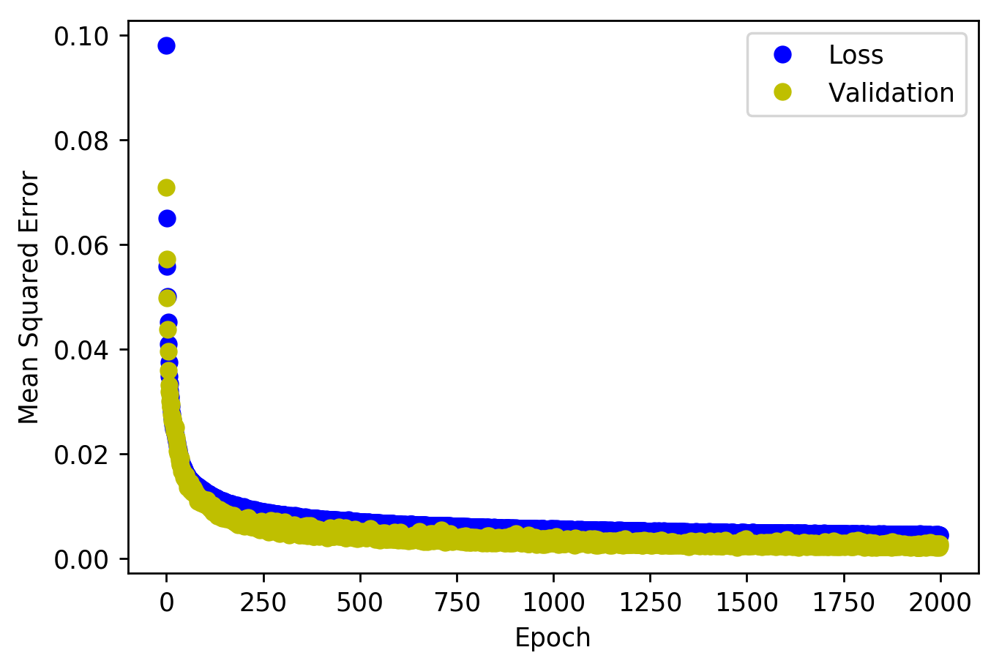

<Figure size 432x288 with 0 Axes>

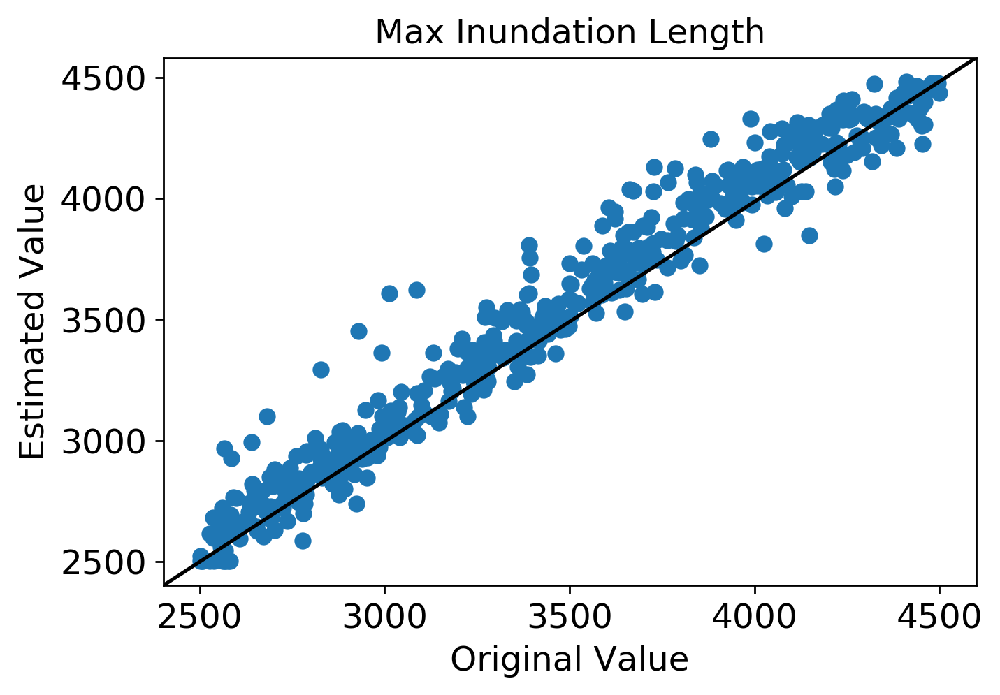

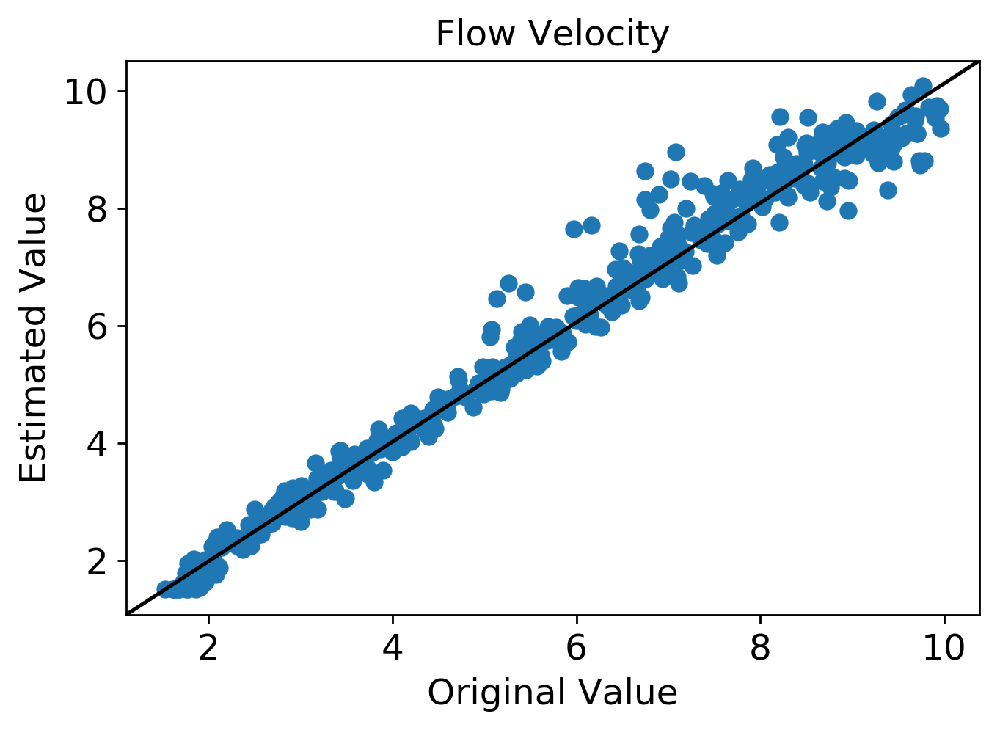

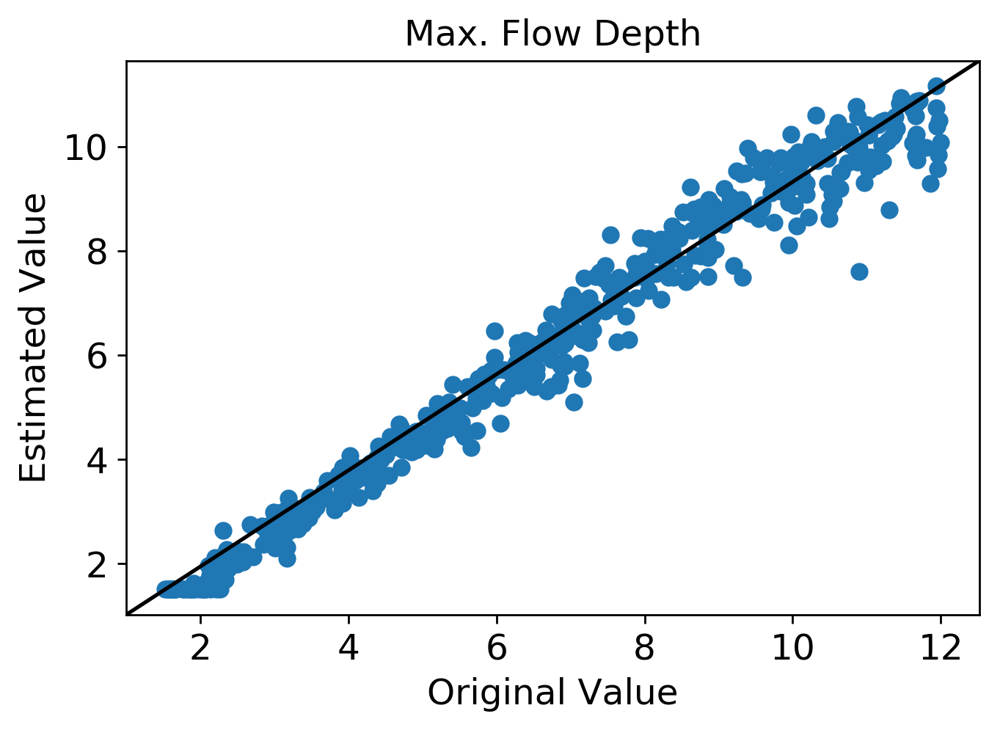

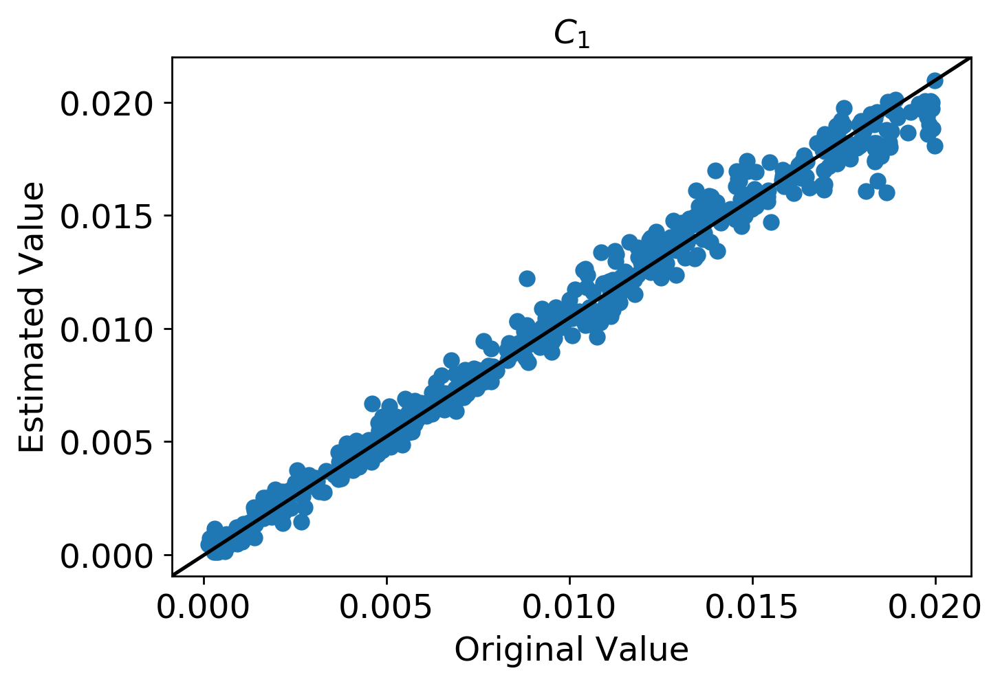

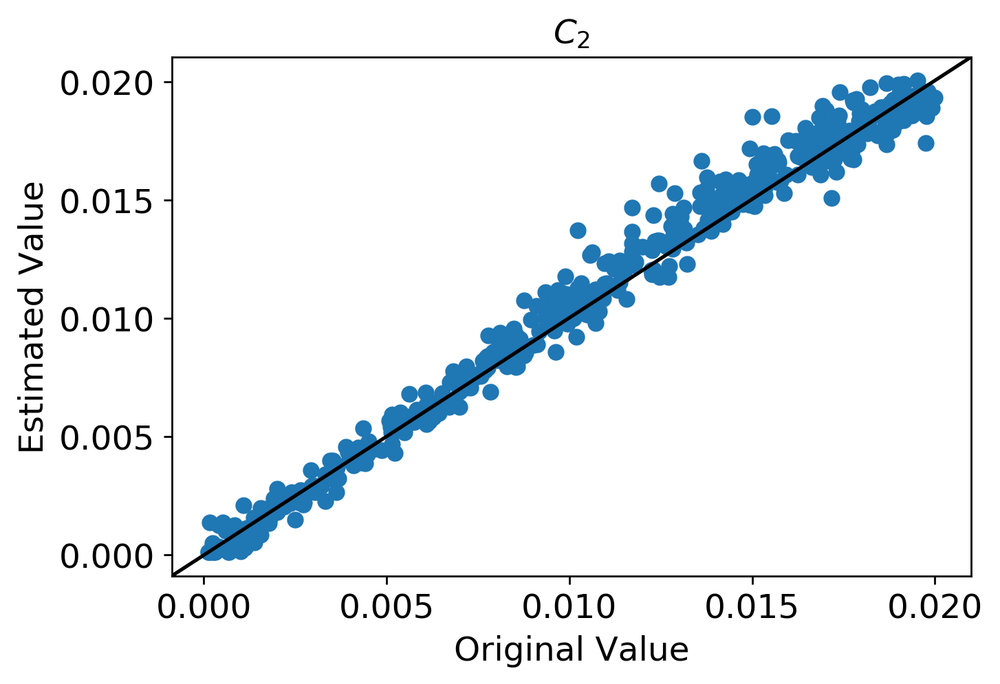

...

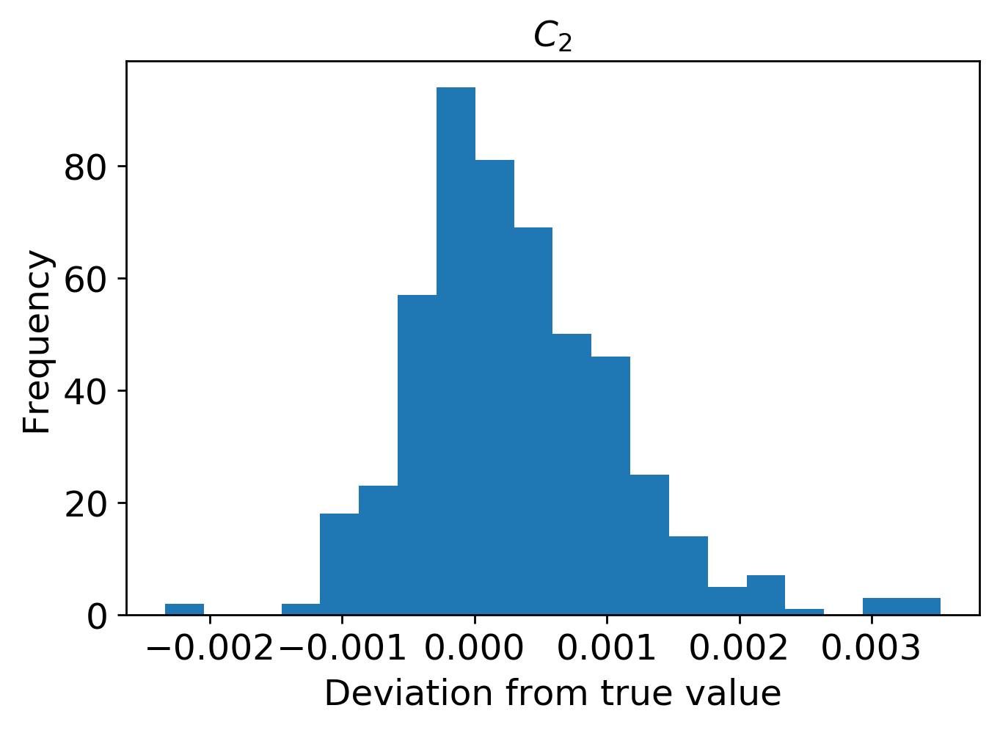

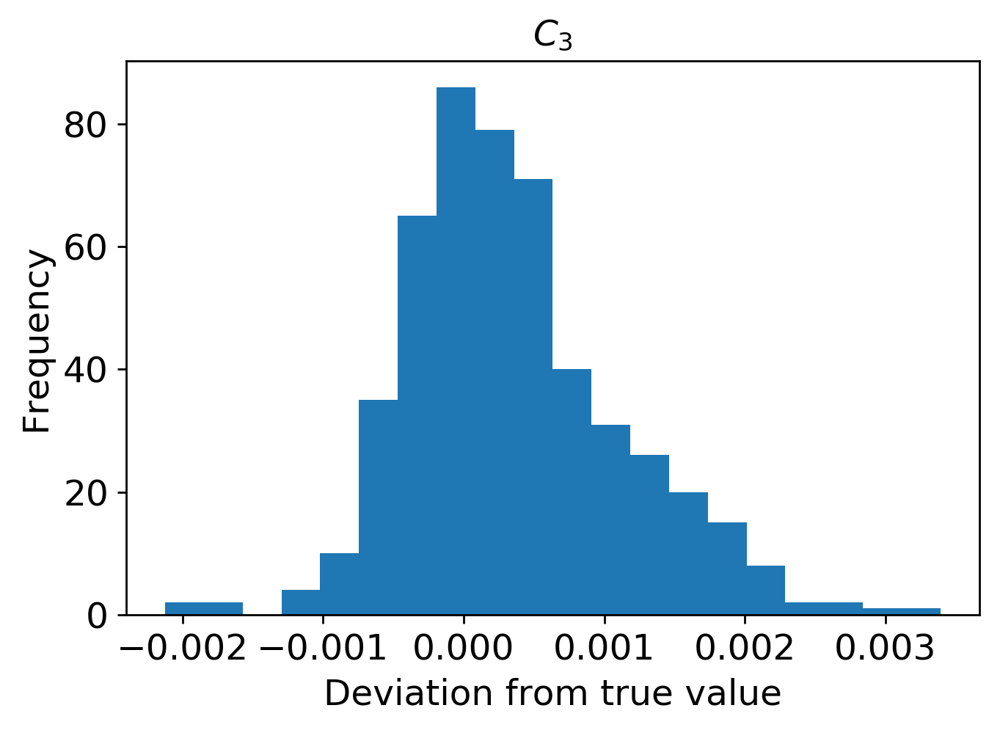

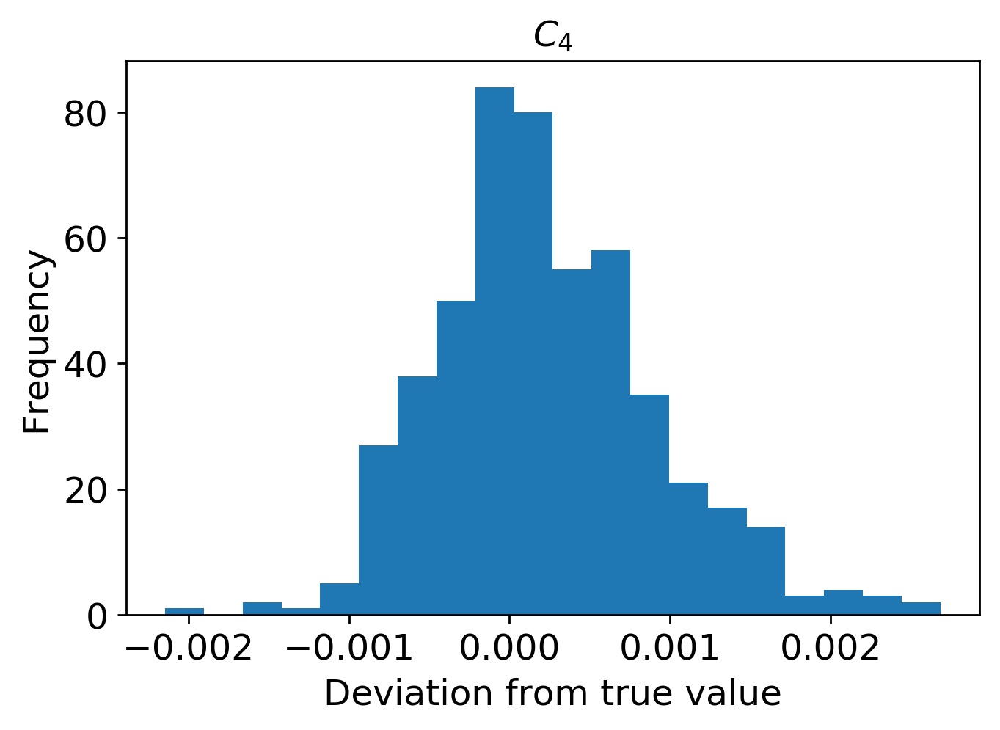

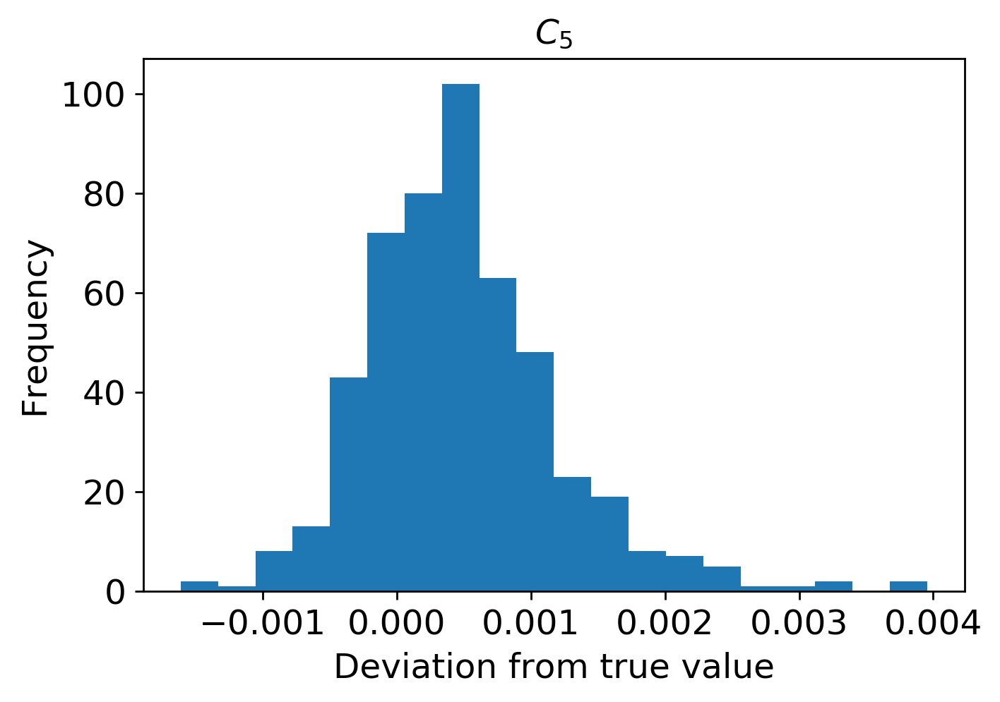

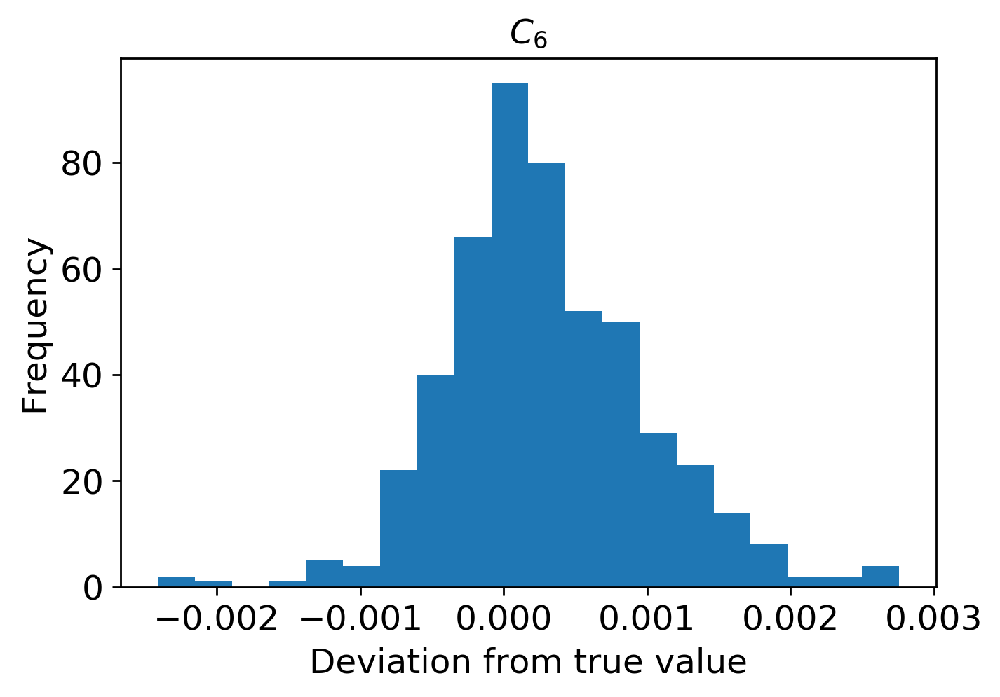

In [8]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1300/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

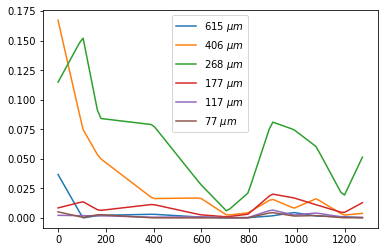

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1300/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='linear',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi1300.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



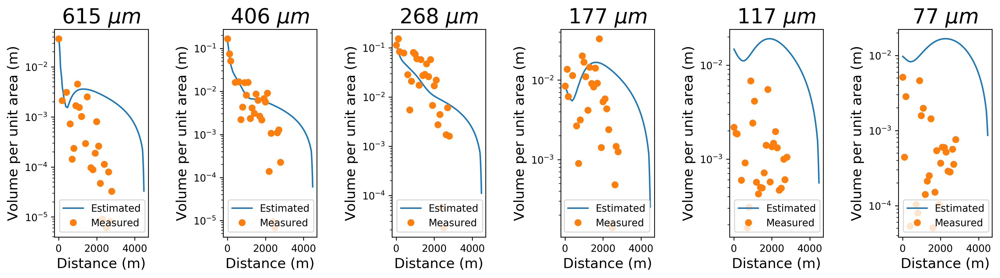

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi1300.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1300.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1300.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1300.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1300.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1300.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1300.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1300.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


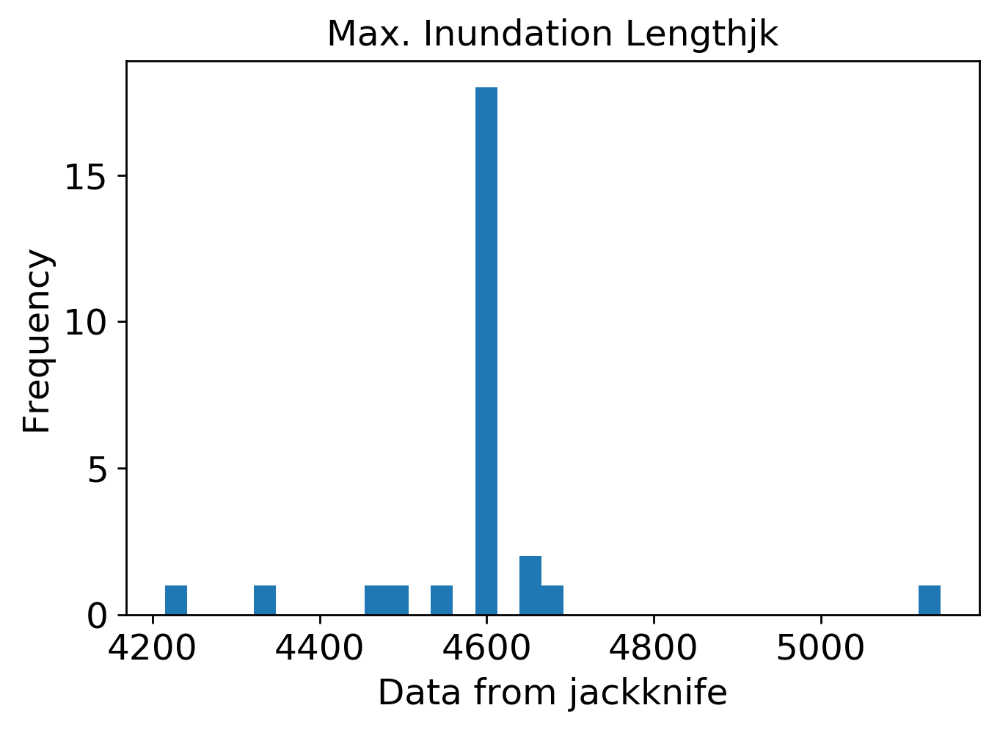

mean: 4.7824968760026705
jk_e: 0.07290276384303265


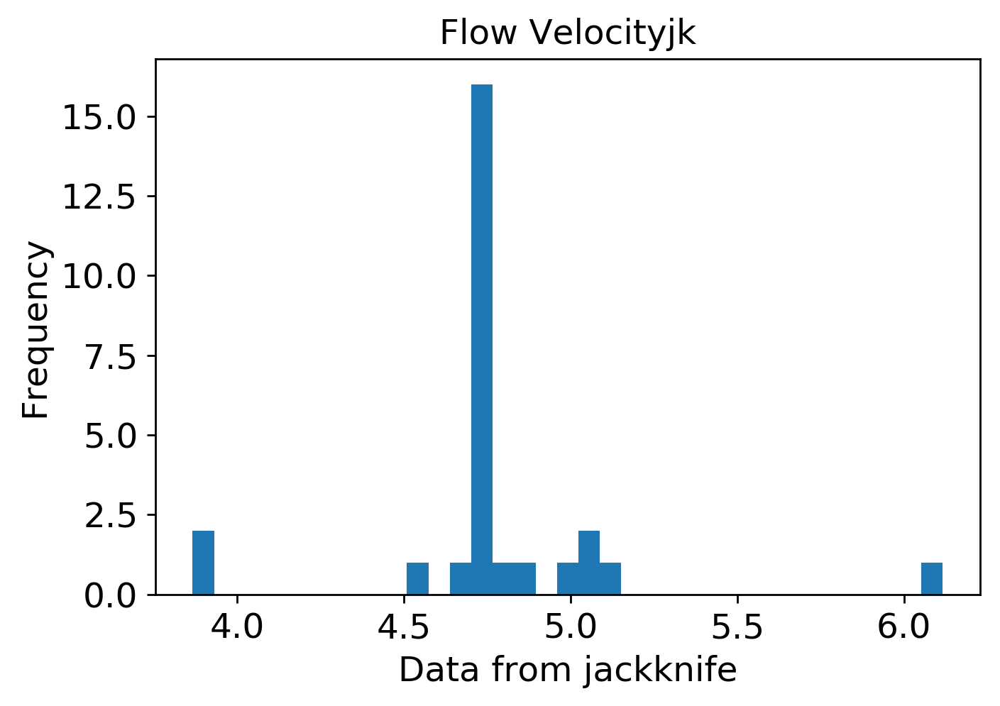

mean: 4.13895491946849
jk_e: 0.0848174086502508


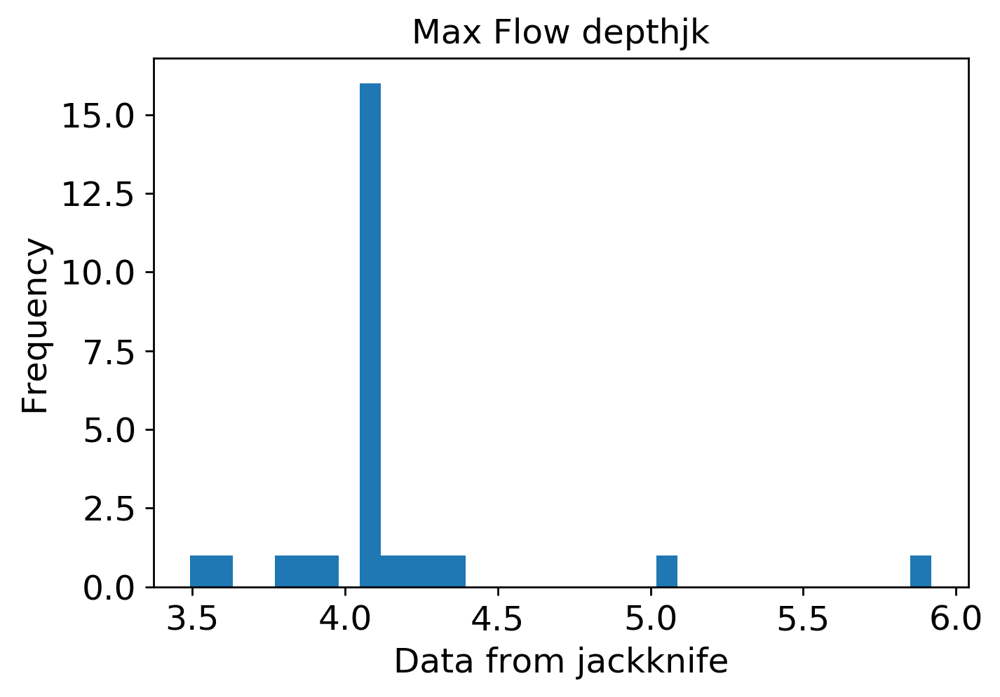

mean: 0.005342736767388249
jk_e: 0.00021079621987453044


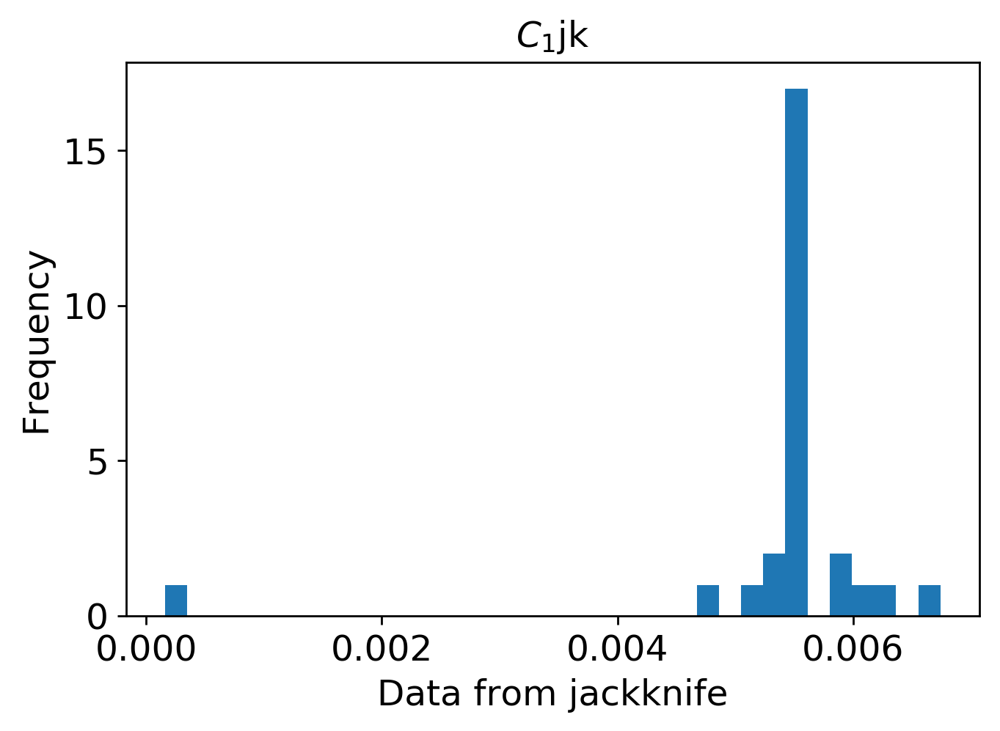

mean: 0.021422002085060933
jk_e: 0.0002905799171820297


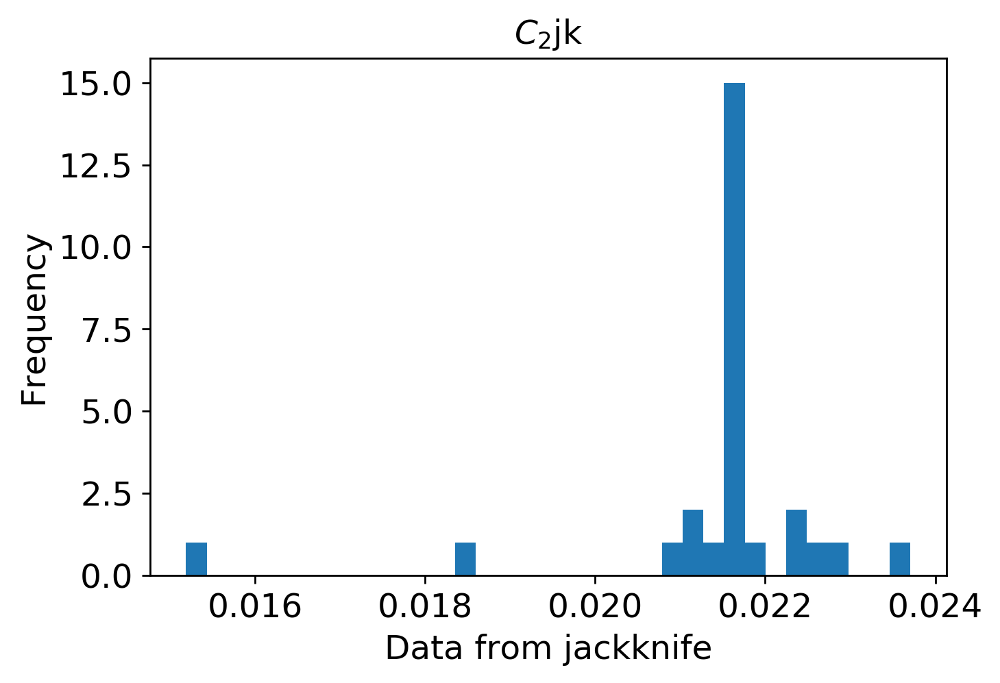

mean: 0.019749286652442754
jk_e: 0.00029970047080120024


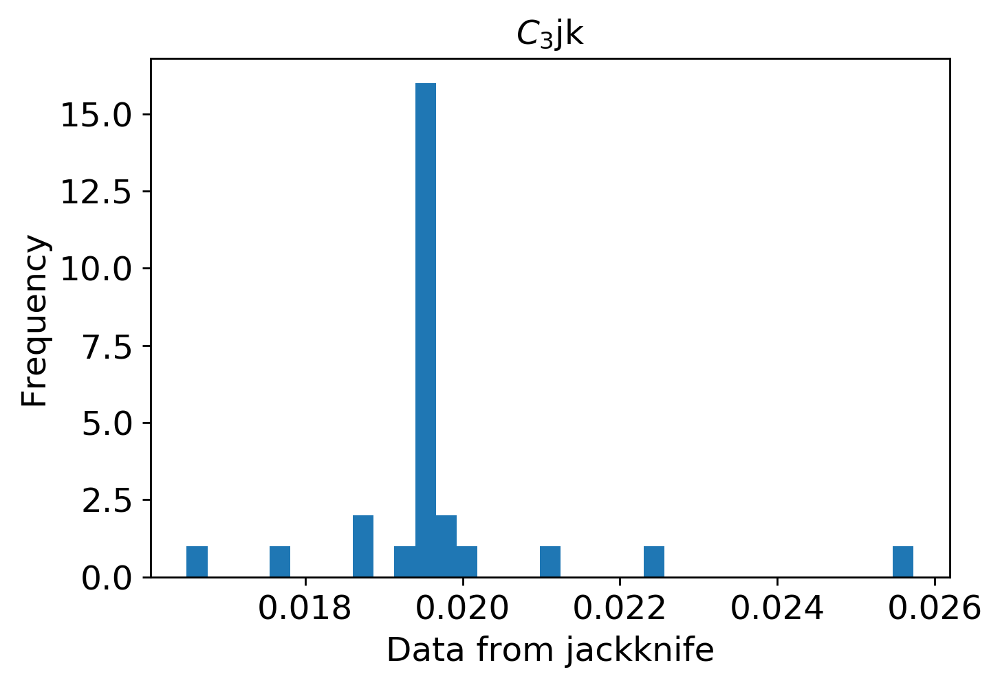

mean: 0.001363676520267726
jk_e: 5.484567599519566e-05


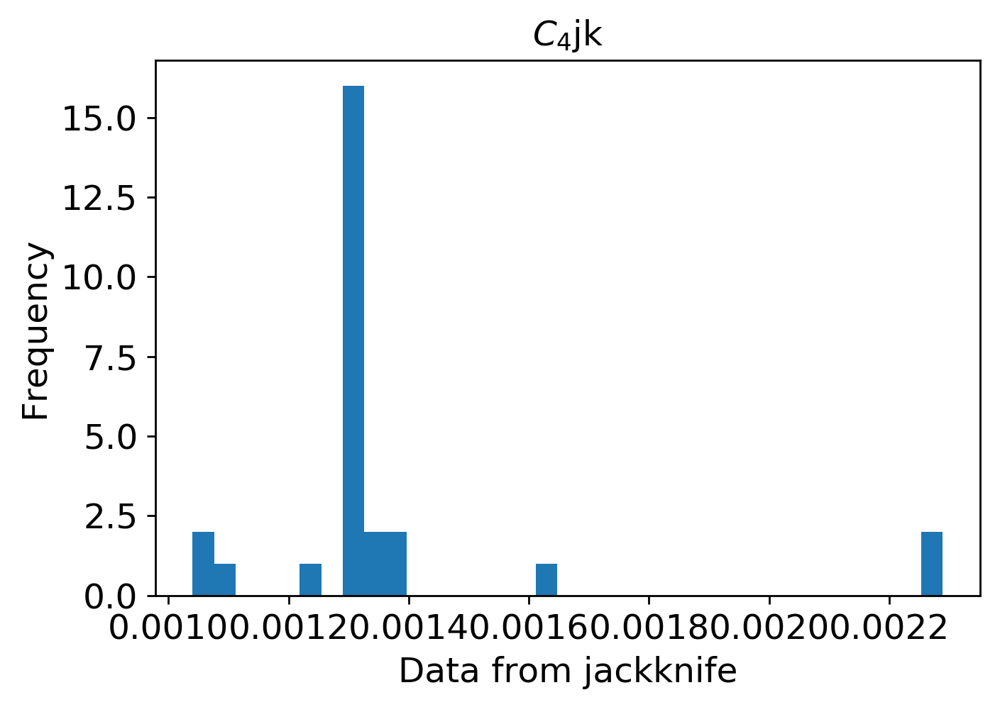

mean: 0.0021974077079591693
jk_e: 7.653510084563703e-05


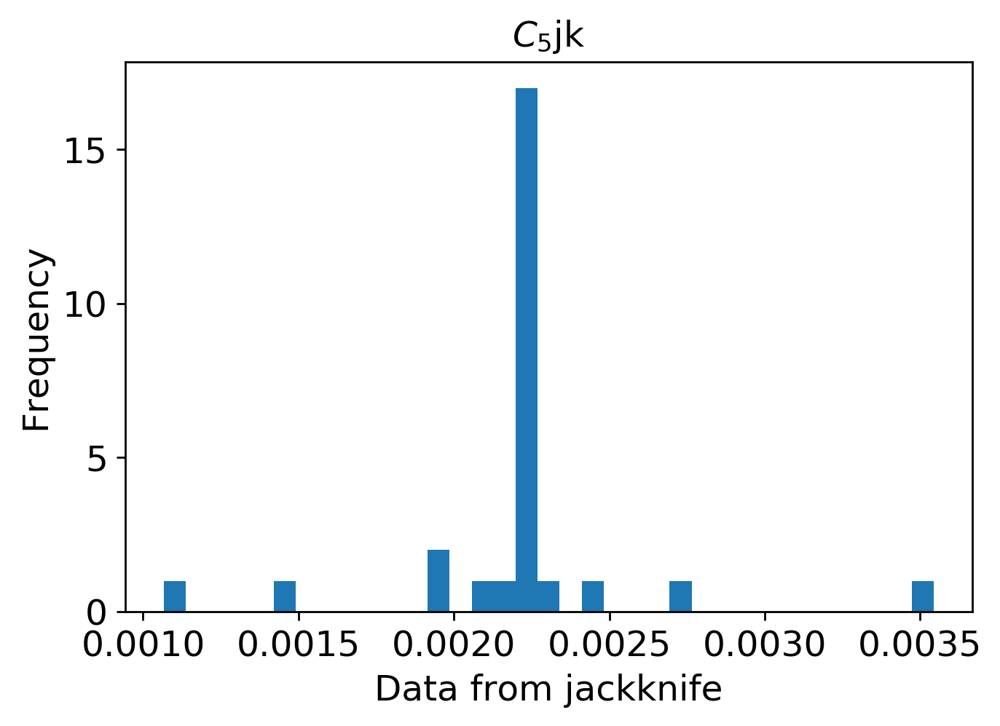

mean: 0.001474073125225886
jk_e: 5.501893313305421e-05


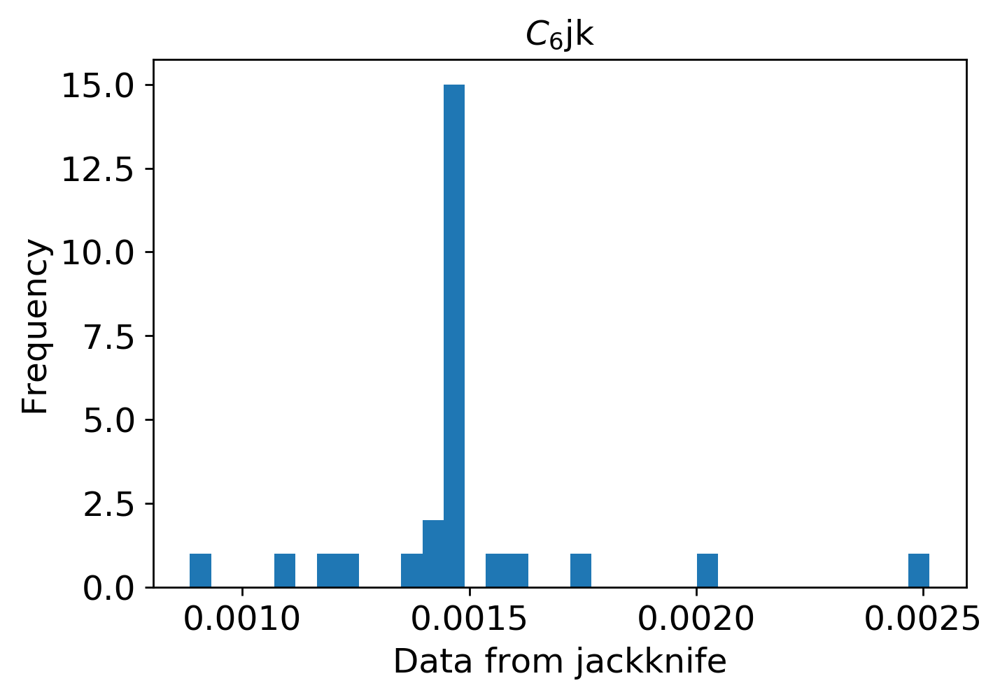

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1300/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi1300.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi1300.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi1300.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 1400

In [11]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi1400"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=1400)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 501us/step - loss: 0.0956 - mean_squared_error: 0.0956 - val_loss: 0.0710 - val_mean_squared_error: 0.0710
Epoch 2/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0651 - mean_squared_error: 0.0651 - val_loss: 0.0571 - val_mean_squared_error: 0.0571
Epoch 3/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0559 - mean_squared_error: 0.0559 - val_loss: 0.0493 - val_mean_squared_error: 0.0493
Epoch 4/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0498 - mean_squared_error: 0.0498 - val_loss: 0.0437 - val_mean_squared_error: 0.0437
Epoch 5/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0449 - mean_squared_error: 0.0449 - val_loss: 0.0390 - val_mean_squared_error: 0.0390
Epoch 6/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0408 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 340us/step - loss: 0.0126 - mean_squared_error: 0.0126 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 98/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0125 - mean_squared_error: 0.0125 - val_loss: 0.0103 - val_mean_squared_error: 0.0103
Epoch 99/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0125 - mean_squared_error: 0.0125 - val_loss: 0.0107 - val_mean_squared_error: 0.0107
Epoch 100/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0126 - mean_squared_error: 0.0126 - val_loss: 0.0096 - val_mean_squared_error: 0.0096
Epoch 101/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0124 - mean_squared_error: 0.0124 - val_loss: 0.0100 - val_mean_squared_error: 0.0100
Epoch 102/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0123 - mean_squared_error: 0.0123 - val_loss: 0.0100 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 335us/step - loss: 0.0096 - mean_squared_error: 0.0096 - val_loss: 0.0072 - val_mean_squared_error: 0.0072
Epoch 194/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0096 - mean_squared_error: 0.0096 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 195/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0097 - mean_squared_error: 0.0097 - val_loss: 0.0064 - val_mean_squared_error: 0.0064
Epoch 196/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0096 - mean_squared_error: 0.0096 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 197/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 198/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0094 - mean_squared_error: 0.0094 - val_loss: 0.0070 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 343us/step - loss: 0.0083 - mean_squared_error: 0.0083 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 290/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 291/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 292/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 293/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 294/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0082 - mean_squared_error: 0.0082 - val_loss: 0.0049 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 340us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 386/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 387/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 388/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 389/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0073 - mean_squared_error: 0.0073 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 390/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0074 - mean_squared_error: 0.0074 - val_loss: 0.0047 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 339us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 482/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 483/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 484/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 485/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 486/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0040 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 578/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 579/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 580/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 581/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 582/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0038 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 339us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 674/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 675/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 676/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 677/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 678/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0039 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 349us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 770/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 771/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 772/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 773/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 774/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 345us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 866/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 867/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 868/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 869/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 870/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 962/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 963/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 964/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 965/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 966/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0035 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 346us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1058/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1059/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1060/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1061/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 1062/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1106/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1107/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1108/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1109/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1110/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 352us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1154/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1155/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1156/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1157/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1158/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1202/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1203/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1204/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1205/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1206/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_erro

3600/3600 [==============================] - 1s 336us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1250/2000
3600/3600 [==============================] - 1s 332us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1251/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1252/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 1253/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1254/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_erro

3600/3600 [==============================] - 1s 339us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1298/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1299/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1300/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1301/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1302/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0034 - val_mean_squared_erro

3600/3600 [==============================] - 1s 339us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1346/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1347/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1348/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1349/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1350/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0031 - val_mean_squared_erro

3600/3600 [==============================] - 1s 340us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1394/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1395/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1396/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1397/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1398/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0038 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1442/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1443/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1444/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1445/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1446/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 345us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1490/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1491/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1492/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1493/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1494/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1538/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1539/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1540/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1541/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1542/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_erro

3600/3600 [==============================] - 1s 347us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1586/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1587/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1588/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1589/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1590/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1634/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1635/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1636/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1637/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1638/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1682/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1683/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1684/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1685/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1686/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1730/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1731/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1732/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1733/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1734/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_erro

3600/3600 [==============================] - 1s 337us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1778/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1779/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1780/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1781/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1782/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 332us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1826/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1827/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1828/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1829/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1830/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 342us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1874/2000
3600/3600 [==============================] - 1s 334us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1875/2000
3600/3600 [==============================] - 1s 333us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1876/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1877/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1878/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1922/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1923/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1924/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1925/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1926/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_erro

3600/3600 [==============================] - 1s 335us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1970/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1971/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1972/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1973/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1974/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0025 - val_mean_squared_erro

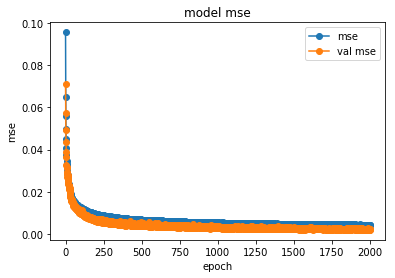

save the model


In [12]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1400/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1400/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


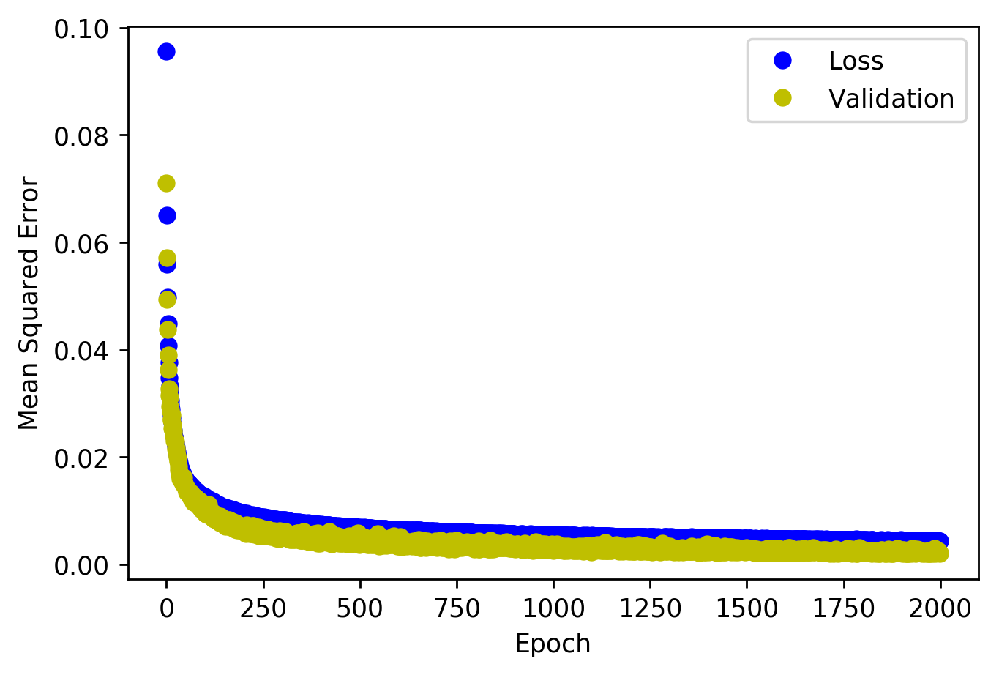

<Figure size 432x288 with 0 Axes>

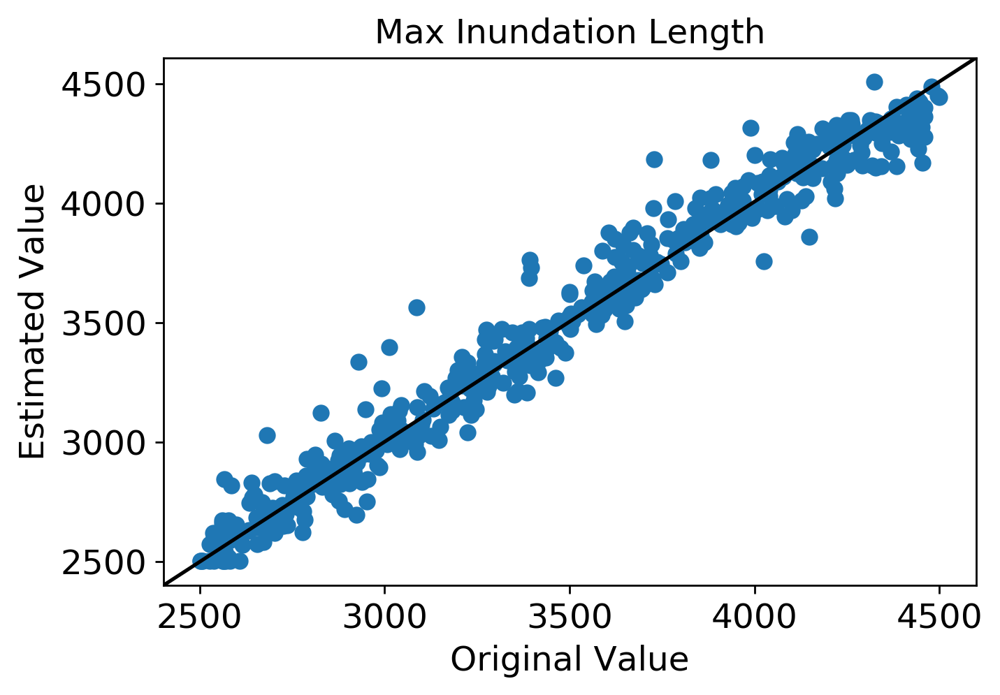

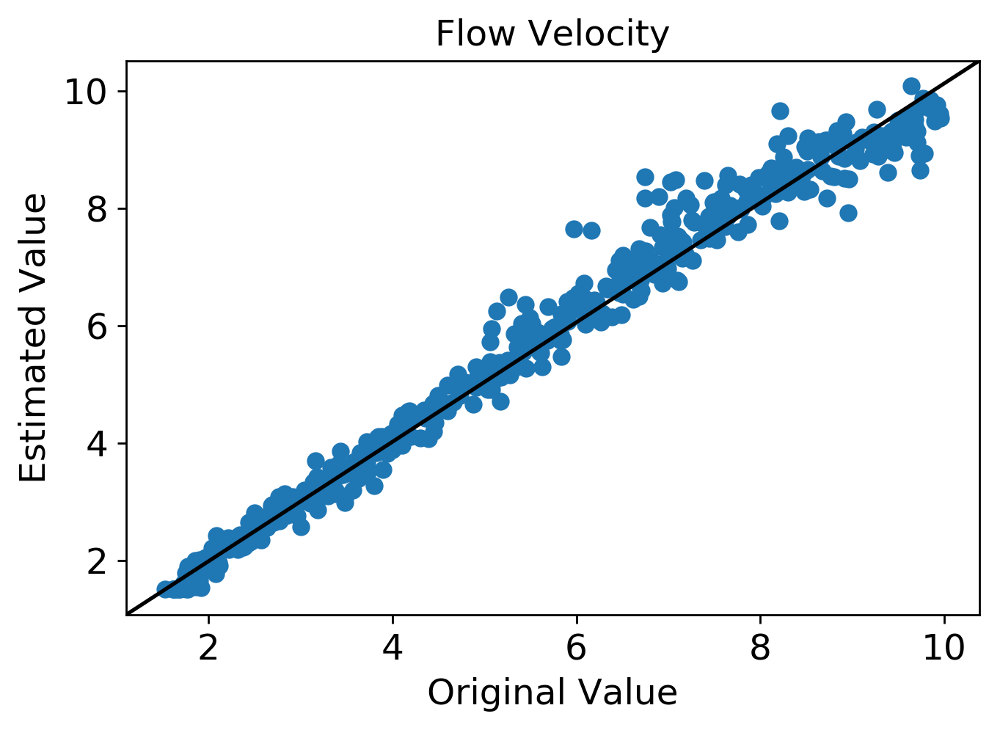

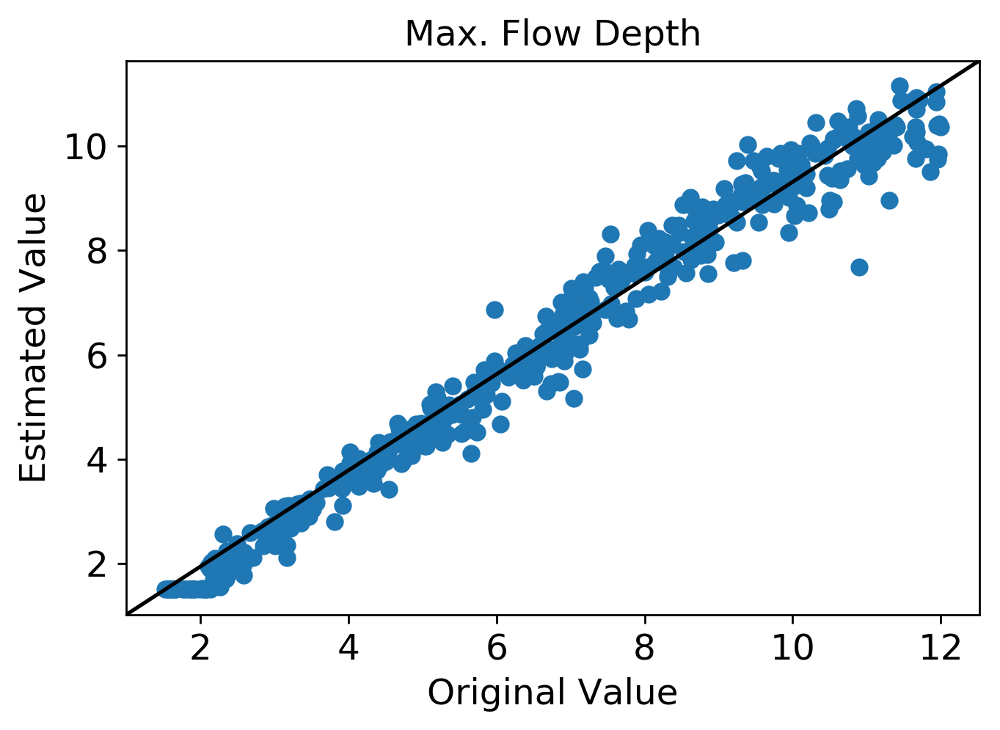

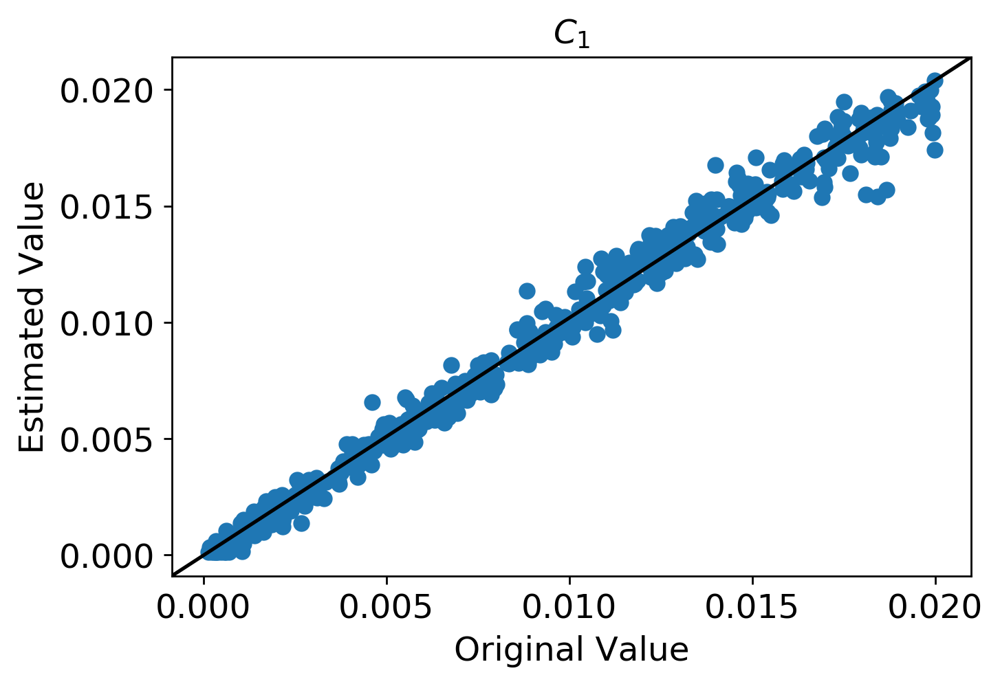

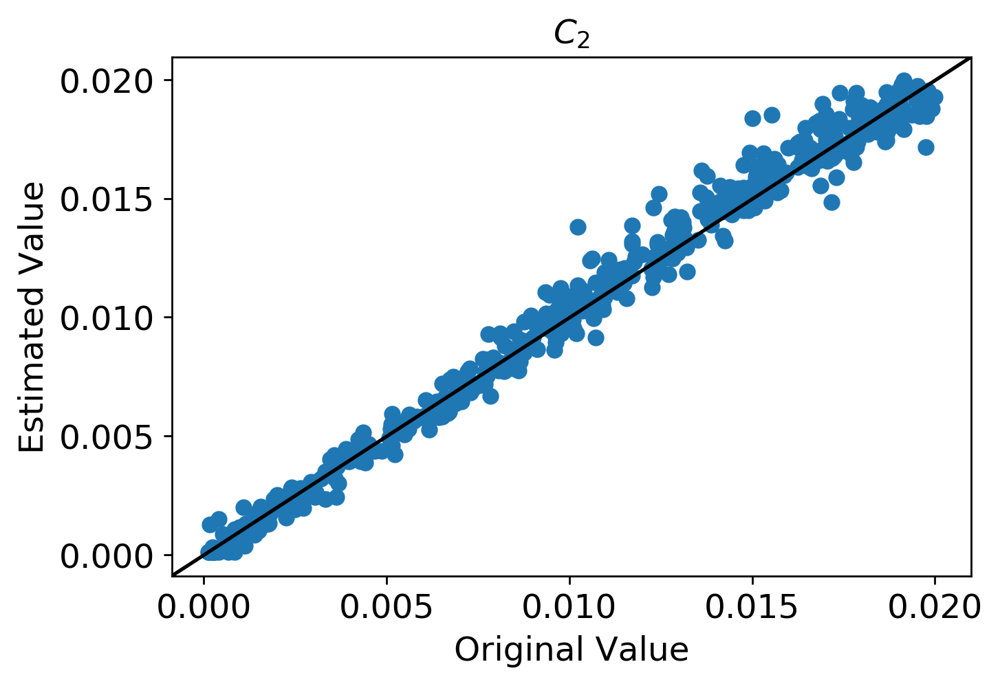

...

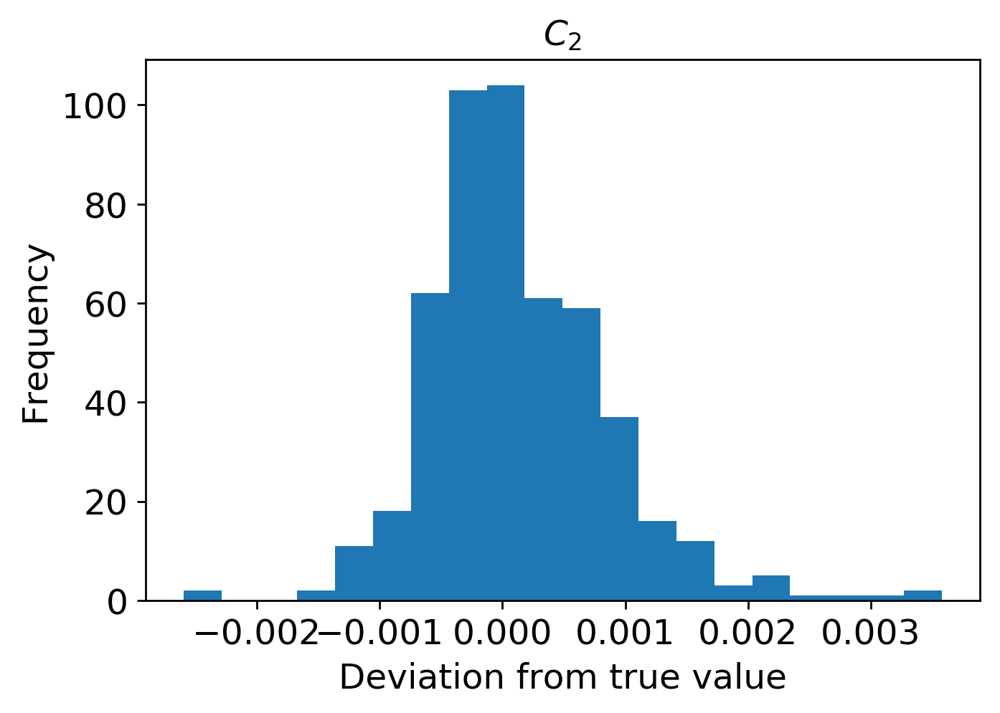

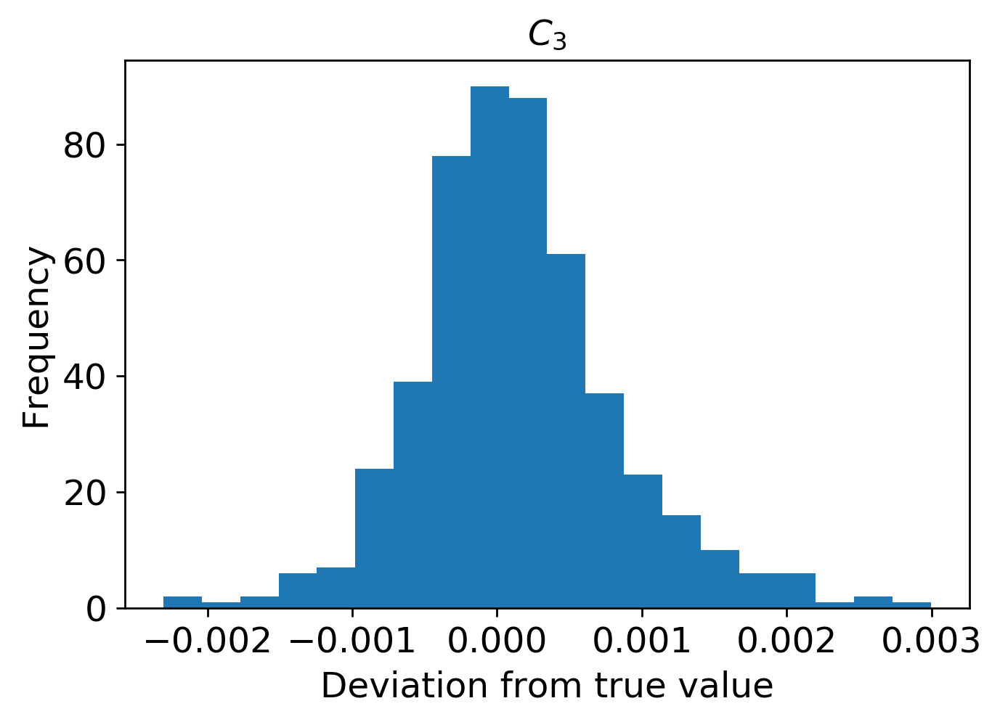

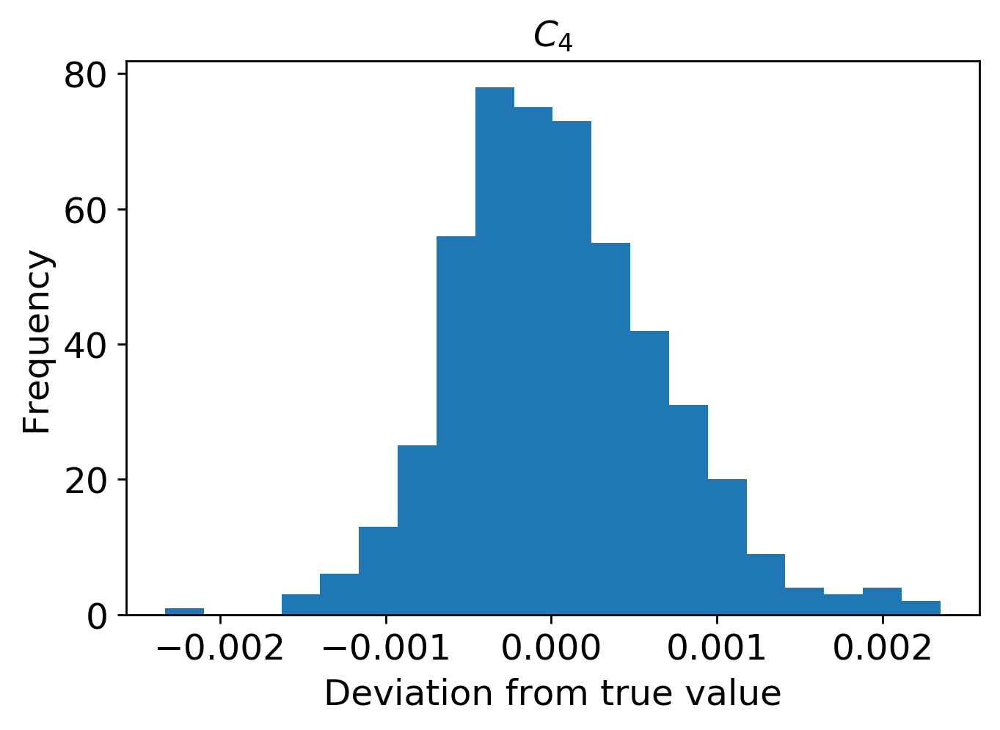

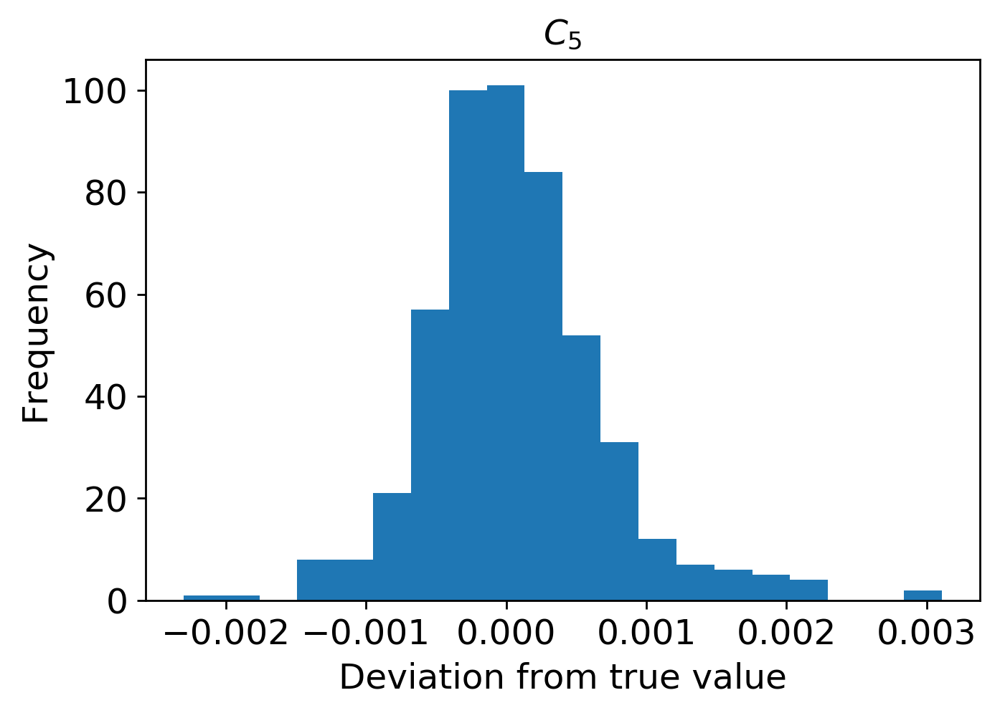

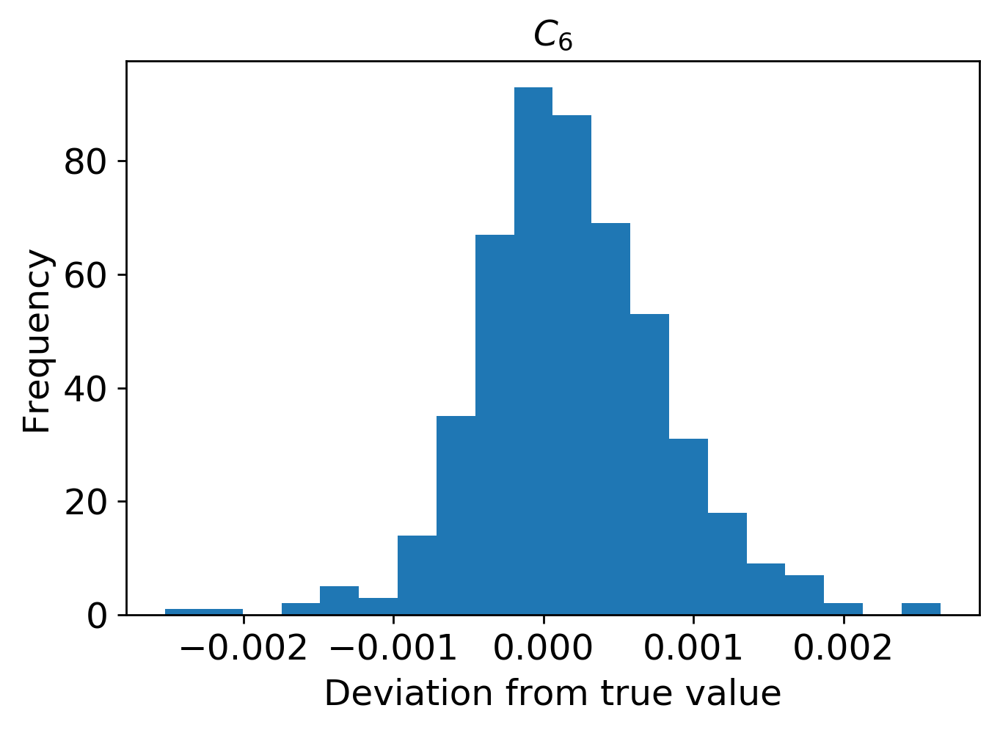

In [13]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1400/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

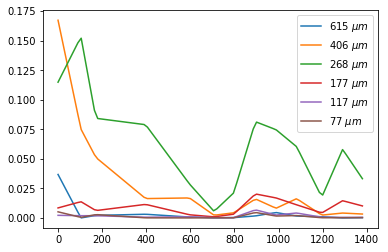

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1400/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='linear',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi1400.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



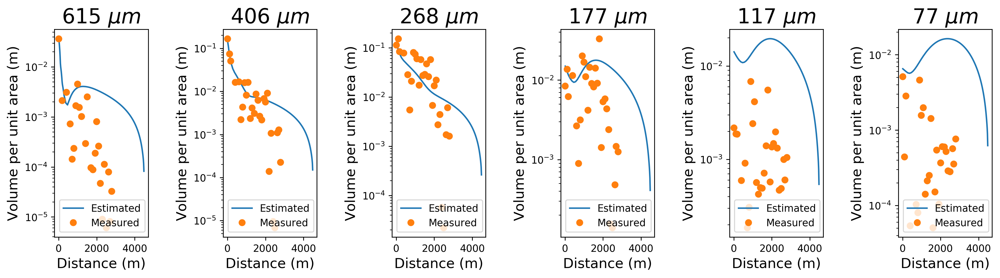

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi1400.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1400.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1400.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1400.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1400.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1400.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1400.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1400.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


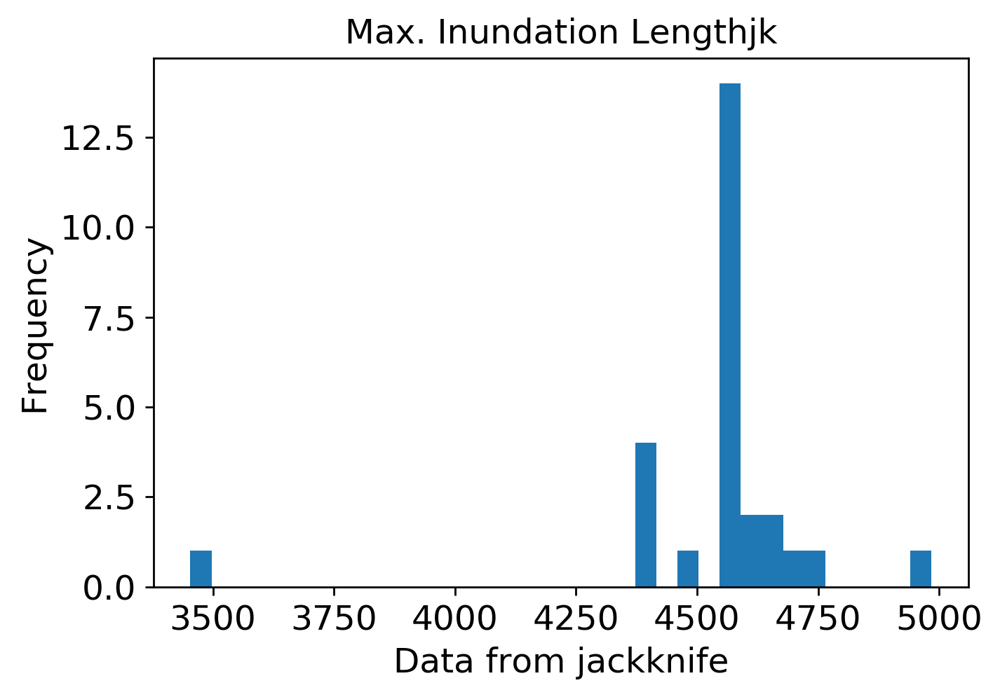

mean: 5.045729957559923
jk_e: 0.06758877699497882


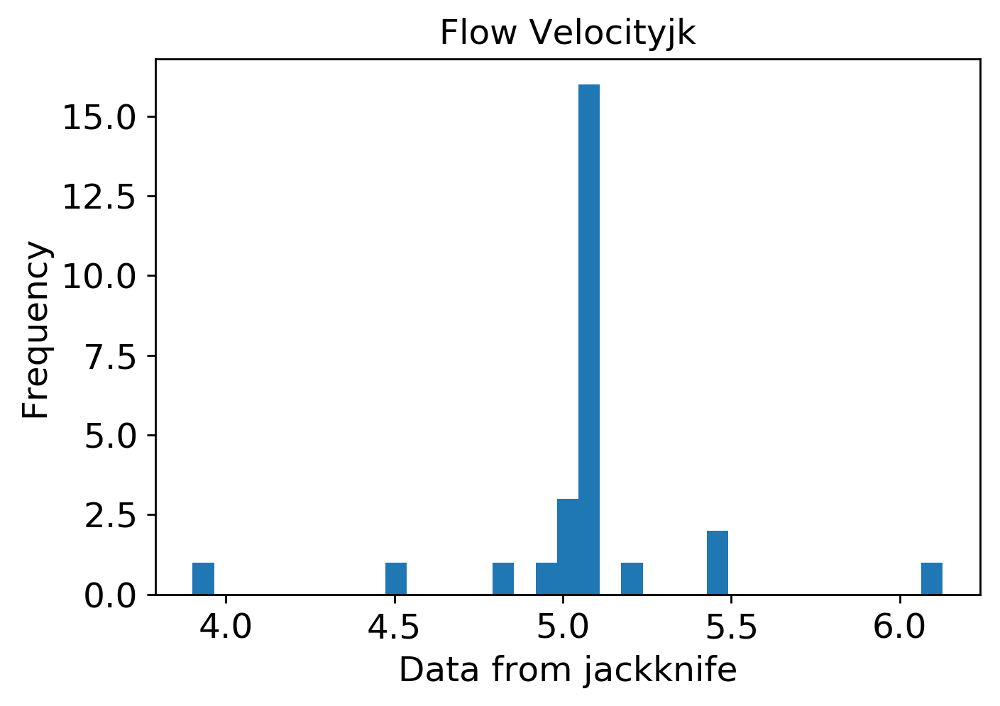

mean: 4.299294663059578
jk_e: 0.08341358984695599


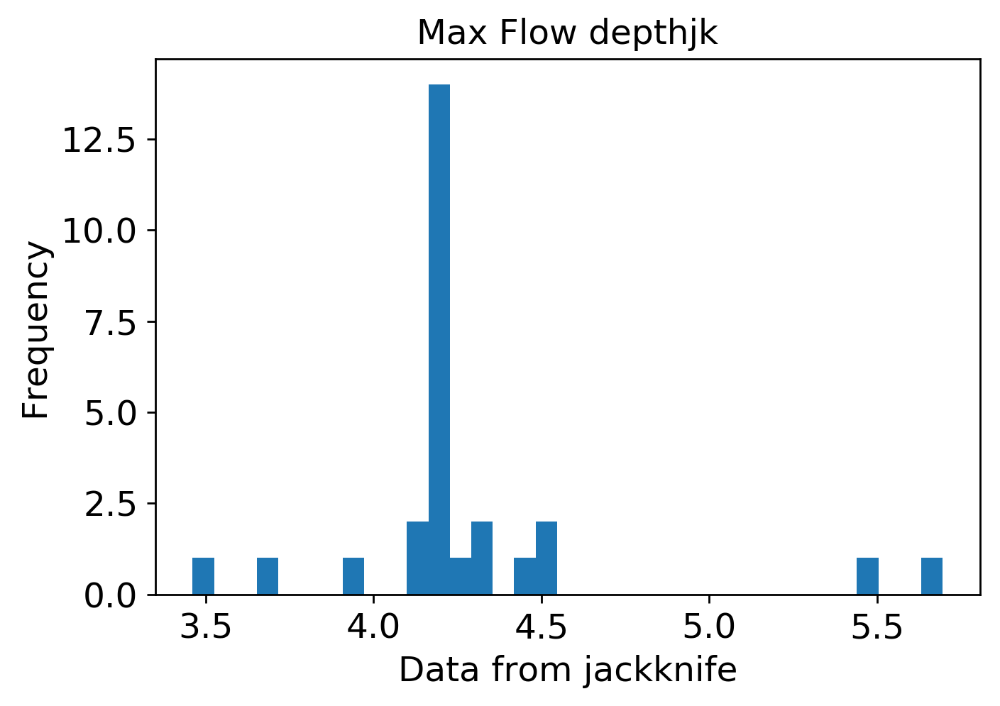

mean: 0.005090021412974787
jk_e: 0.00019425880688425347


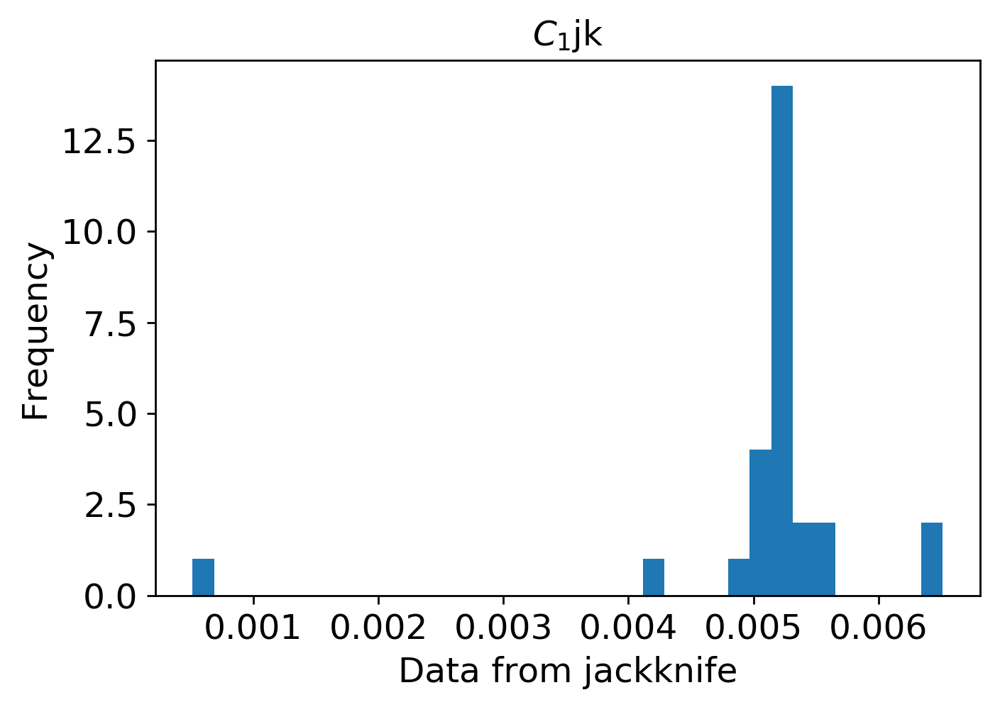

mean: 0.021051201875679118
jk_e: 0.00029994826074201286


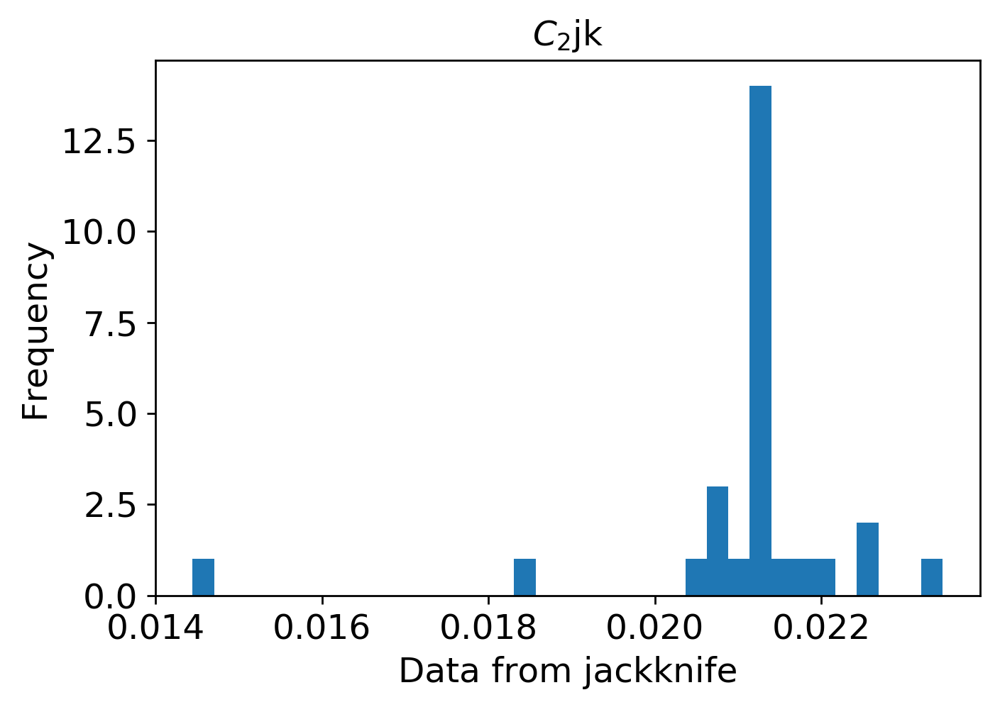

mean: 0.019258024725649154
jk_e: 0.00026837979348515086


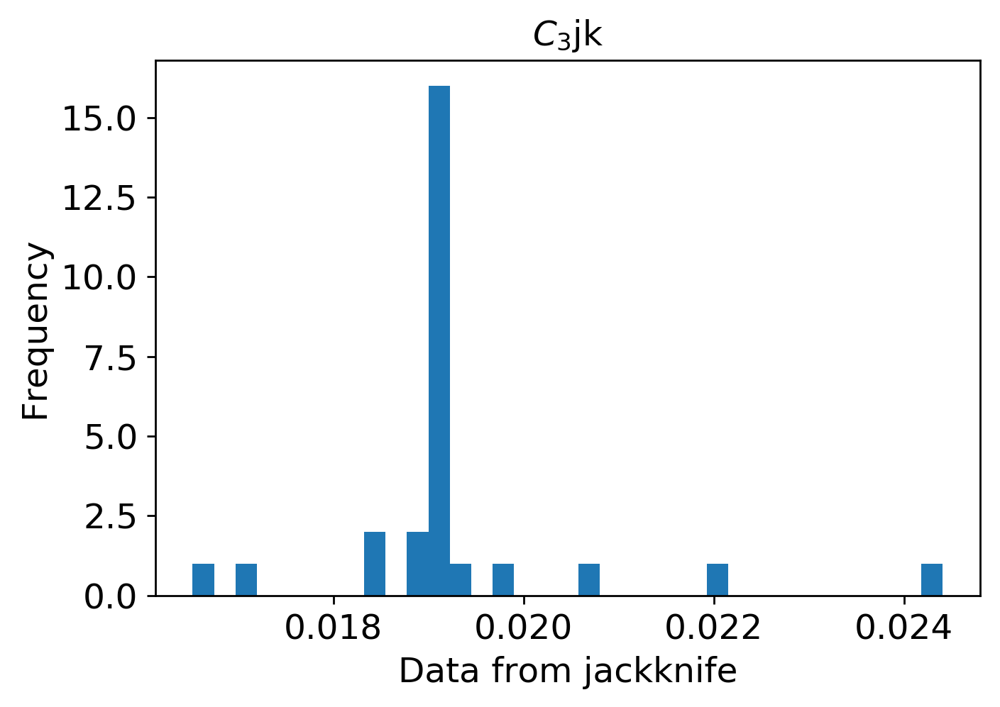

mean: 0.0021796158776254096
jk_e: 4.844192287157715e-05


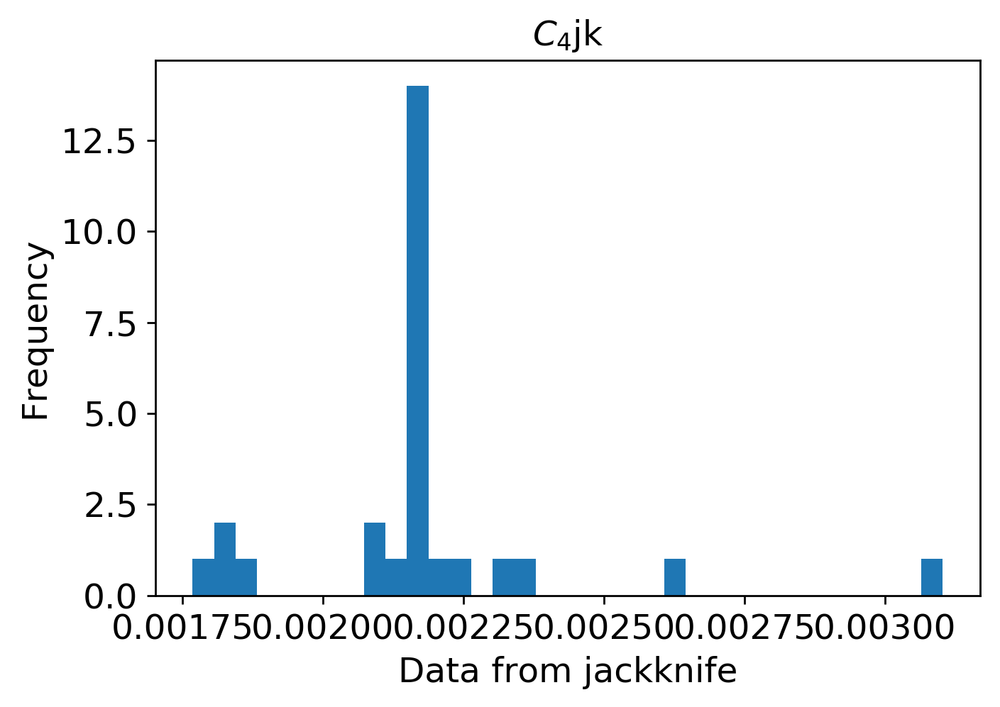

mean: 0.002030934341951735
jk_e: 7.0504621219348e-05


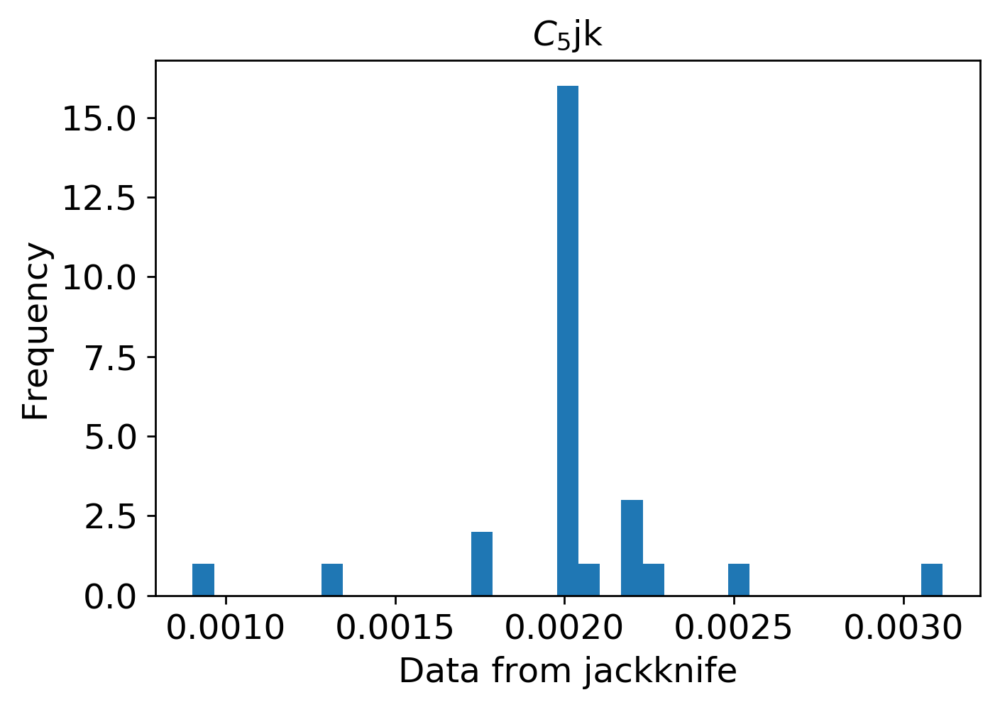

mean: 0.0009425001218834122
jk_e: 5.8379822639864125e-05


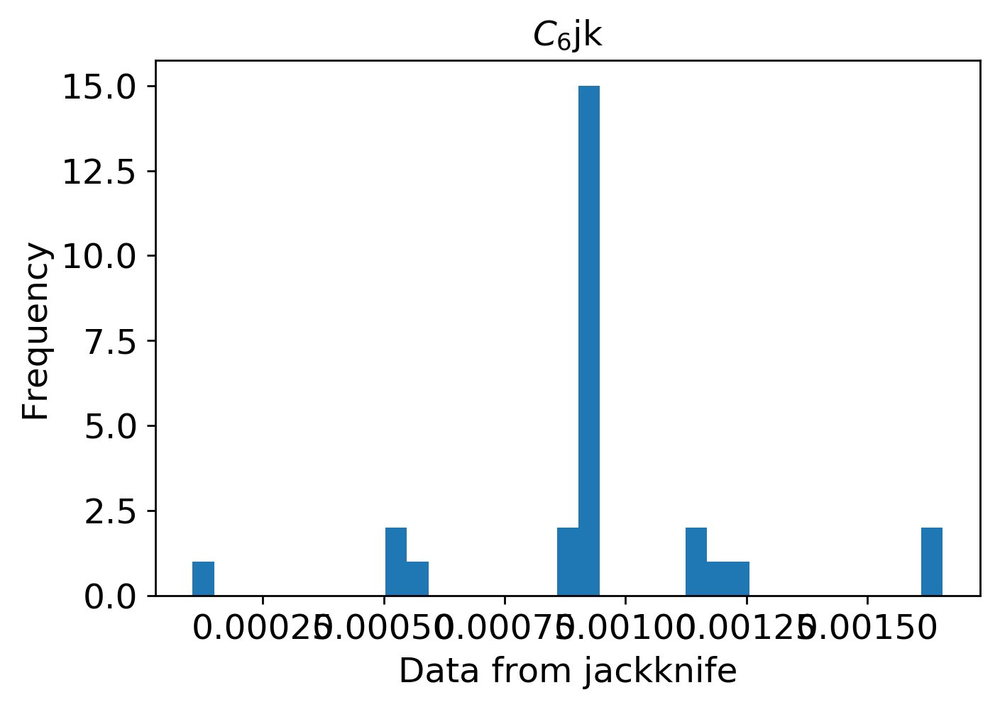

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1400/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi1400.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi1400.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi1400.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 1600

In [16]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi1600"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=1600)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 515us/step - loss: 0.0989 - mean_squared_error: 0.0989 - val_loss: 0.0698 - val_mean_squared_error: 0.0698
Epoch 2/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0648 - mean_squared_error: 0.0648 - val_loss: 0.0567 - val_mean_squared_error: 0.0567
Epoch 3/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0553 - mean_squared_error: 0.0553 - val_loss: 0.0488 - val_mean_squared_error: 0.0488
Epoch 4/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0496 - mean_squared_error: 0.0496 - val_loss: 0.0439 - val_mean_squared_error: 0.0439
Epoch 5/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0446 - mean_squared_error: 0.0446 - val_loss: 0.0384 - val_mean_squared_error: 0.0384
Epoch 6/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0401 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 343us/step - loss: 0.0123 - mean_squared_error: 0.0123 - val_loss: 0.0104 - val_mean_squared_error: 0.0104
Epoch 98/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0121 - mean_squared_error: 0.0121 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 99/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0122 - mean_squared_error: 0.0122 - val_loss: 0.0102 - val_mean_squared_error: 0.0102
Epoch 100/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0121 - mean_squared_error: 0.0121 - val_loss: 0.0105 - val_mean_squared_error: 0.0105
Epoch 101/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0121 - mean_squared_error: 0.0121 - val_loss: 0.0094 - val_mean_squared_error: 0.0094
Epoch 102/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0121 - mean_squared_error: 0.0121 - val_loss: 0.0097 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 350us/step - loss: 0.0094 - mean_squared_error: 0.0094 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 194/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 195/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0064 - val_mean_squared_error: 0.0064
Epoch 196/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 197/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 198/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0094 - mean_squared_error: 0.0094 - val_loss: 0.0059 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 354us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 290/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0081 - mean_squared_error: 0.0081 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 291/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 292/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 293/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0081 - mean_squared_error: 0.0081 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 294/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0054 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 345us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 386/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 387/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 388/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 389/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0050 - val_mean_squared_error: 0.0050
Epoch 390/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0072 - mean_squared_error: 0.0072 - val_loss: 0.0039 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 348us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0051 - val_mean_squared_error: 0.0051
Epoch 482/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 483/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 484/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 485/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 486/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0038 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 349us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 578/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 579/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0063 - mean_squared_error: 0.0063 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 580/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 581/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 582/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0036 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 344us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 674/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 675/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 676/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 677/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 678/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0037 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 351us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 770/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 771/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 772/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 773/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 774/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0035 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 344us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 866/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 867/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 868/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 869/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 870/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0033 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 367us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 962/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 963/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 964/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 965/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 966/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0031 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 341us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1058/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 1059/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1060/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1061/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1062/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0032 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1106/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1107/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1108/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1109/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1110/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 354us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1154/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 1155/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1156/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1157/2000
3600/3600 [==============================] - 1s 337us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1158/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1202/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1203/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1204/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1205/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1206/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 352us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1250/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1251/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1252/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1253/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1254/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1298/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1299/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1300/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1301/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1302/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0028 - val_mean_squared_erro

3600/3600 [==============================] - 1s 351us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1346/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1347/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1348/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1349/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1350/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1394/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1395/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1396/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1397/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1398/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_erro

3600/3600 [==============================] - 1s 351us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1442/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1443/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1444/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1445/2000
3600/3600 [==============================] - 1s 335us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1446/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 347us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1490/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1491/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1492/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1493/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1494/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1538/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1539/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1540/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1541/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1542/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_erro

3600/3600 [==============================] - 1s 353us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1586/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1587/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1588/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1589/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1590/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 339us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1634/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1635/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1636/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1637/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1638/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0022 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1682/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1683/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1684/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1685/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1686/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_erro

3600/3600 [==============================] - 1s 353us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1730/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1731/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1732/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1733/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1734/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1778/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1779/2000
3600/3600 [==============================] - 1s 336us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1780/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1781/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1782/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1826/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1827/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1828/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1829/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1830/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1874/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1875/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1876/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1877/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1878/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1922/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1923/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1924/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1925/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1926/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 342us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1970/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1971/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1972/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1973/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1974/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_erro

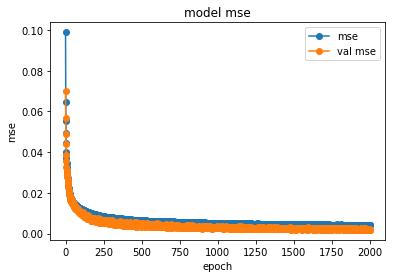

save the model


In [17]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1600/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1600/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


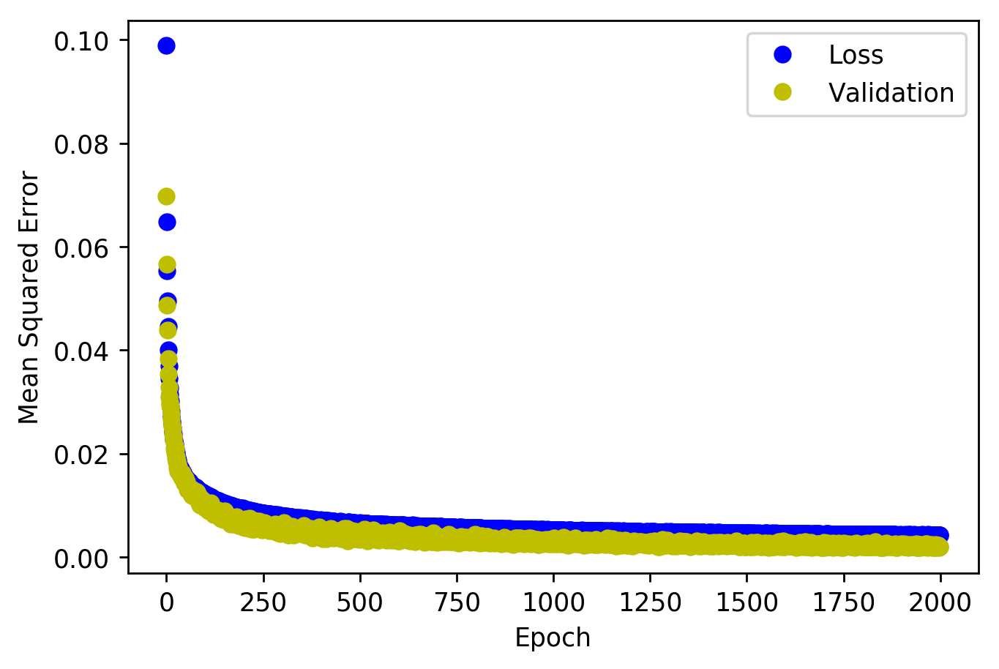

<Figure size 432x288 with 0 Axes>

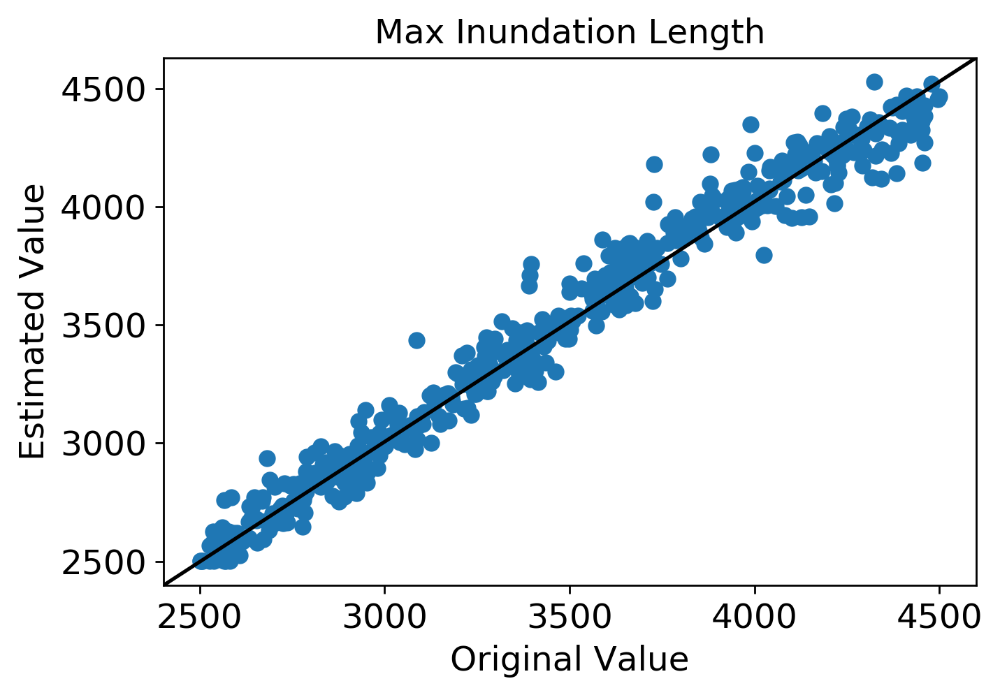

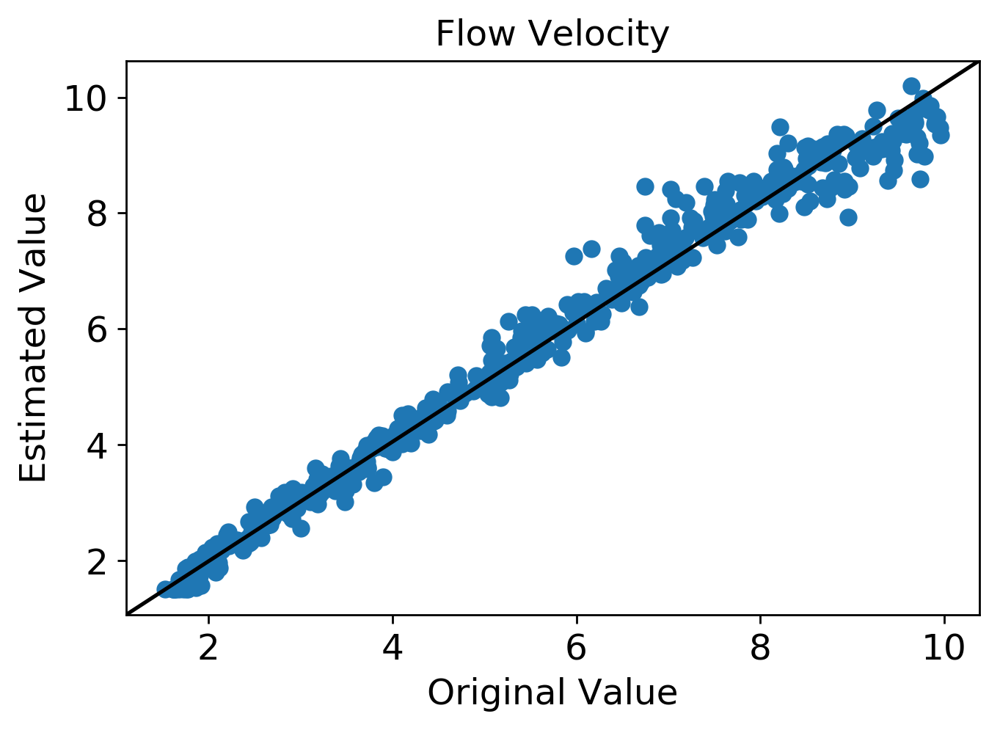

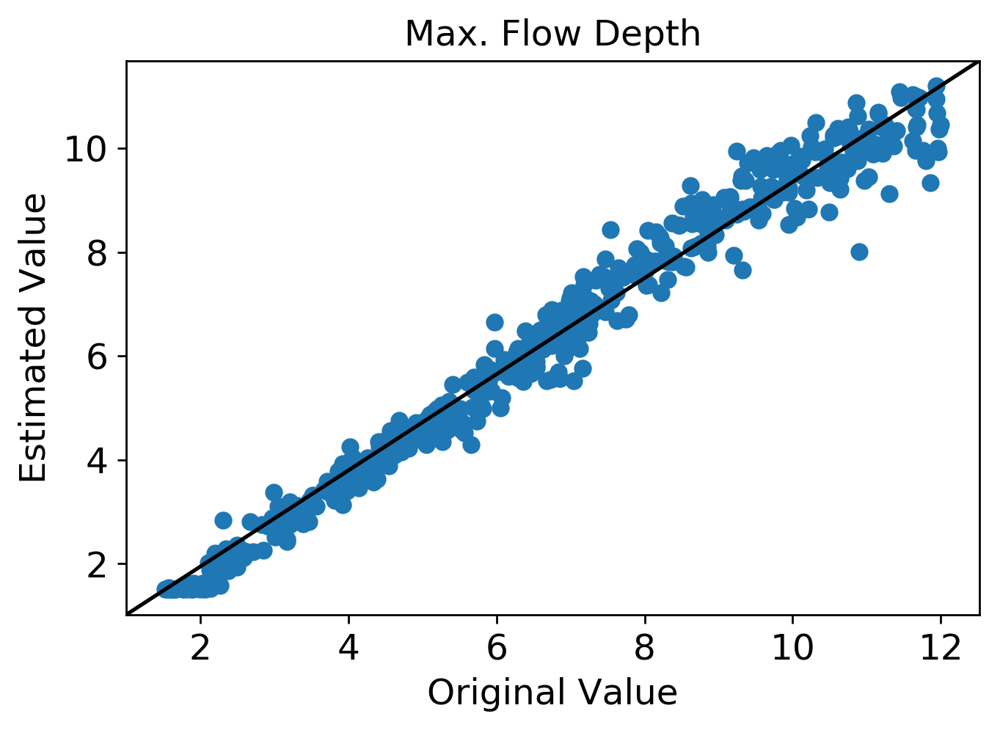

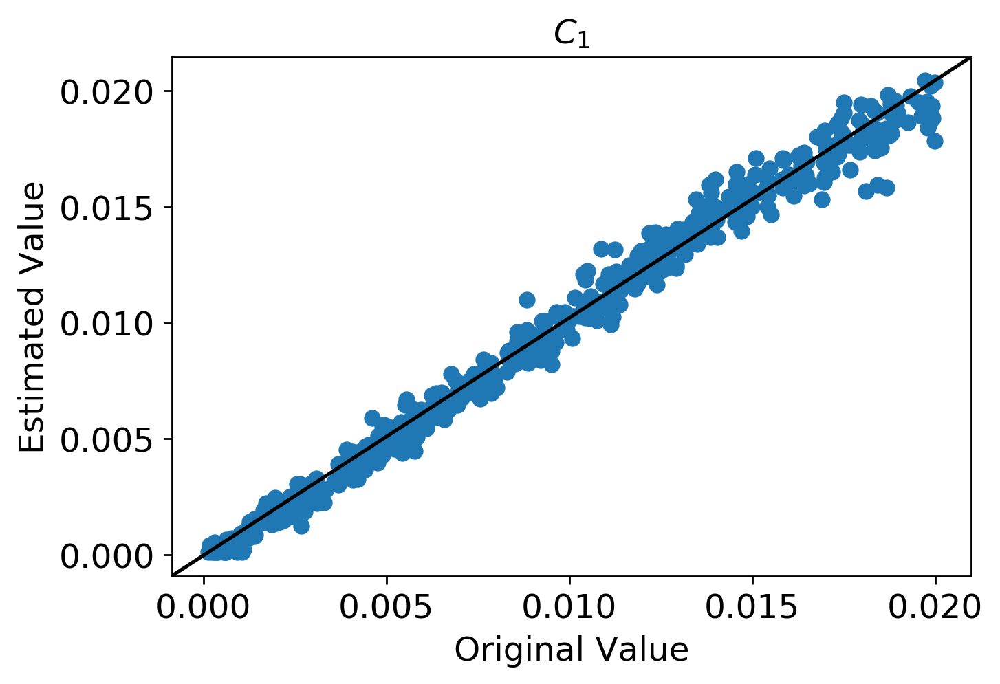

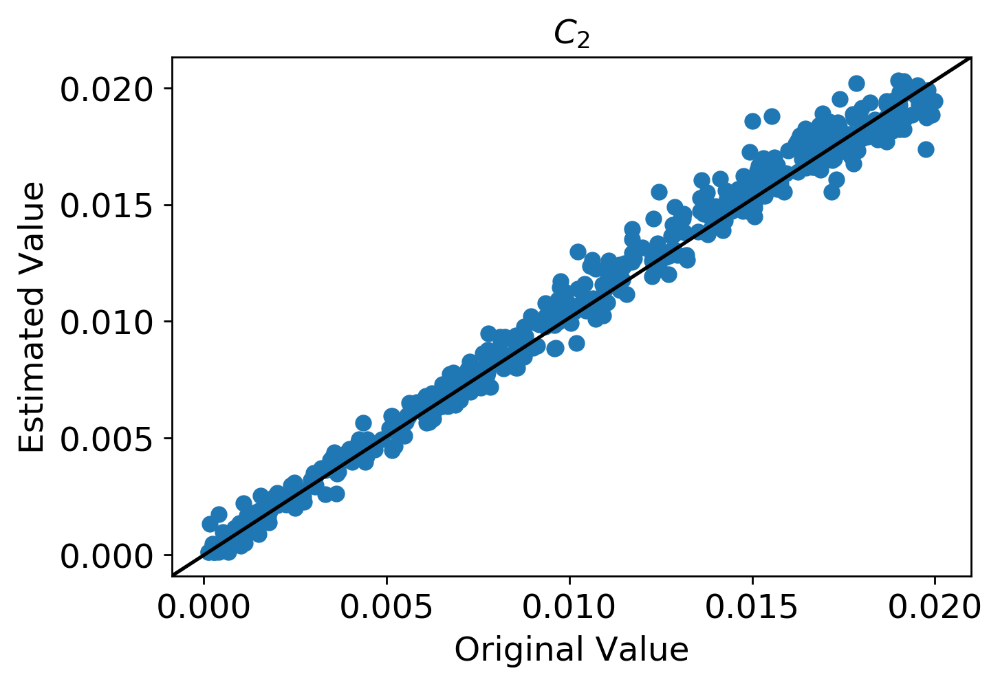

...

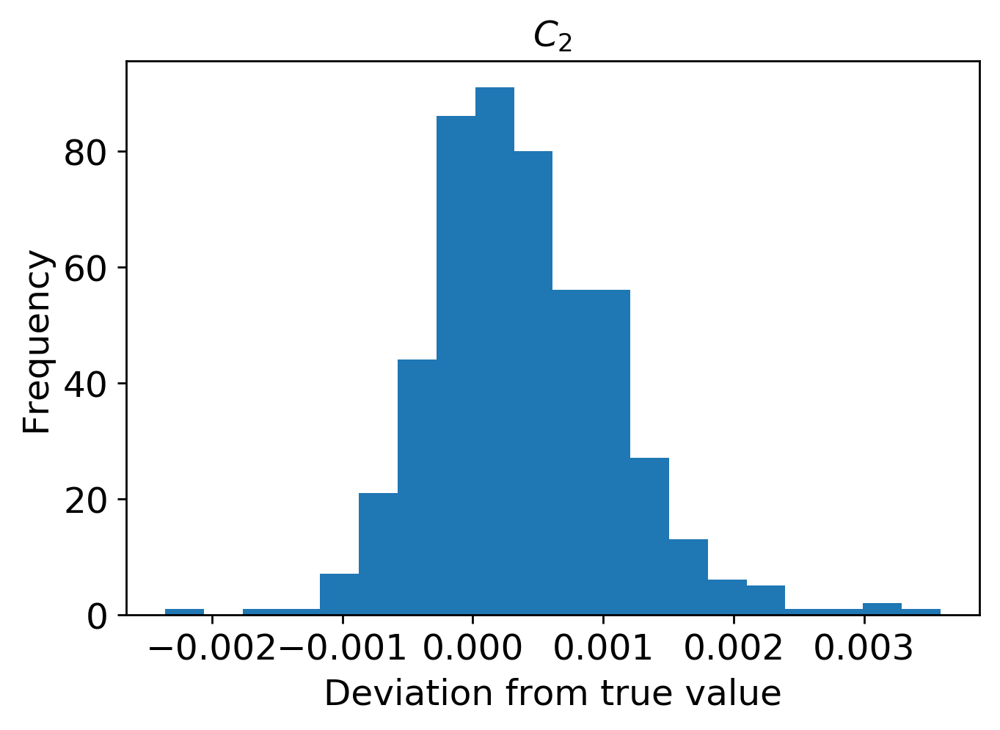

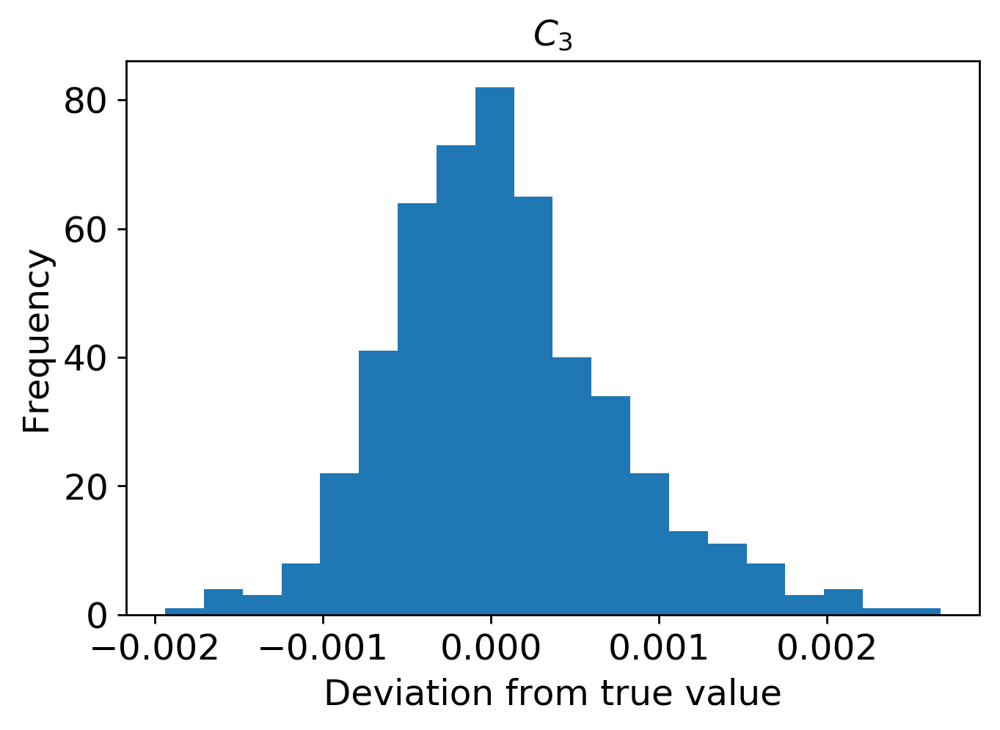

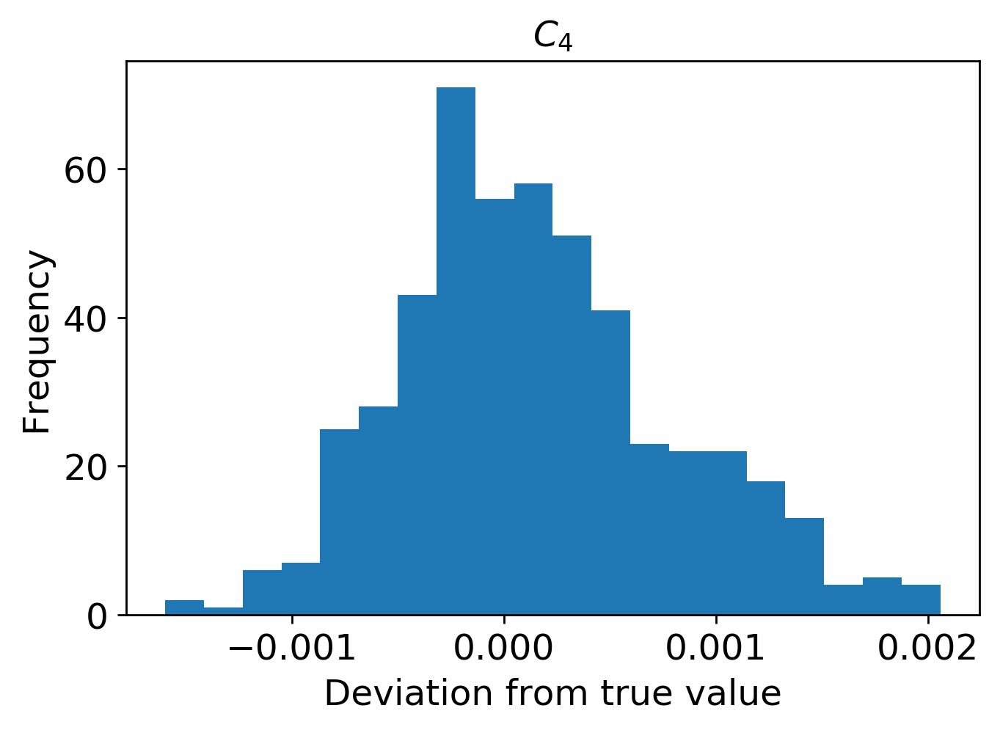

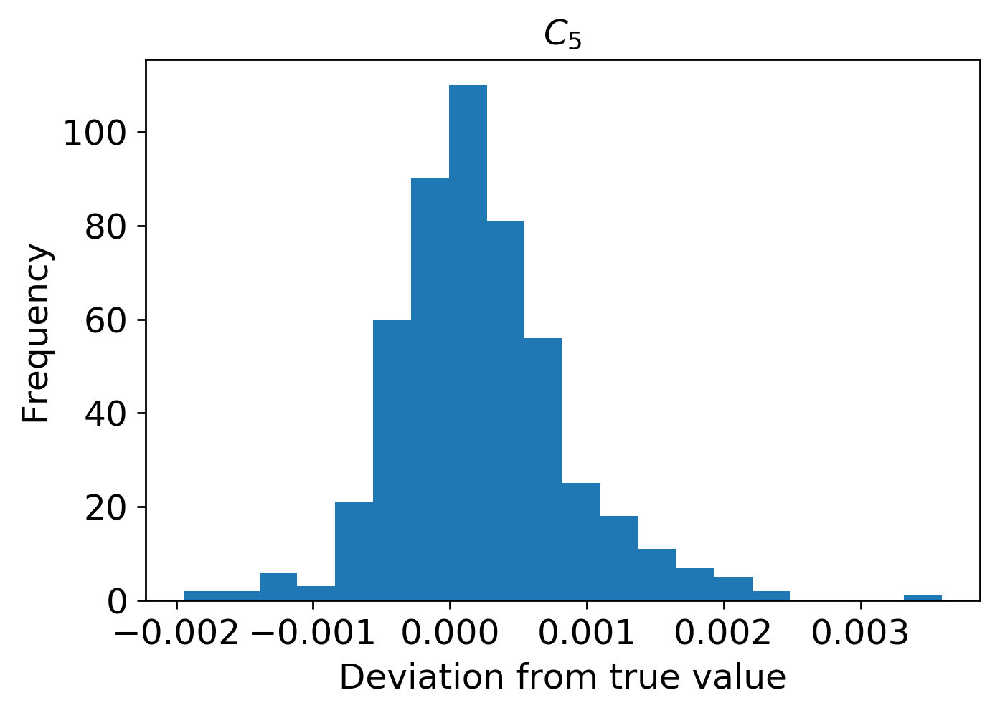

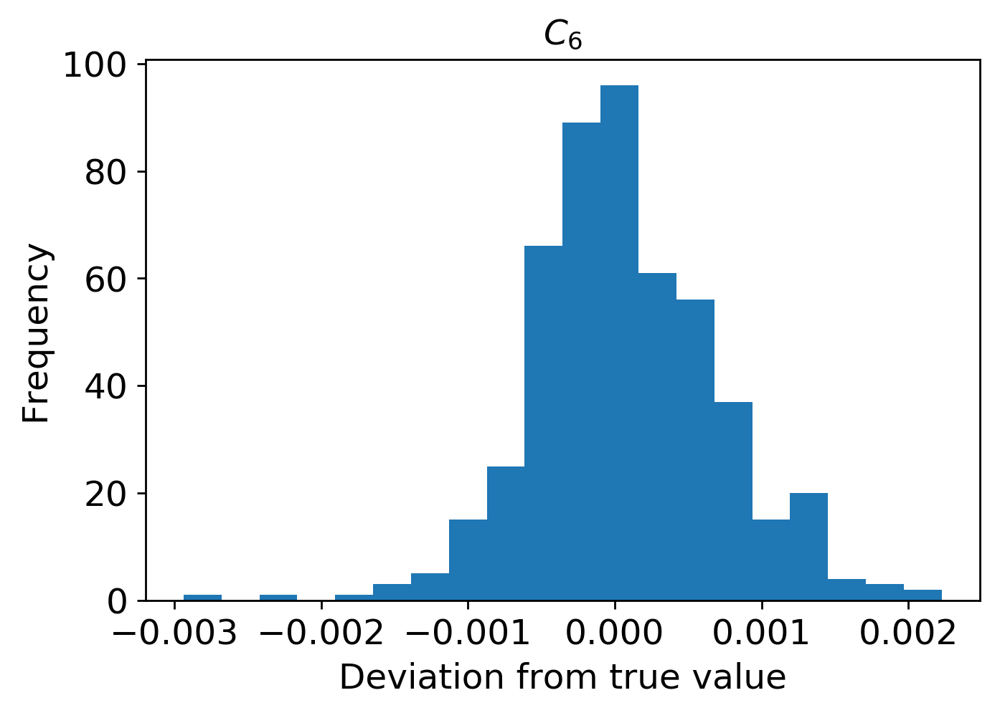

In [18]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1600/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

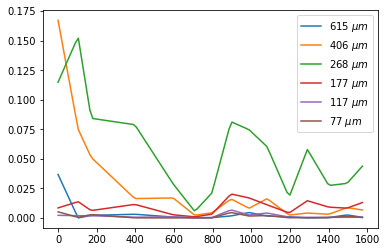

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1600/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi1600.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



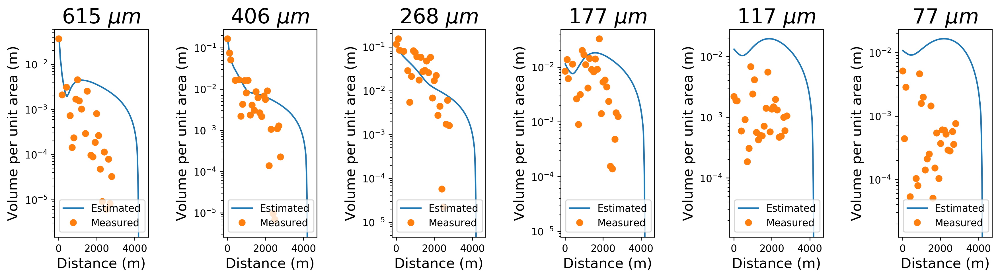

In [20]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi1600.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1600.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1600.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1600.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1600.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1600.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1600.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1600.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


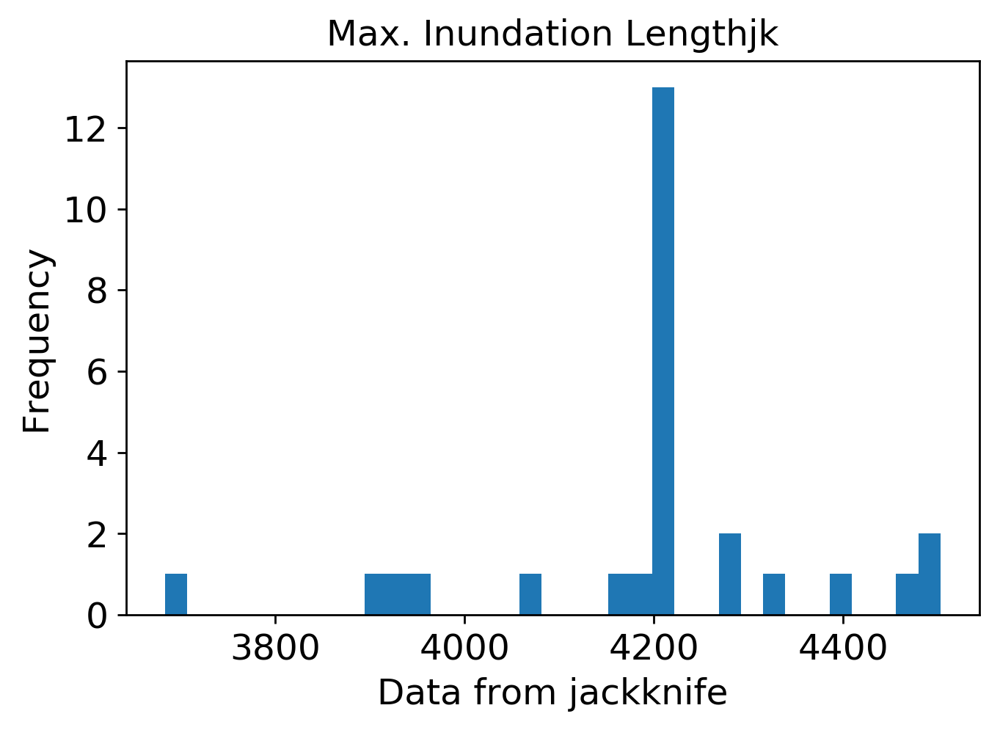

mean: 5.238439896499134
jk_e: 0.06385270152558109


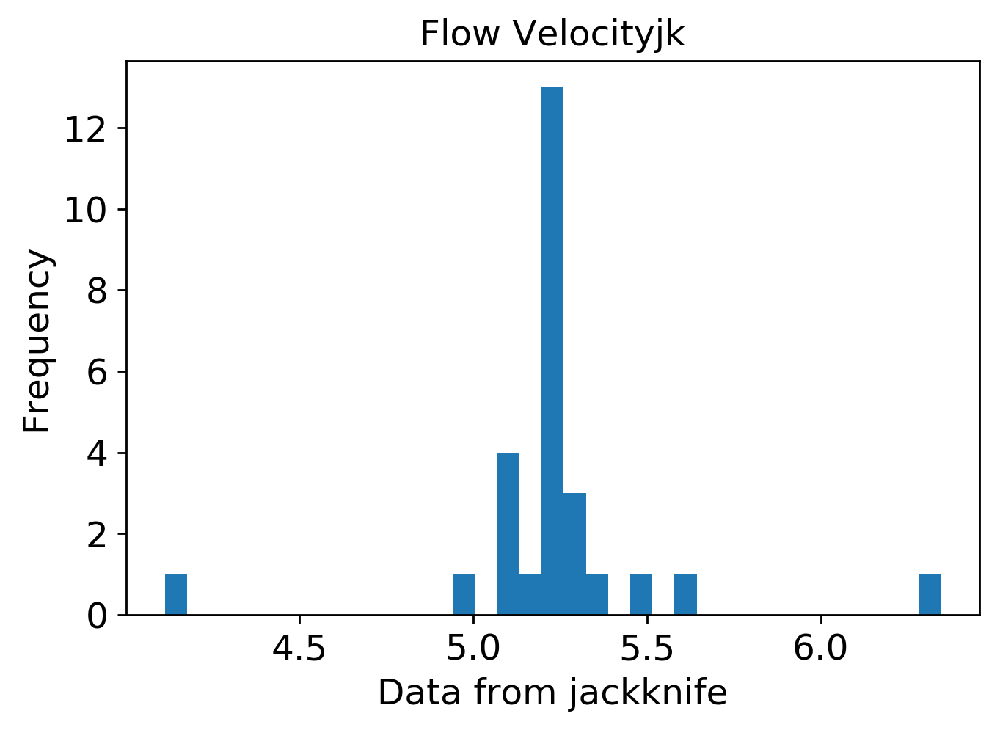

mean: 4.47925747843172
jk_e: 0.06439797553982143


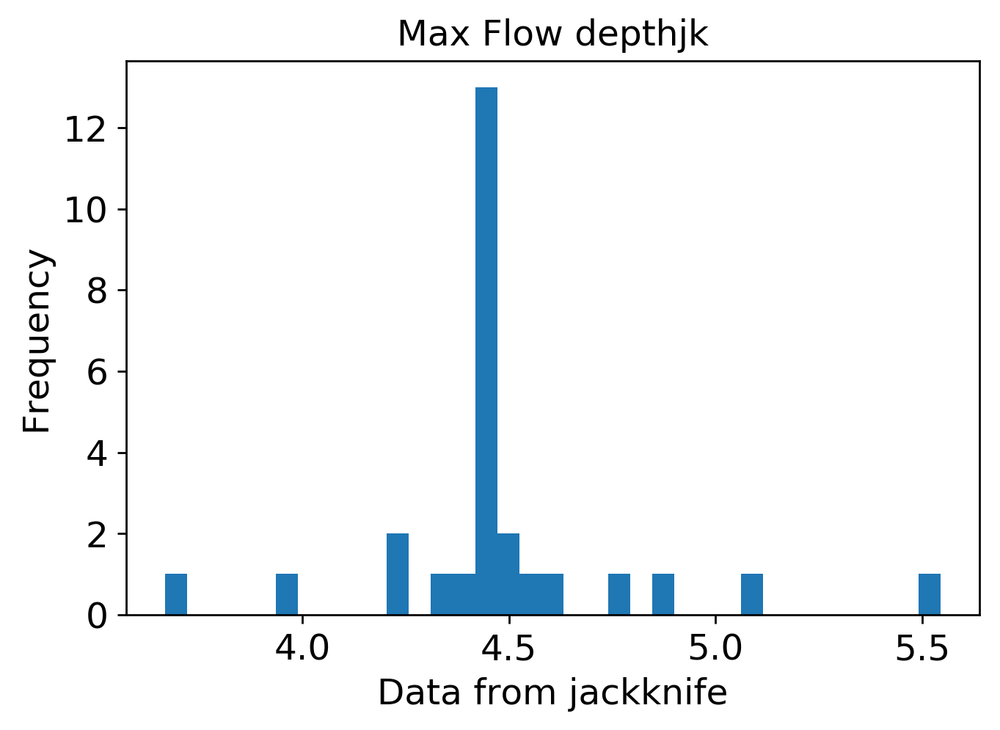

mean: 0.005255746804072798
jk_e: 0.00018476088941334802


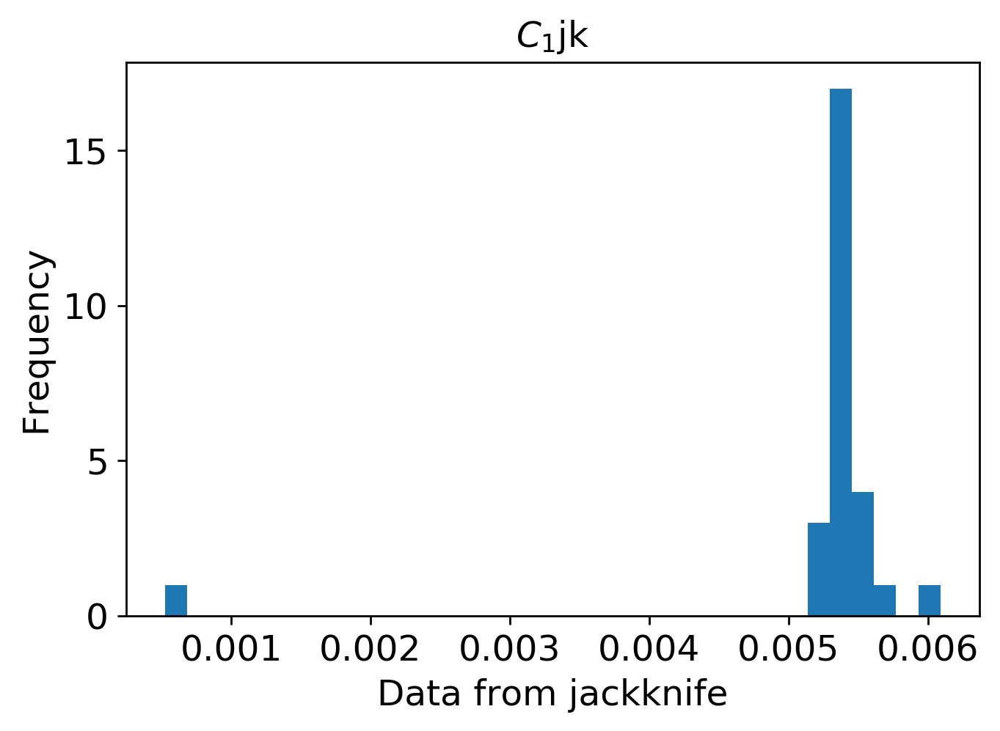

mean: 0.021816019542379248
jk_e: 0.0002569140262954715


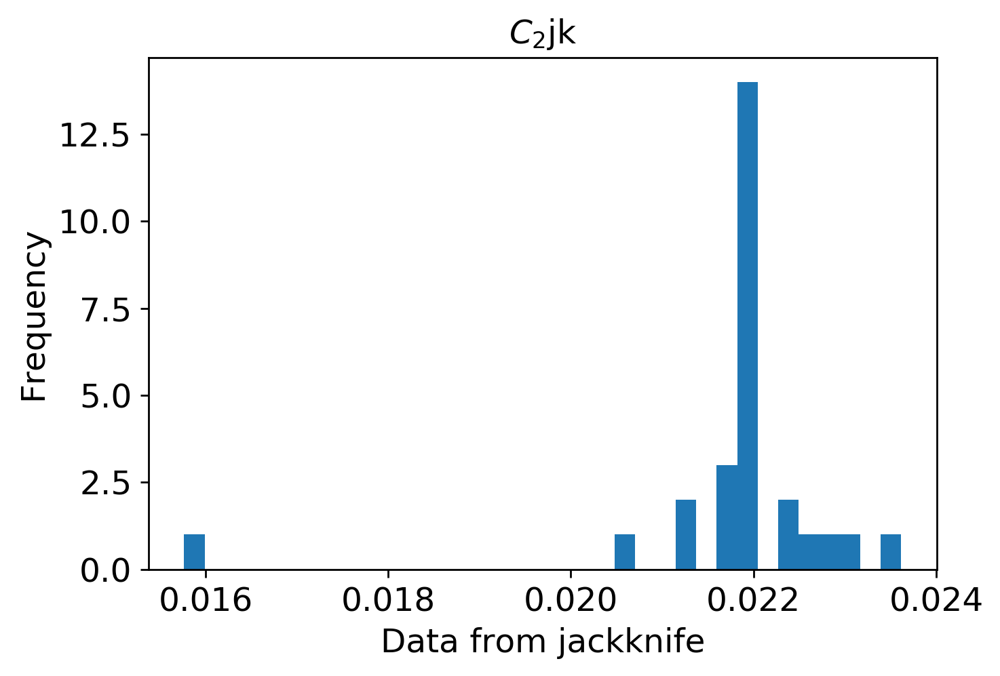

mean: 0.019407666304922057
jk_e: 0.00026090759746163166


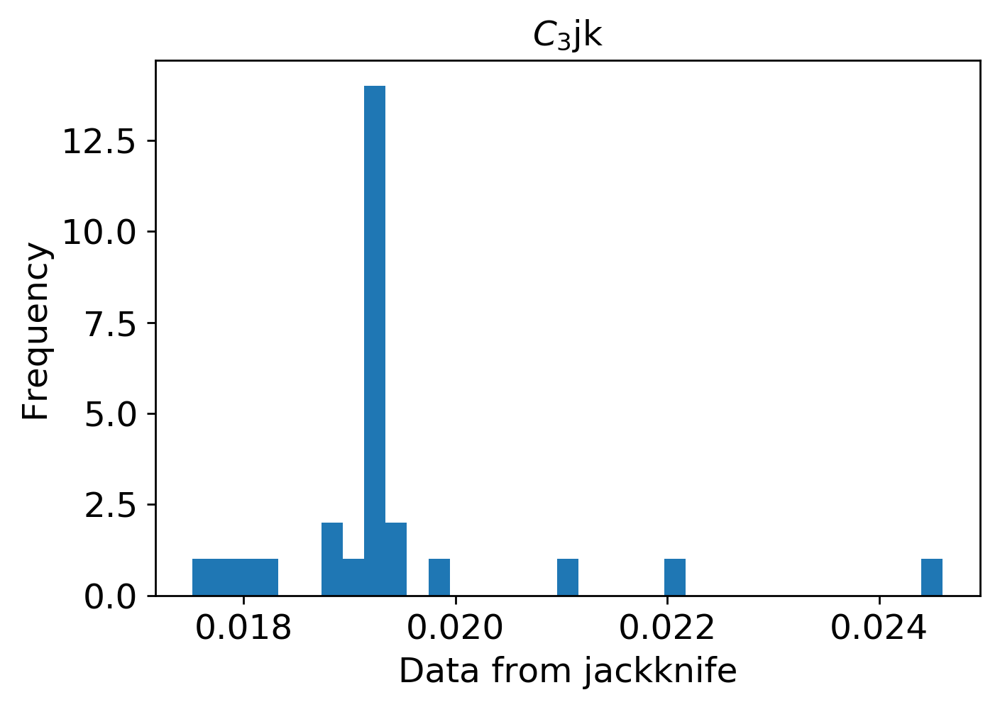

mean: 0.001608456551215294
jk_e: 5.844372916237239e-05


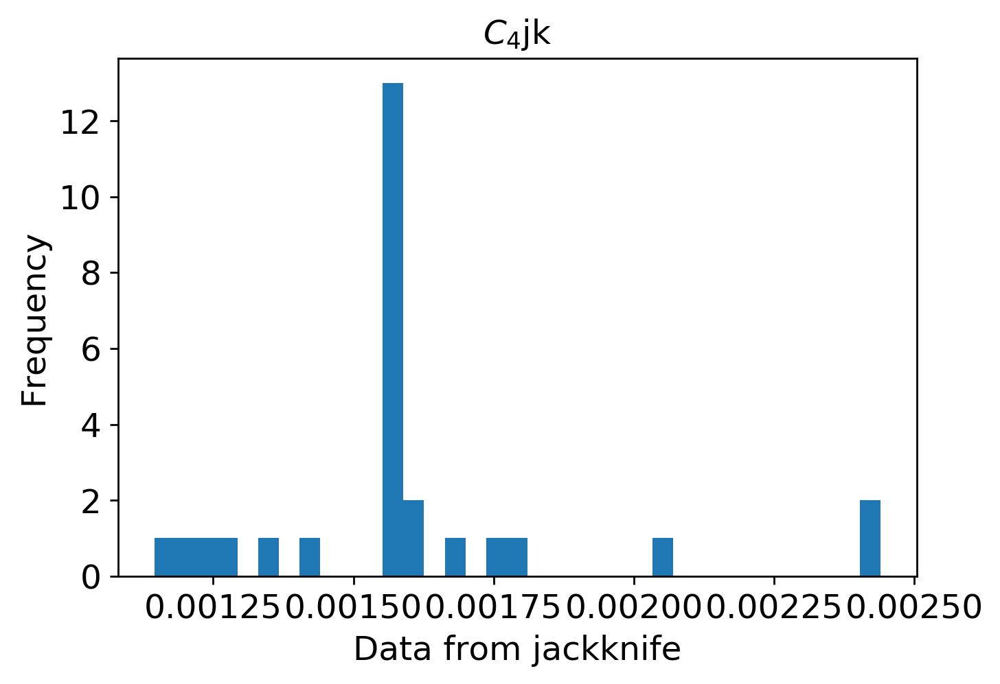

mean: 0.0018288022290042867
jk_e: 6.581450884073439e-05


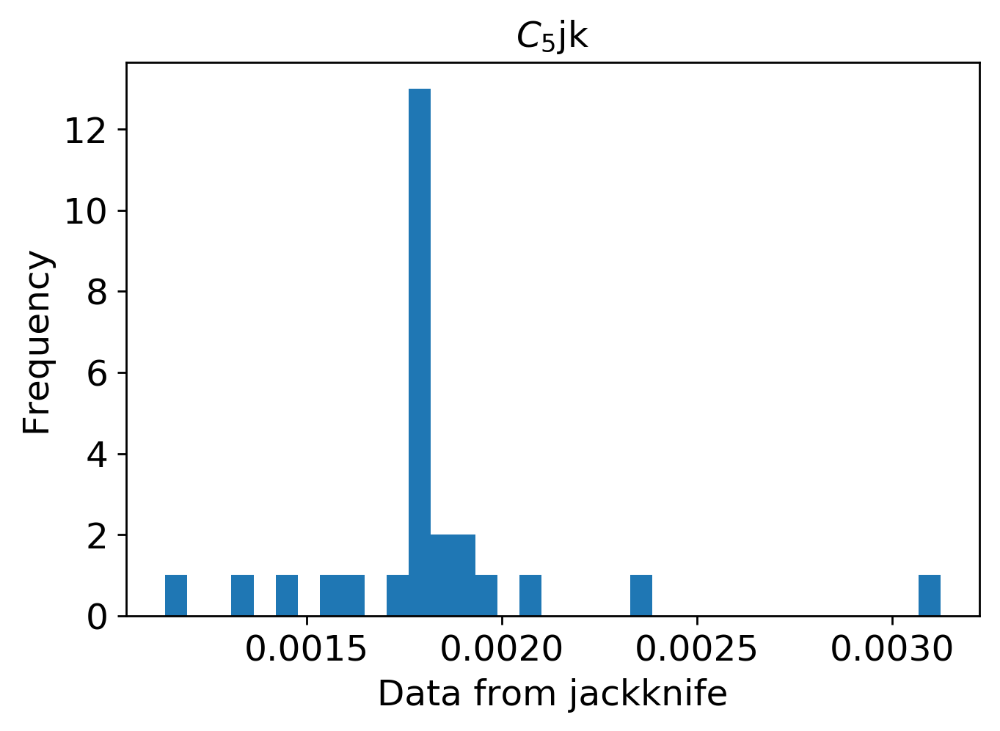

mean: 0.0014564046146583029
jk_e: 4.860389655864835e-05


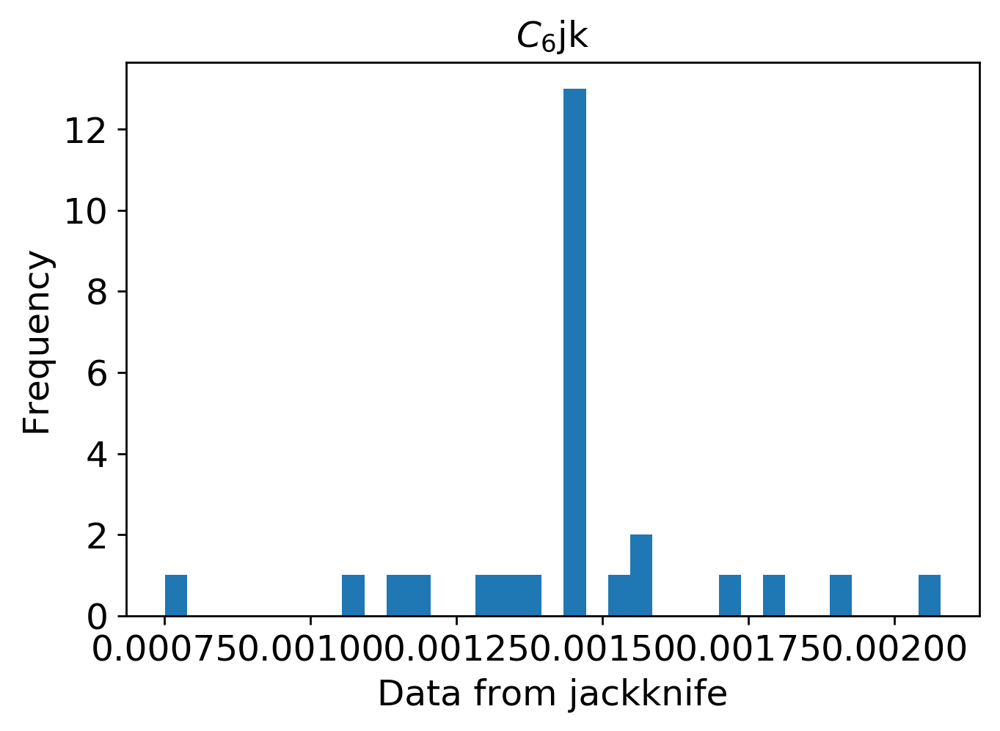

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1600/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi1600.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi1600.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi1600.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 1700

In [21]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi1700"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=1700)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 515us/step - loss: 0.0960 - mean_squared_error: 0.0960 - val_loss: 0.0689 - val_mean_squared_error: 0.0689
Epoch 2/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0643 - mean_squared_error: 0.0643 - val_loss: 0.0556 - val_mean_squared_error: 0.0556
Epoch 3/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0557 - mean_squared_error: 0.0557 - val_loss: 0.0484 - val_mean_squared_error: 0.0484
Epoch 4/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0494 - mean_squared_error: 0.0494 - val_loss: 0.0431 - val_mean_squared_error: 0.0431
Epoch 5/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0445 - mean_squared_error: 0.0445 - val_loss: 0.0384 - val_mean_squared_error: 0.0384
Epoch 6/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0405 - mean_squared_error: 0.04

3600/3600 [==============================] - 1s 345us/step - loss: 0.0121 - mean_squared_error: 0.0121 - val_loss: 0.0095 - val_mean_squared_error: 0.0095
Epoch 98/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0121 - mean_squared_error: 0.0121 - val_loss: 0.0107 - val_mean_squared_error: 0.0107
Epoch 99/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0120 - mean_squared_error: 0.0120 - val_loss: 0.0110 - val_mean_squared_error: 0.0110
Epoch 100/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0120 - mean_squared_error: 0.0120 - val_loss: 0.0096 - val_mean_squared_error: 0.0096
Epoch 101/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0121 - mean_squared_error: 0.0121 - val_loss: 0.0096 - val_mean_squared_error: 0.0096
Epoch 102/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0118 - mean_squared_error: 0.0118 - val_loss: 0.0102 - val_mean_squared_error: 0.01

3600/3600 [==============================] - 1s 340us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 194/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0070 - val_mean_squared_error: 0.0070
Epoch 195/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 196/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 197/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 198/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0072 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 344us/step - loss: 0.0079 - mean_squared_error: 0.0079 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 290/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0049 - val_mean_squared_error: 0.0049
Epoch 291/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 292/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0078 - mean_squared_error: 0.0078 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 293/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0076 - mean_squared_error: 0.0076 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 294/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0077 - mean_squared_error: 0.0077 - val_loss: 0.0049 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 355us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 386/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 387/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 388/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 389/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 390/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0046 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 354us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 482/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 483/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 484/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 485/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0064 - mean_squared_error: 0.0064 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 486/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0065 - mean_squared_error: 0.0065 - val_loss: 0.0045 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 353us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 578/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 579/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 580/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 581/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 582/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0034 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 350us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 674/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 675/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 676/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 677/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 678/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0037 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 355us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 770/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 771/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 772/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 773/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 774/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0028 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 355us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 866/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 867/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 868/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 869/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 870/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0030 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 356us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 962/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 963/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 964/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 965/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 966/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 353us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1058/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1059/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1060/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1061/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1062/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 353us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1106/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1107/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1108/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1109/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1110/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 1154/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 1155/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1156/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1157/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1158/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0029 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1202/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1203/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1204/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1205/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1206/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_erro

3600/3600 [==============================] - 1s 352us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1250/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1251/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1252/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 1253/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1254/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_erro

3600/3600 [==============================] - 1s 342us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1298/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1299/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1300/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1301/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1302/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_erro

3600/3600 [==============================] - 1s 347us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1346/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 1347/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1348/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1349/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1350/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_erro

3600/3600 [==============================] - 1s 343us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1394/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1395/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1396/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1397/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1398/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_erro

3600/3600 [==============================] - 1s 353us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1442/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1443/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1444/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1445/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 1446/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0021 - val_mean_squared_erro

3600/3600 [==============================] - 1s 353us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1490/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1491/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1492/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1493/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1494/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0021 - val_mean_squared_erro

3600/3600 [==============================] - 1s 356us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 1538/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1539/2000
3600/3600 [==============================] - 1s 354us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1540/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1541/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1542/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 351us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1586/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1587/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 1588/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1589/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1590/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_erro

3600/3600 [==============================] - 1s 346us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1634/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1635/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1636/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1637/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1638/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0022 - val_mean_squared_erro

3600/3600 [==============================] - 1s 348us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1682/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1683/2000
3600/3600 [==============================] - 1s 350us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1684/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1685/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1686/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1730/2000
3600/3600 [==============================] - 1s 347us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1731/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1732/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1733/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1734/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0024 - val_mean_squared_erro

3600/3600 [==============================] - 1s 344us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1778/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1779/2000
3600/3600 [==============================] - 1s 345us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1780/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1781/2000
3600/3600 [==============================] - 1s 351us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1782/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_erro

3600/3600 [==============================] - 1s 342us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1826/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 1827/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1828/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1829/2000
3600/3600 [==============================] - 1s 344us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1830/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_erro

3600/3600 [==============================] - 1s 349us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1874/2000
3600/3600 [==============================] - 1s 348us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 1875/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1876/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1877/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1878/2000
3600/3600 [==============================] - 1s 338us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_erro

3600/3600 [==============================] - 1s 351us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1922/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1923/2000
3600/3600 [==============================] - 1s 342us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 1924/2000
3600/3600 [==============================] - 1s 346us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1925/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1926/2000
3600/3600 [==============================] - 1s 340us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0020 - val_mean_squared_erro

3600/3600 [==============================] - 1s 341us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1970/2000
3600/3600 [==============================] - 1s 341us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1971/2000
3600/3600 [==============================] - 1s 343us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1972/2000
3600/3600 [==============================] - 1s 339us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1973/2000
3600/3600 [==============================] - 1s 349us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1974/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0021 - val_mean_squared_erro

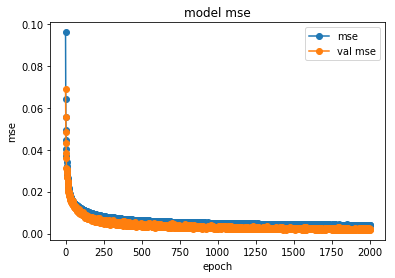

save the model


In [22]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1700/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1700/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


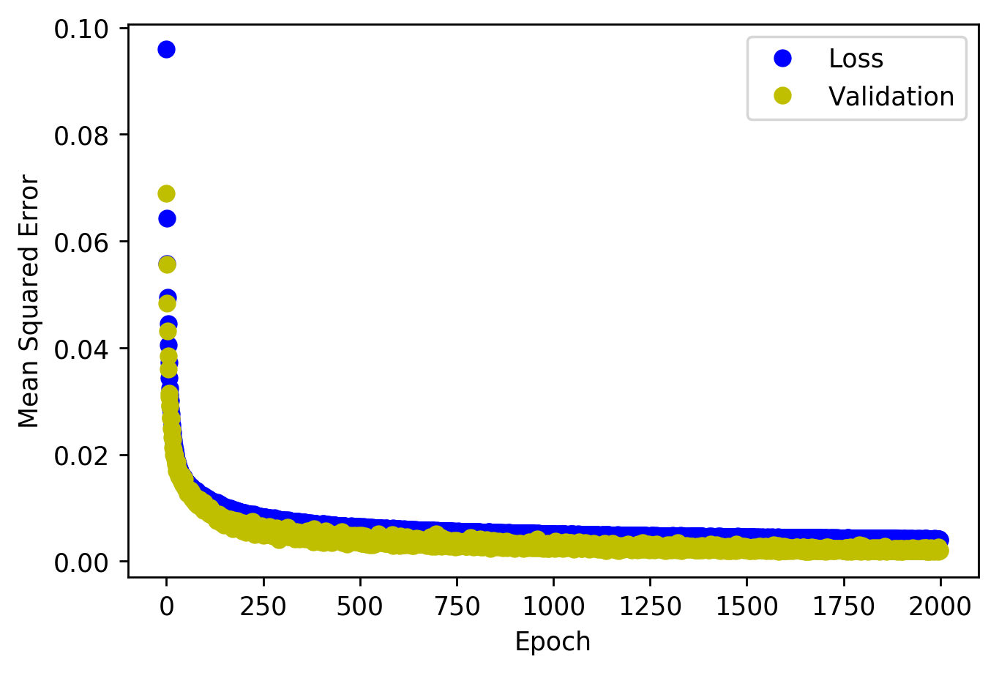

<Figure size 432x288 with 0 Axes>

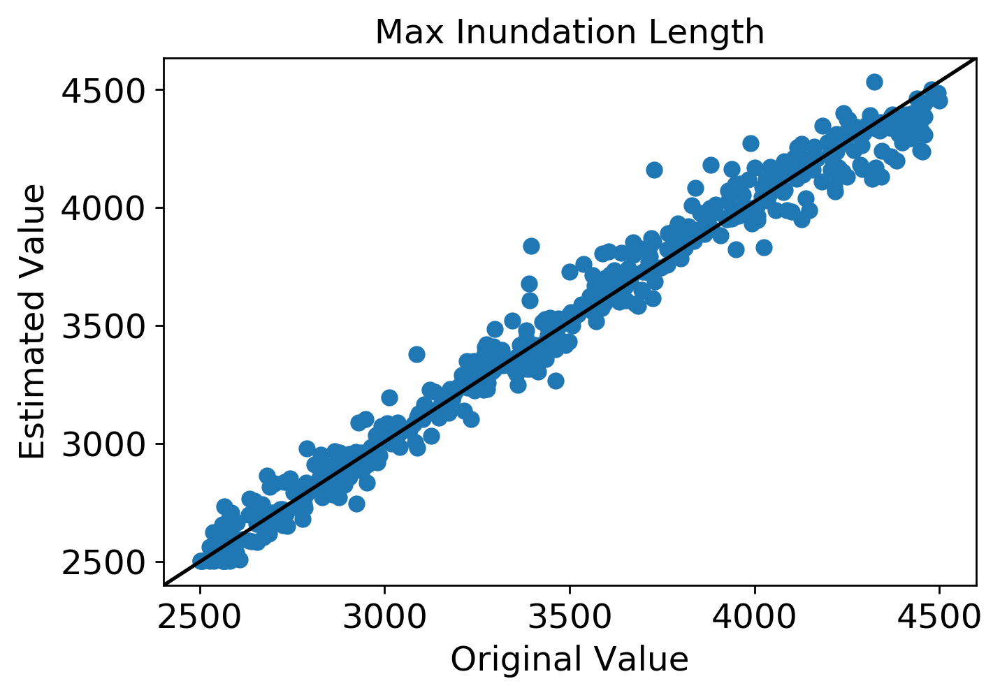

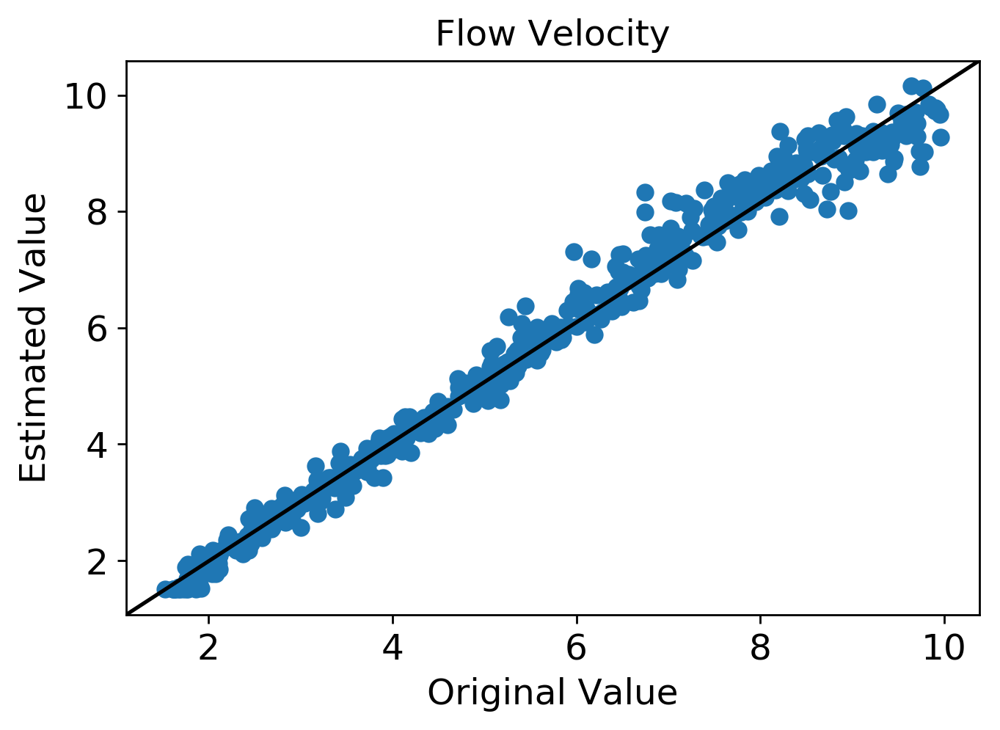

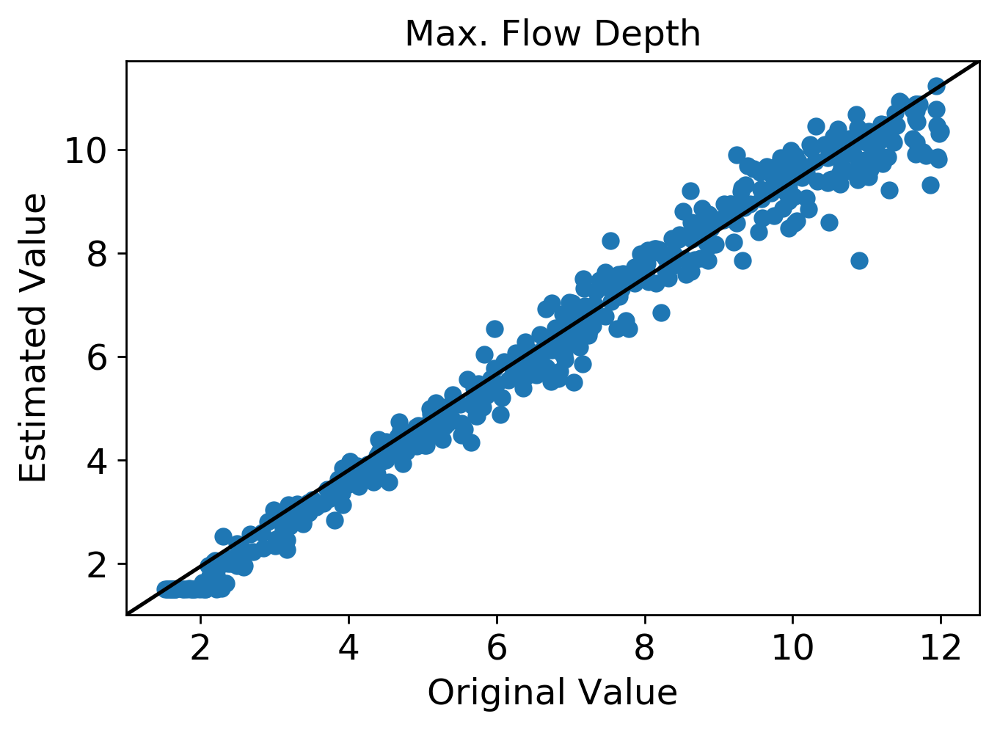

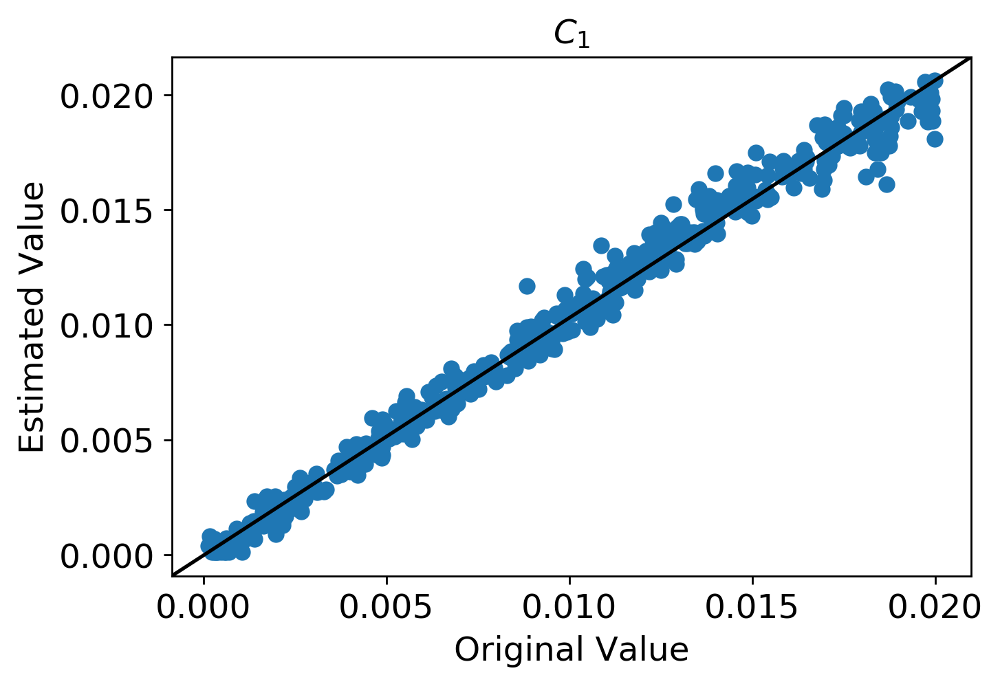

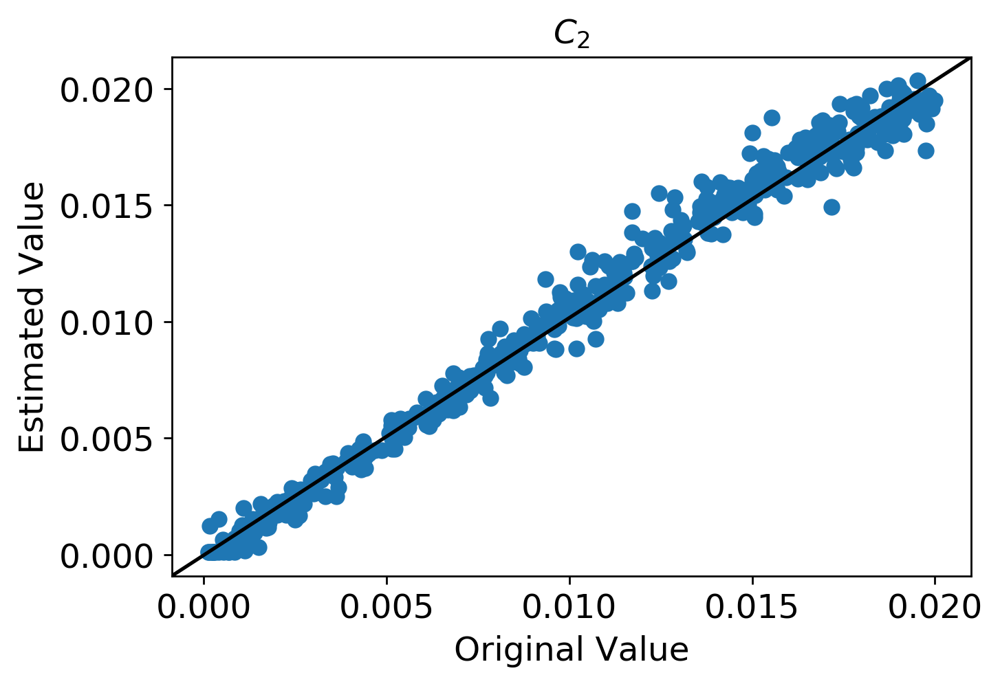

...

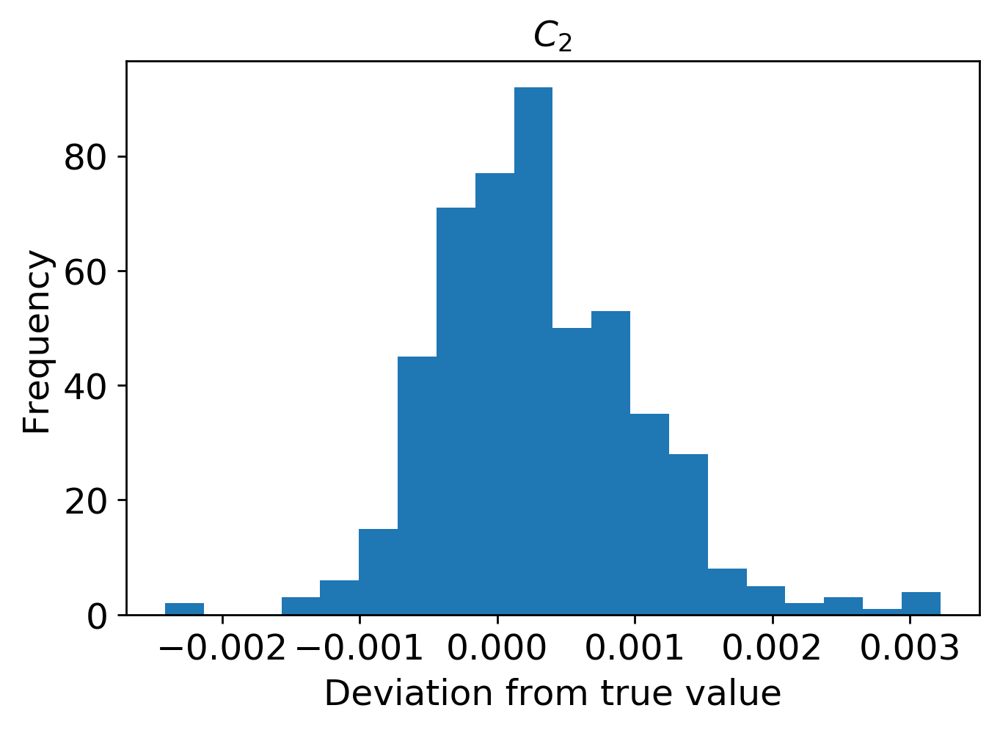

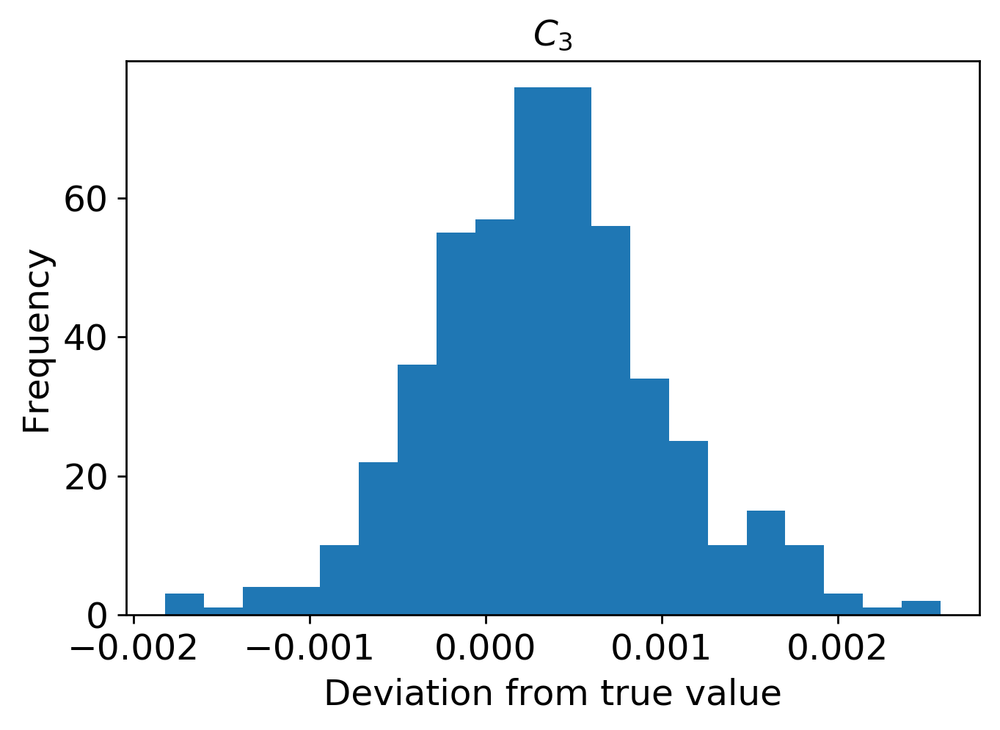

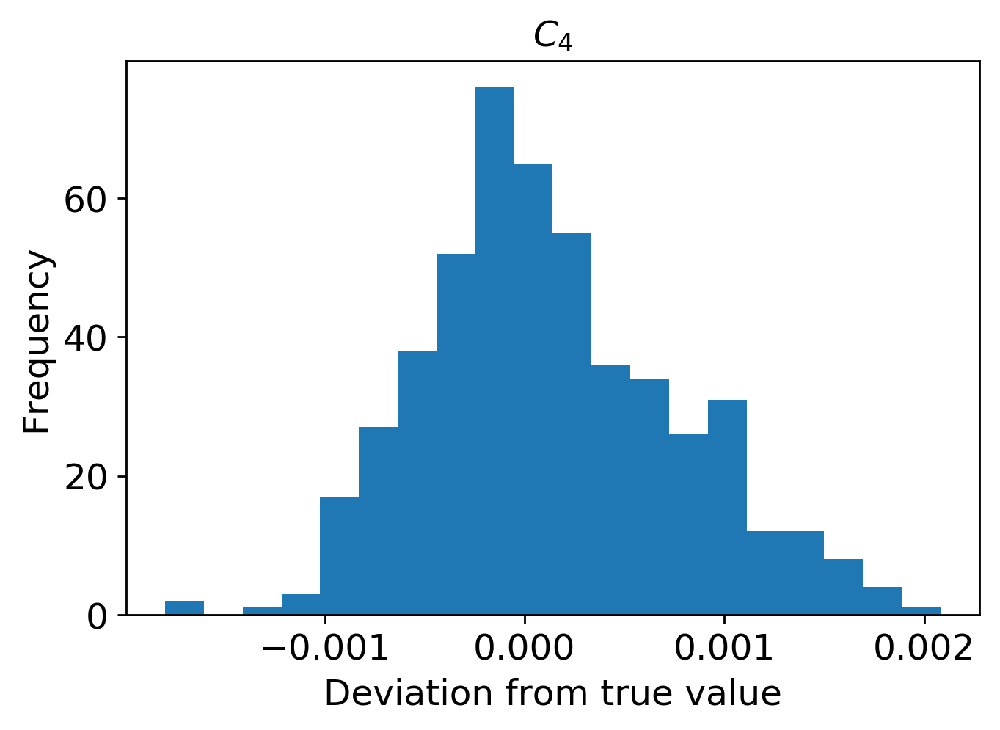

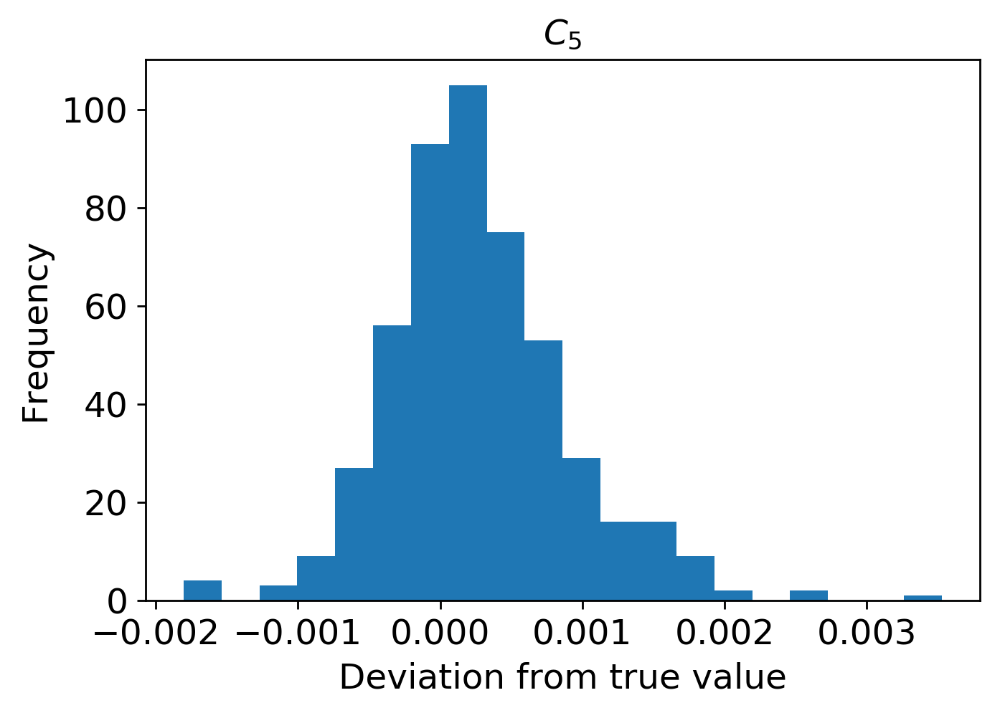

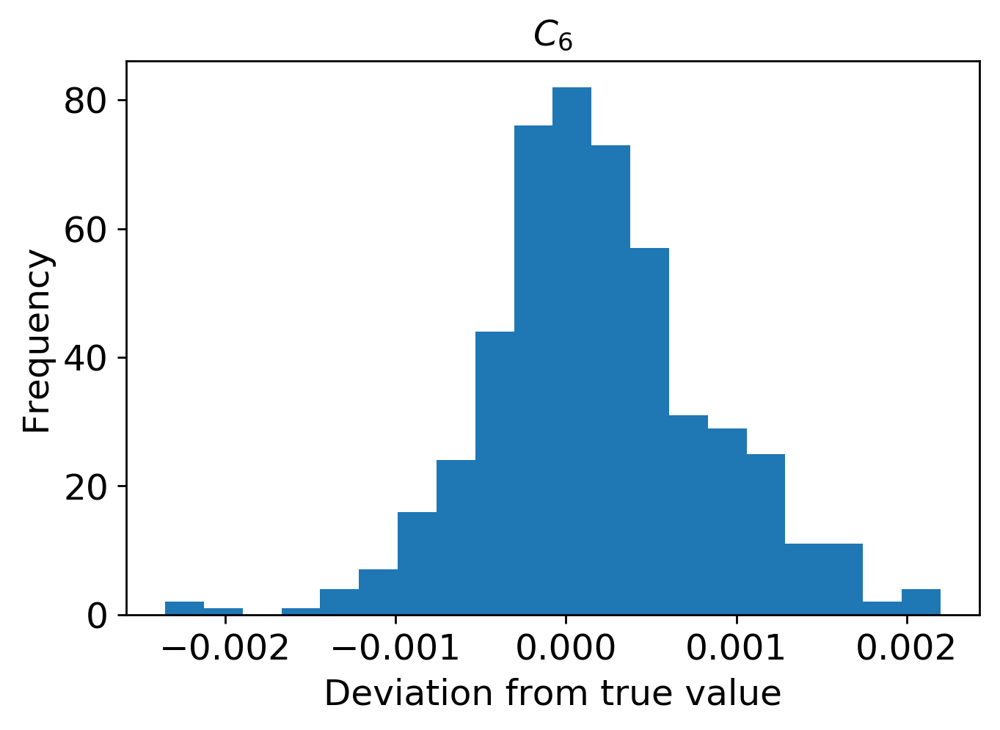

In [23]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1700/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1700/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

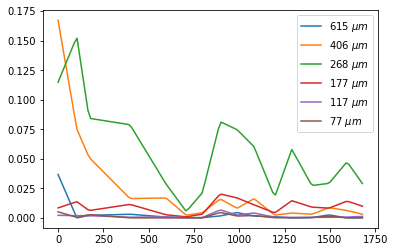

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1700/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1700/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi1700.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



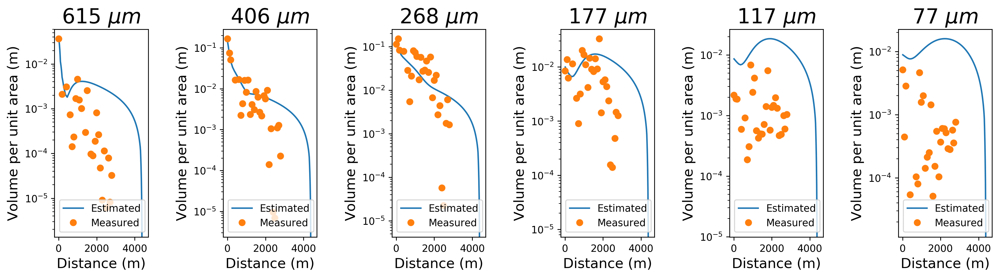

In [25]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi1700.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1700.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1700.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1700.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1700.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi1700.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1700.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi1700.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[4.69256921e+03 5.25127992e+00 3.62274459e+00 5.28294300e-03
  2.18785415e-02 2.12695360e-02 2.33189941e-03 1.79384079e-03
  1.94648296e-03]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


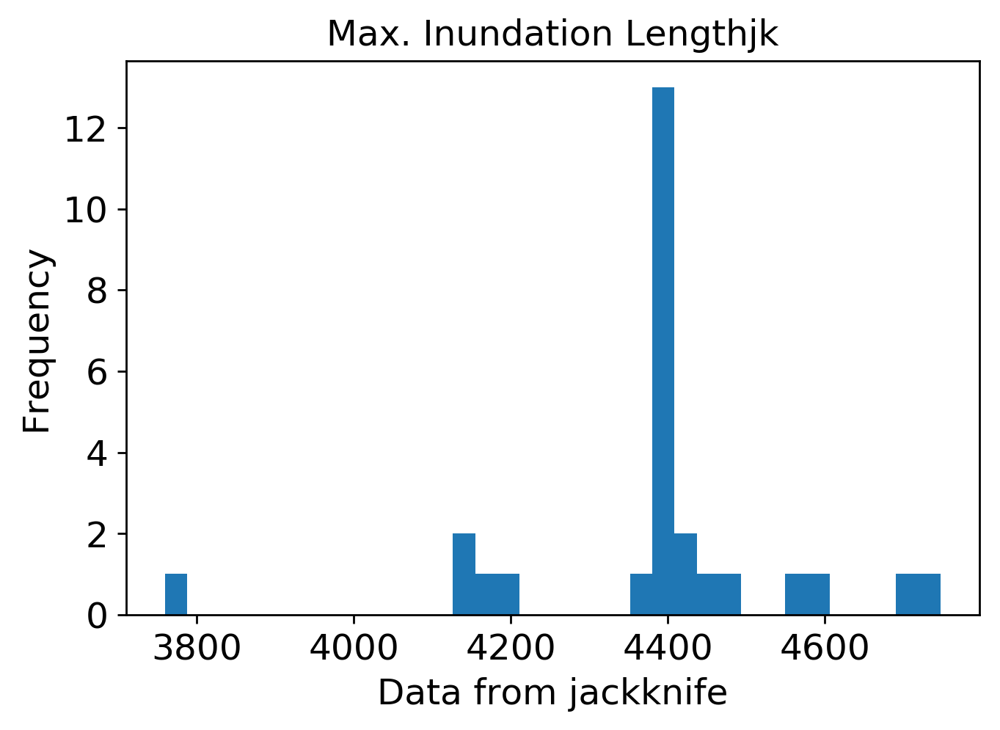

mean: 5.182656447248449
jk_e: 0.06479072773790447


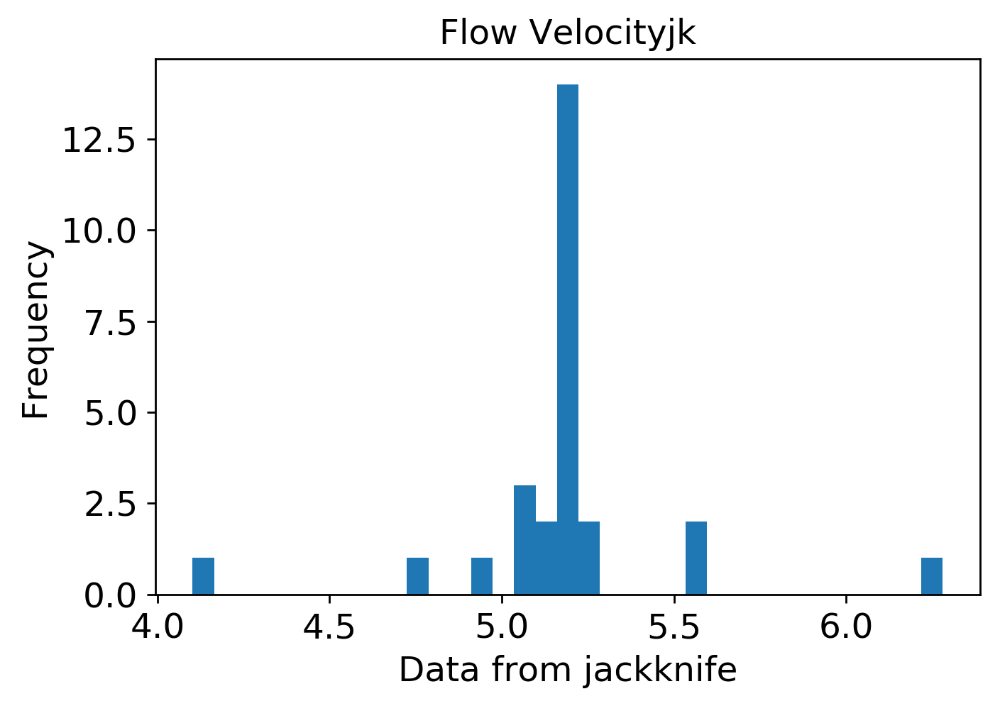

mean: 4.097936562235151
jk_e: 0.06628855166492766


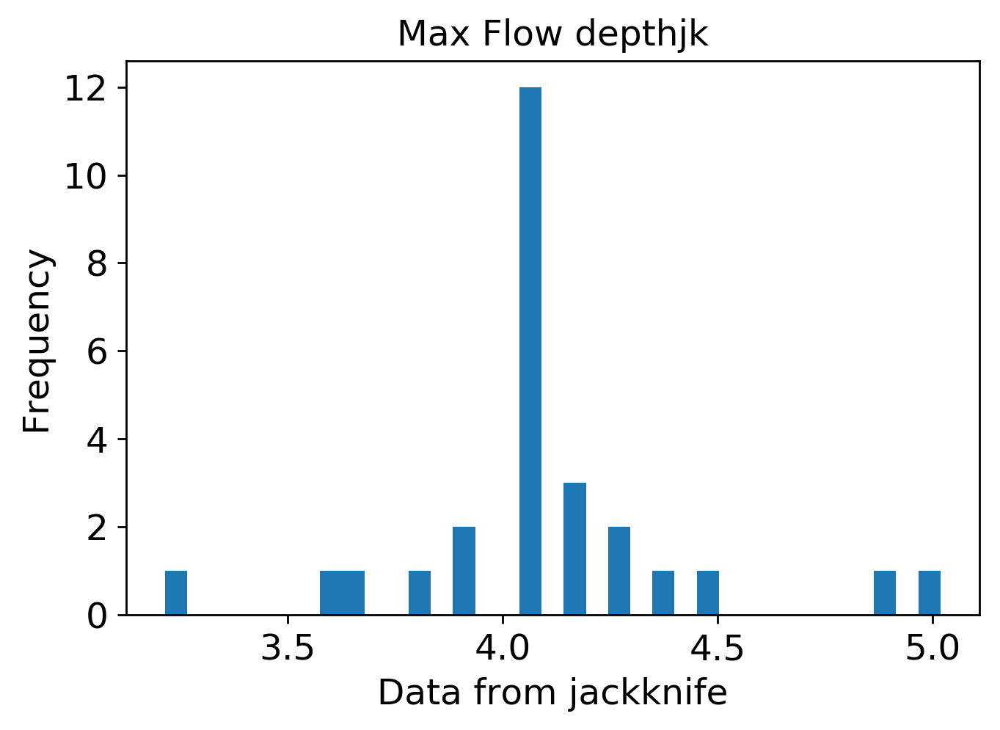

mean: 0.005330448323994814
jk_e: 0.00018624294620320467


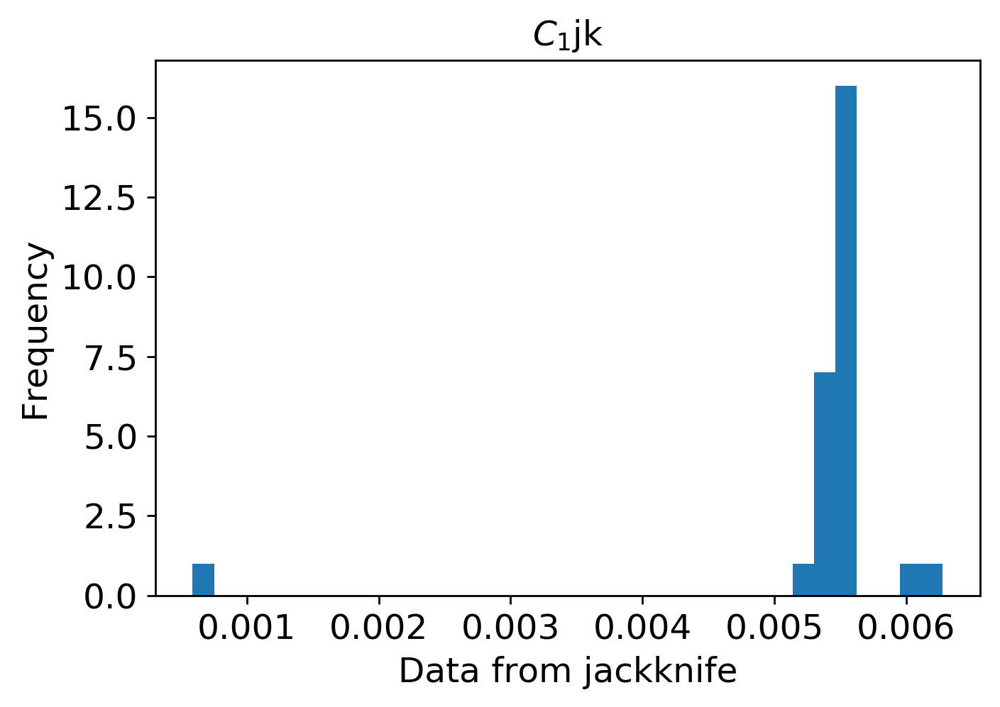

mean: 0.020960376583996736
jk_e: 0.00024958027971563683


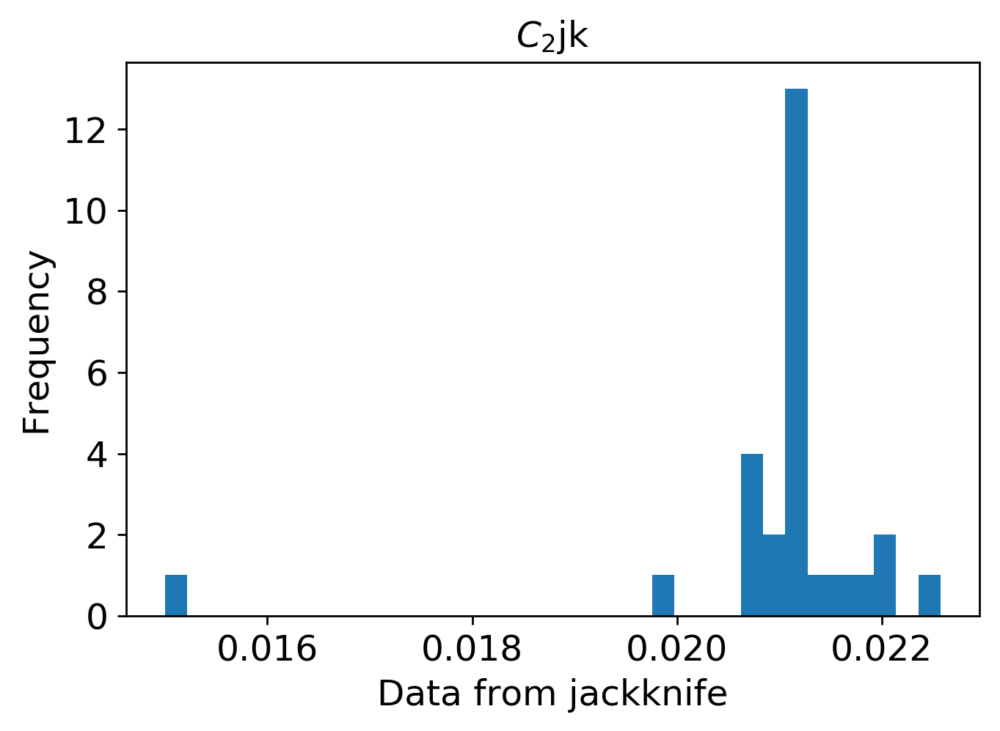

mean: 0.02010616348095949
jk_e: 0.00026221120972968716


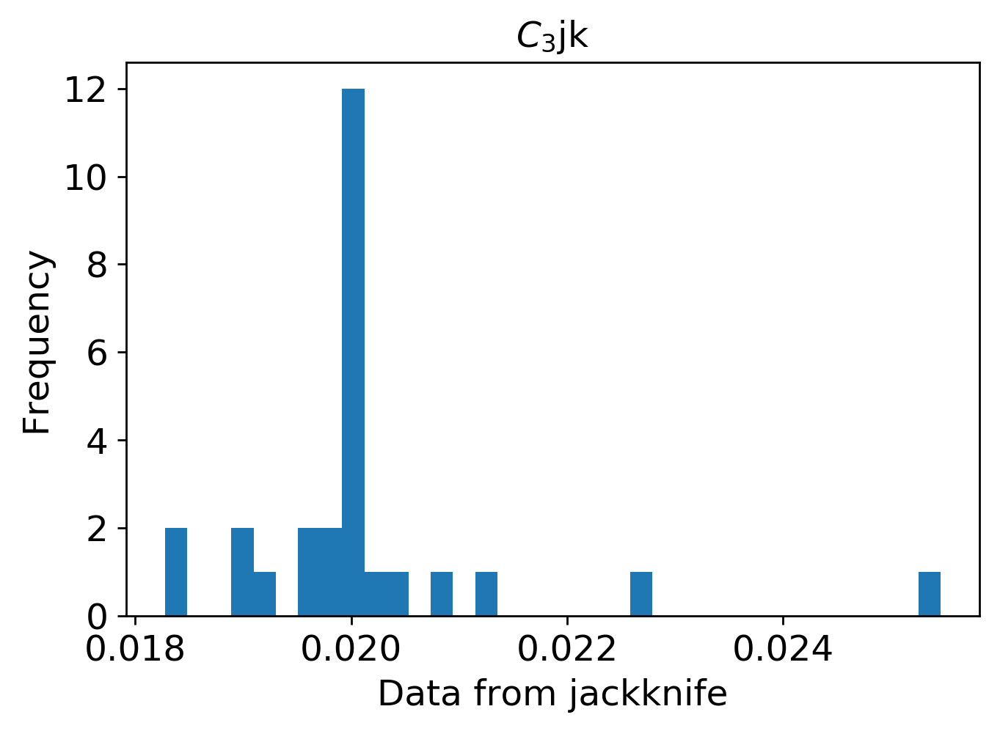

mean: 0.0015510170977835335
jk_e: 6.843914438616183e-05


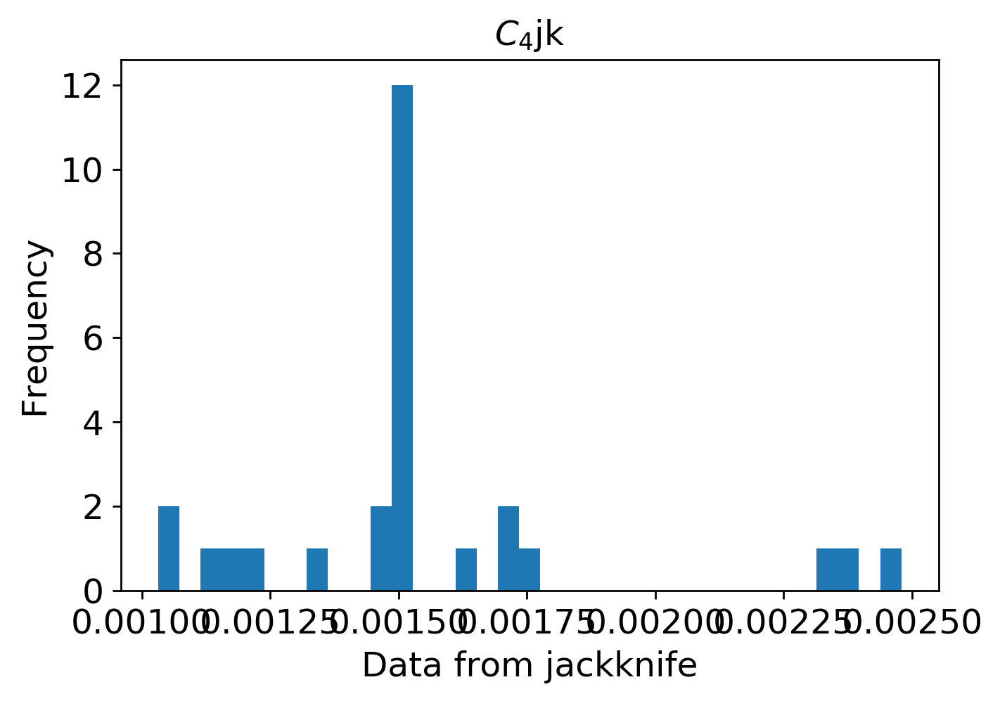

mean: 0.001284616223131409
jk_e: 5.428240022172268e-05


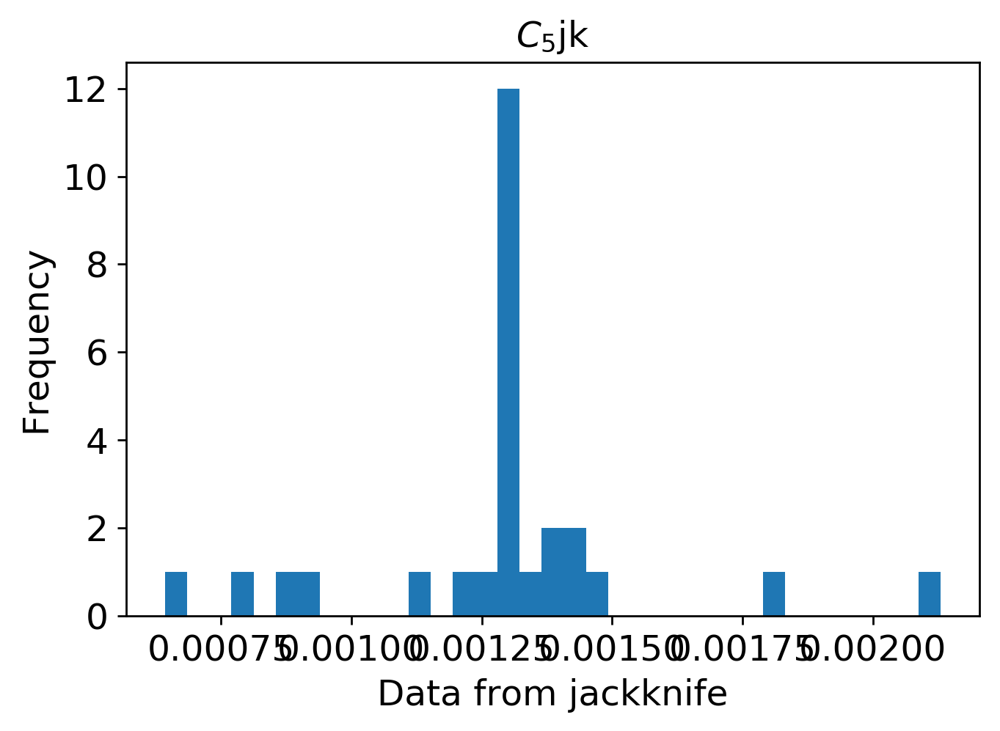

mean: 0.0013232568419983453
jk_e: 6.076745240149066e-05


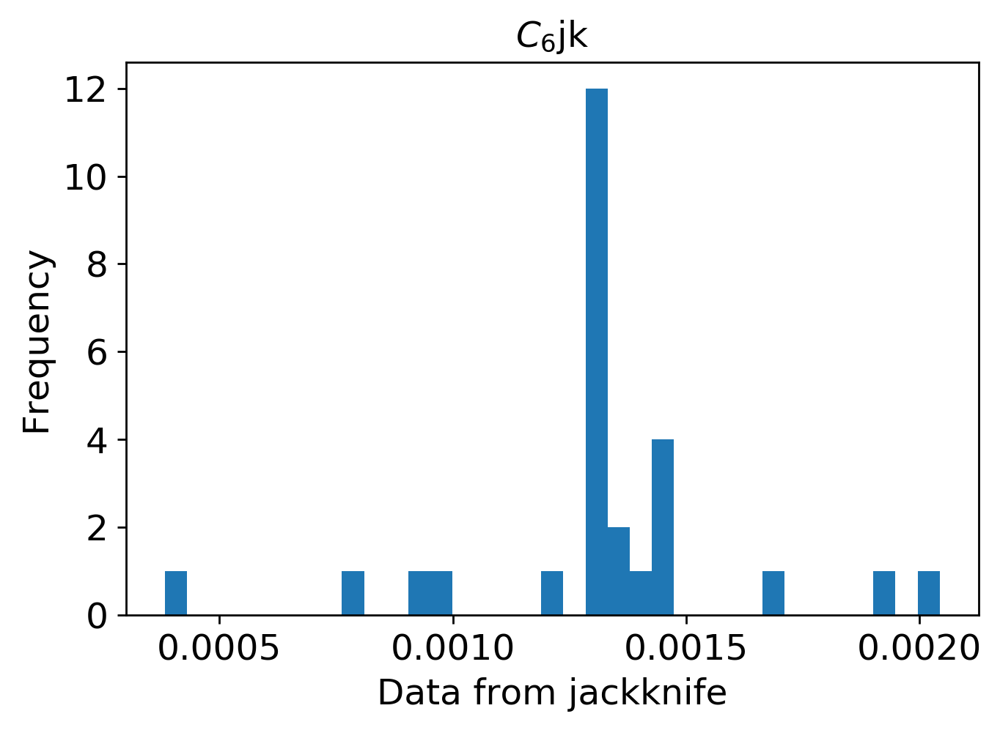

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi1700/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi1700/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi1700.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi1700.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi1700.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 3000

In [1]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3000"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3000)
        
        
    

In [2]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3000/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3000/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




Using TensorFlow backend.


Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 3s 712us/step - loss: 0.0962 - mean_squared_error: 0.0962 - val_loss: 0.0698 - val_mean_squared_error: 0.0698
Epoch 2/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0647 - mean_squared_error: 0.0647 - val_loss: 0.0573 - val_mean_squared_error: 0.0573
Epoch 3/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0556 - mean_squared_error: 0.0556 - val_loss: 0.0482 - val_mean_squared_error: 0.0482
Epoch 4/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0490 - mean_squared_error: 0.0490 - val_loss: 0.0417 - val_mean_squared_error: 0.0417
Epoch 5/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0439 - mean_squared_error: 0.0439 - val_loss: 0.0359 - val_mean_squared_error: 0.0359
Epoch 6/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0388 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 358us/step - loss: 0.0094 - mean_squared_error: 0.0094 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 98/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0095 - mean_squared_error: 0.0095 - val_loss: 0.0076 - val_mean_squared_error: 0.0076
Epoch 99/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0094 - mean_squared_error: 0.0094 - val_loss: 0.0077 - val_mean_squared_error: 0.0077
Epoch 100/2000
3600/3600 [==============================] - 1s 355us/step - loss: 0.0094 - mean_squared_error: 0.0094 - val_loss: 0.0071 - val_mean_squared_error: 0.0071
Epoch 101/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 102/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0067 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 360us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 194/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 195/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 196/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0047 - val_mean_squared_error: 0.0047
Epoch 197/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 198/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0071 - mean_squared_error: 0.0071 - val_loss: 0.0041 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 365us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 290/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 291/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 292/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 293/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0062 - mean_squared_error: 0.0062 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 294/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0035 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 381us/step - loss: 0.0057 - mean_squared_error: 0.0057 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 386/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 387/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 388/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 389/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 390/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0027 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 375us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 482/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 483/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 484/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 485/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 486/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0029 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 381us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 578/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 579/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 580/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 581/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 582/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 374us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 674/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 675/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 676/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 677/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 678/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 371us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 770/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 771/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 772/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 773/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 774/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0017 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 374us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 866/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 867/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 868/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 869/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 870/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 362us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 962/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 963/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 964/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 965/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 966/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 379us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1058/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 1059/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1060/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1061/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1062/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_erro

3600/3600 [==============================] - 1s 365us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1106/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1107/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1108/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1109/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1110/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 362us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1154/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1155/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1156/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1157/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1158/2000
3600/3600 [==============================] - 1s 352us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_erro

3600/3600 [==============================] - 1s 370us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1202/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1203/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1204/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1205/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1206/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 361us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1250/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1251/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1252/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1253/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1254/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_erro

3600/3600 [==============================] - 1s 370us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1298/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1299/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1300/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1301/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1302/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 379us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1346/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1347/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1348/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1349/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1350/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 380us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1394/2000
3600/3600 [==============================] - 1s 353us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1395/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1396/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1397/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1398/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 370us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1442/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1443/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1444/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1445/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1446/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 354us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1490/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1491/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1492/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1493/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1494/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 367us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1538/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1539/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1540/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1541/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1542/2000
3600/3600 [==============================] - 1s 356us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 373us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1586/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1587/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1588/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1589/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1590/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 367us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1634/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1635/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1636/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1637/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1638/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 375us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1682/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1683/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1684/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1685/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1686/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1730/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1731/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1732/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1733/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1734/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 372us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1778/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1779/2000
3600/3600 [==============================] - 1s 357us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1780/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1781/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1782/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 372us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1826/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1827/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1828/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1829/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1830/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1874/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1875/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1876/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1877/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1878/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 360us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1922/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1923/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1924/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1925/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1926/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 371us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1970/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1971/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1972/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1973/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1974/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_erro

<Figure size 640x480 with 1 Axes>

save the model


(500, 9)


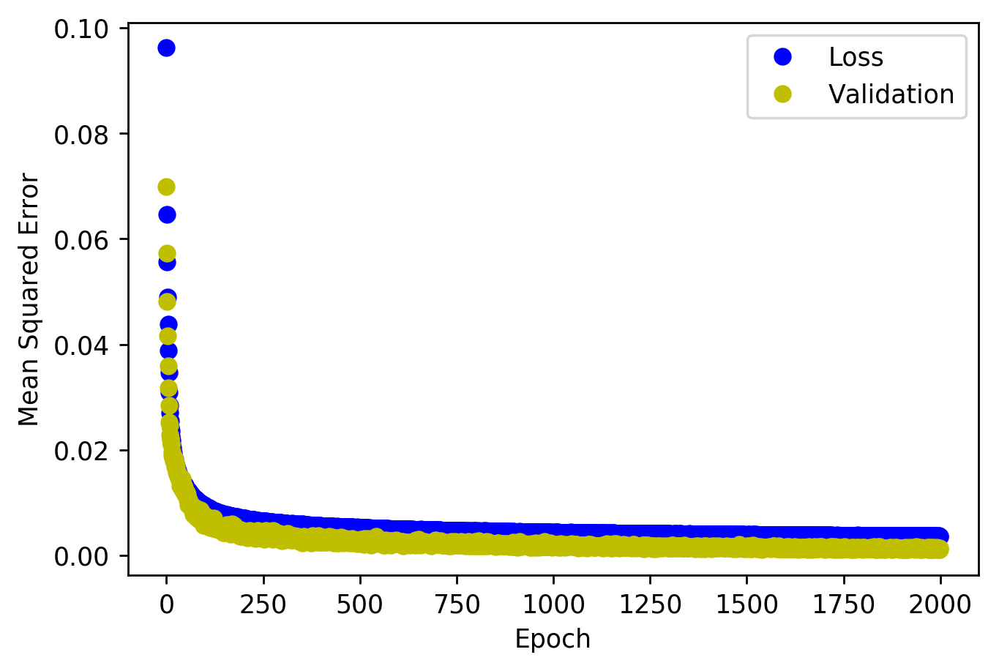

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


<Figure size 432x288 with 0 Axes>

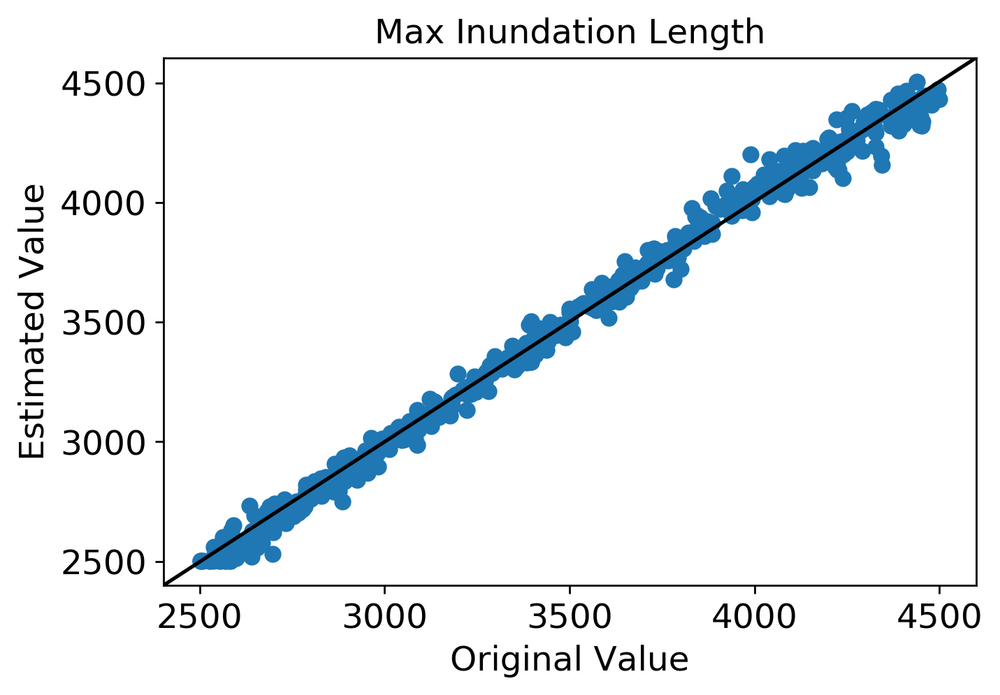

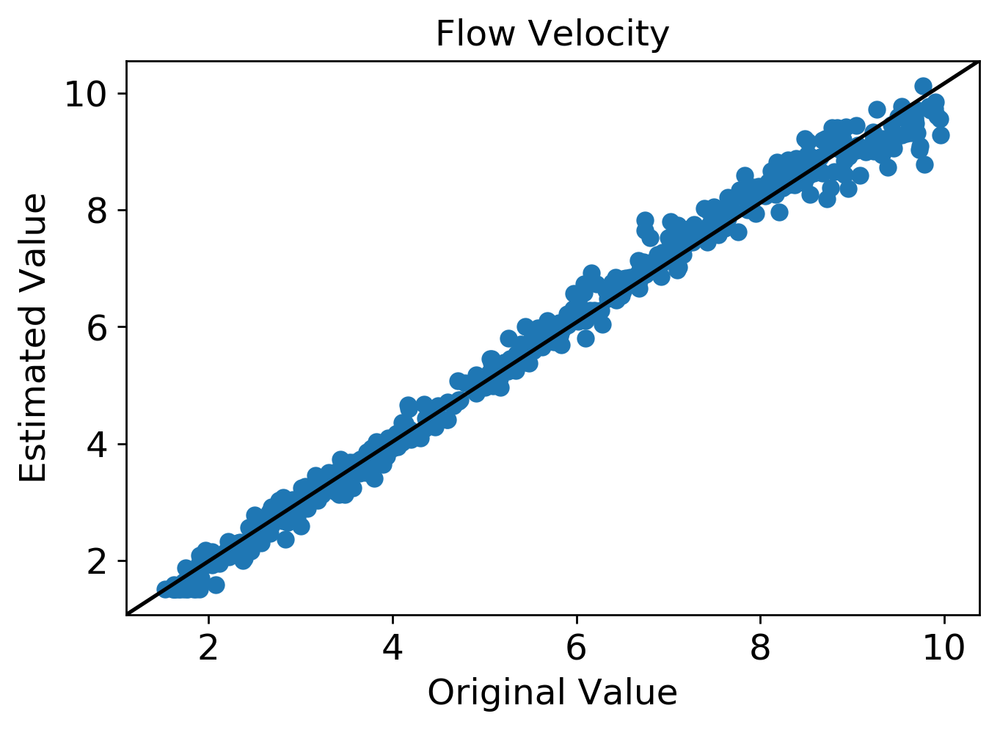

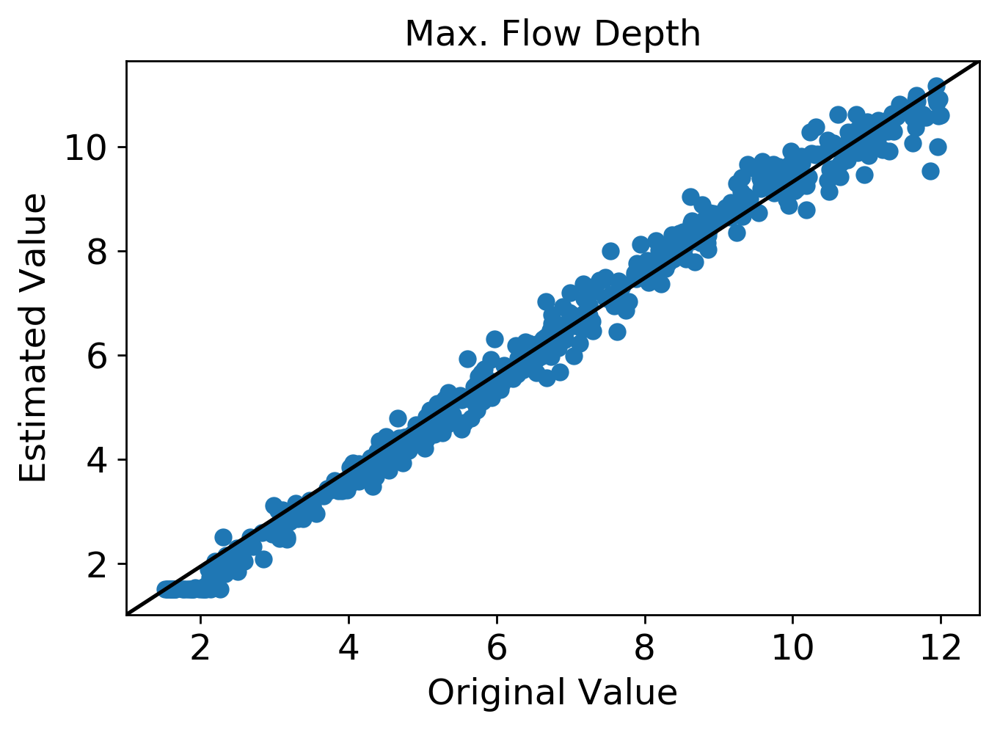

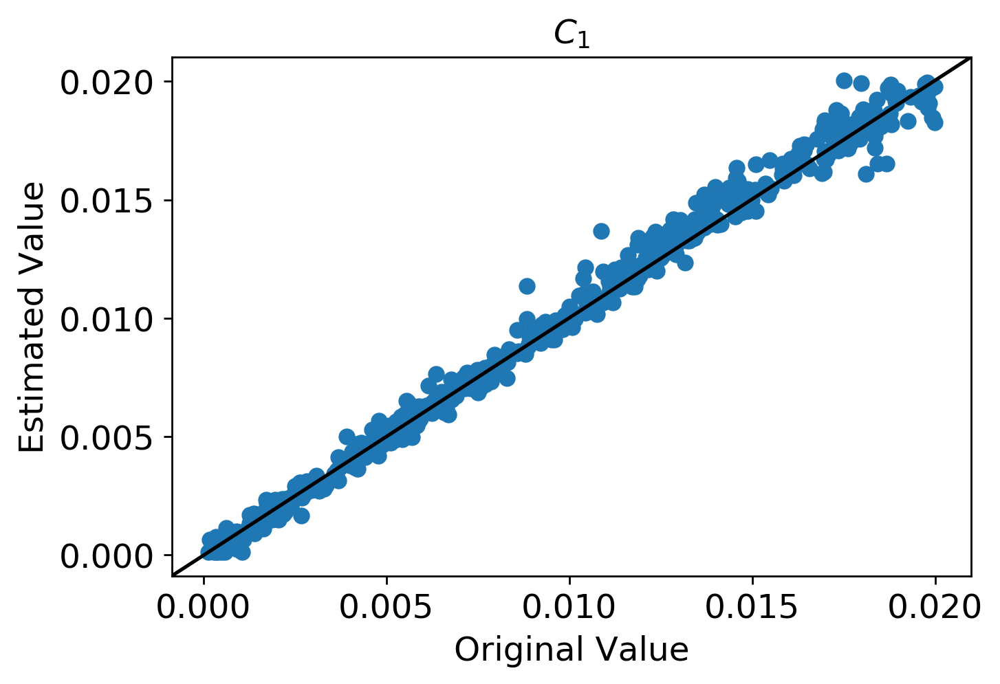

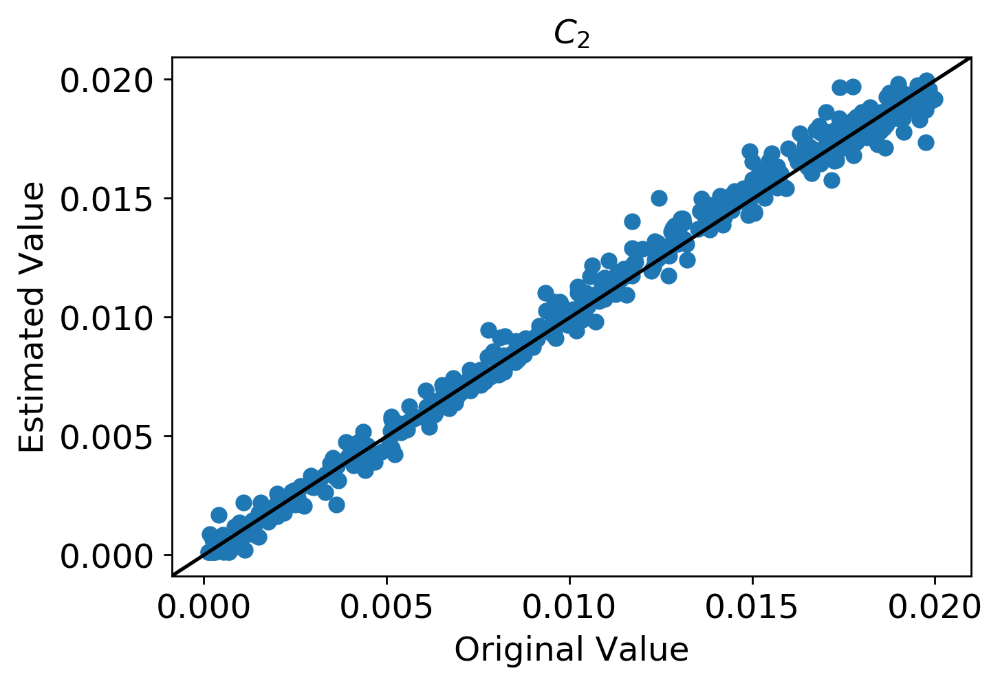

...

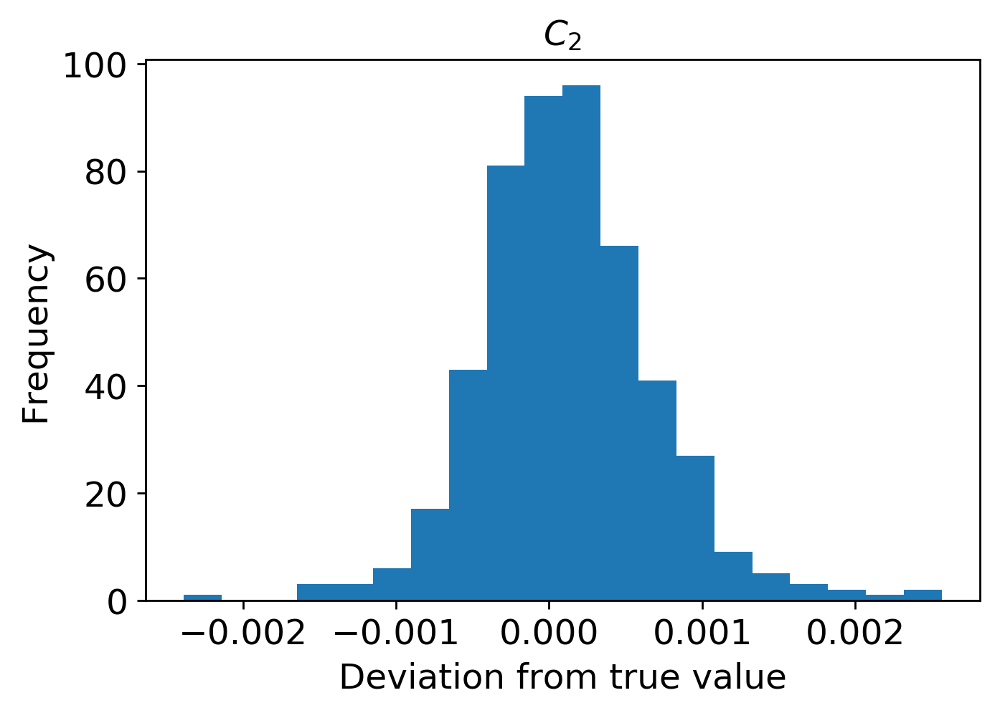

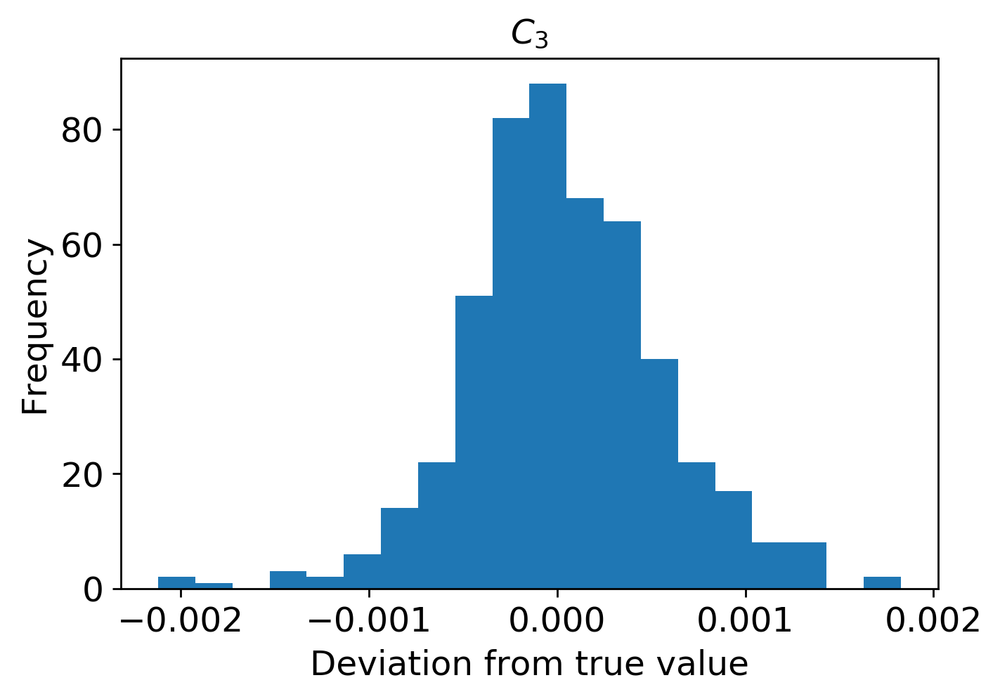

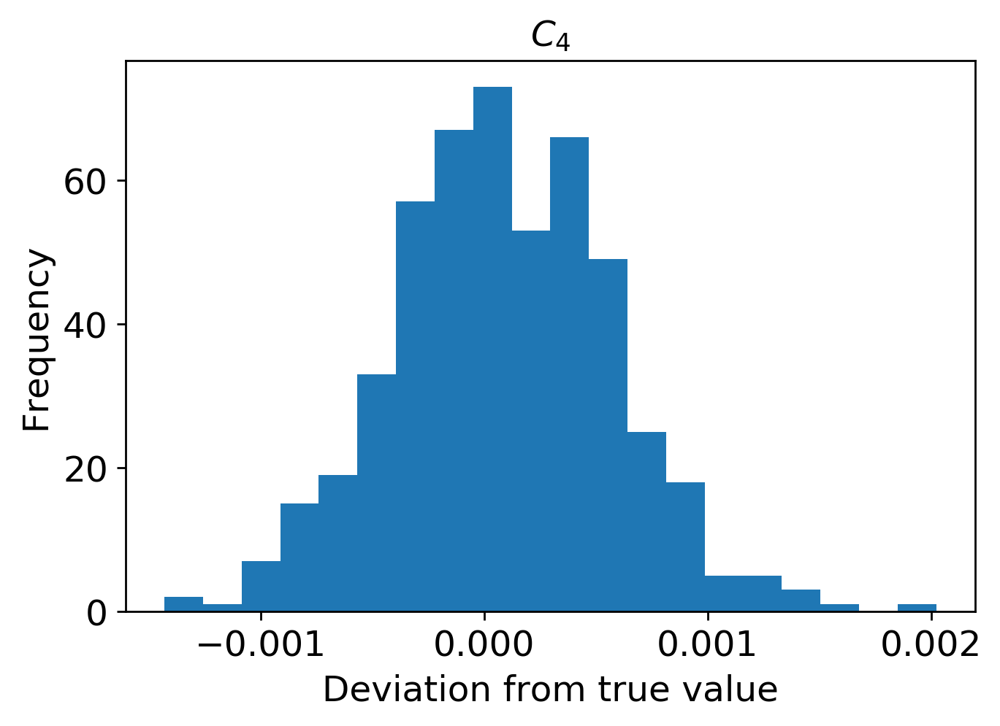

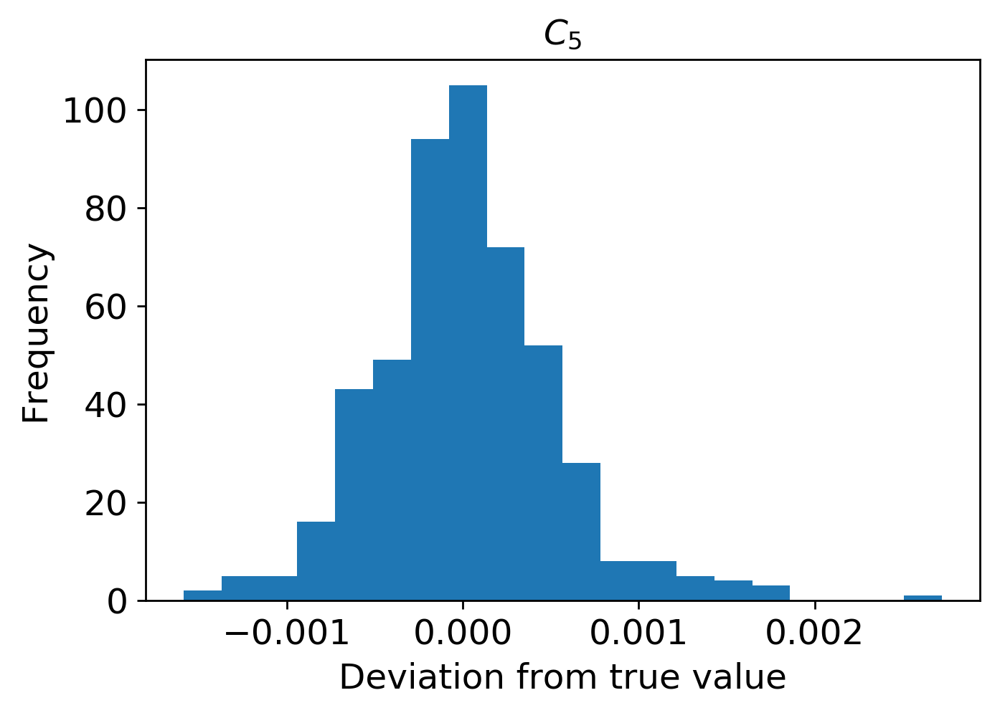

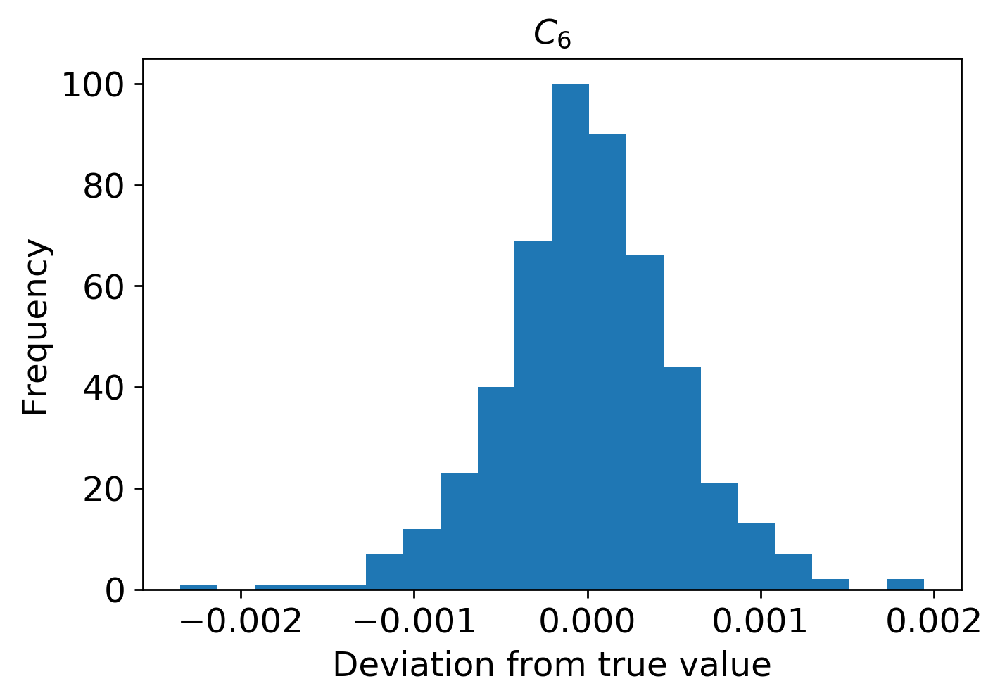

In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3000/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3000/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

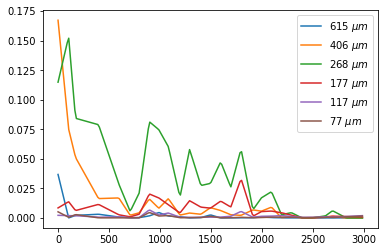

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3000/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3000/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3000.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



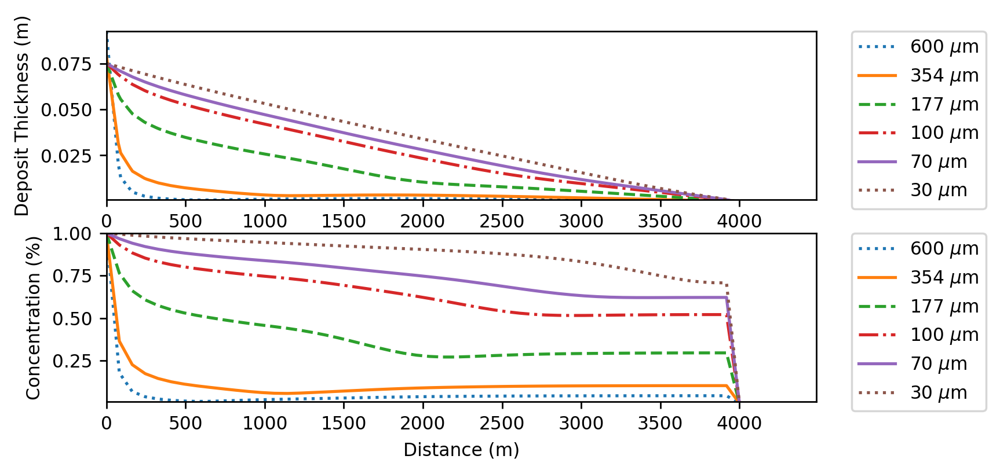

(5000, 9)
(5000, 1800)


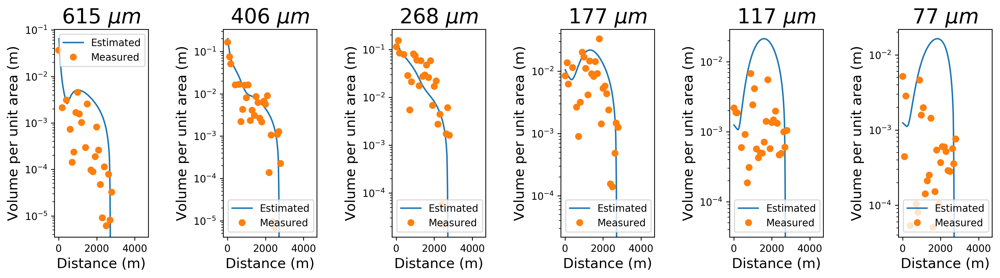

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3000.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3000.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3000.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3000.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3000.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3000.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3000.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3000.eps")
plt.show()

Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


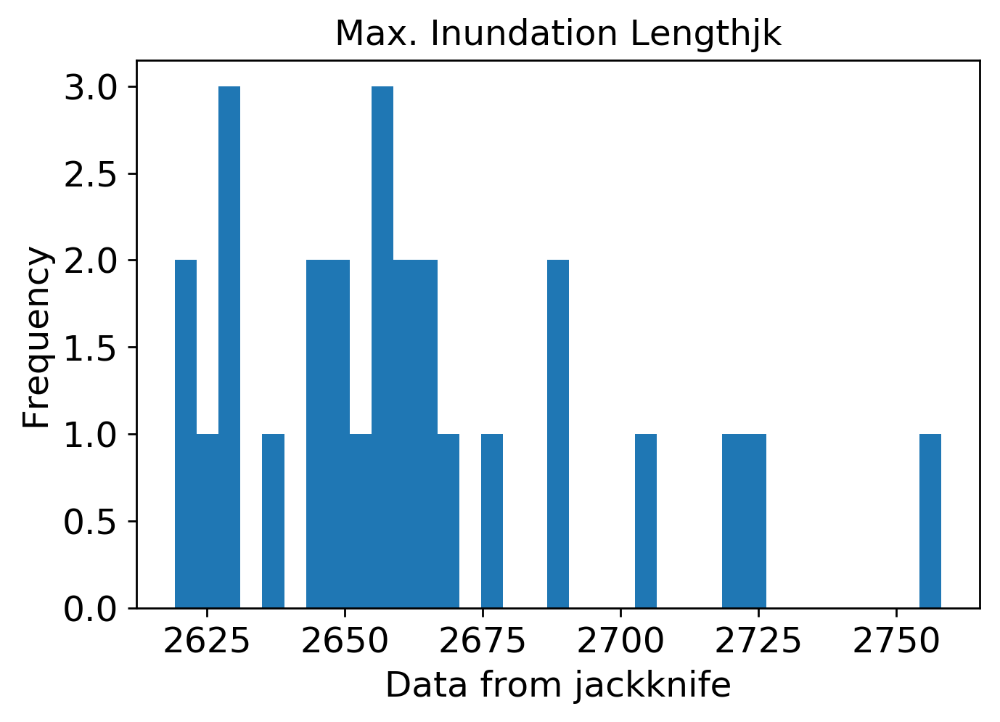

mean: 4.508060590547676
jk_e: 0.06221603263193793


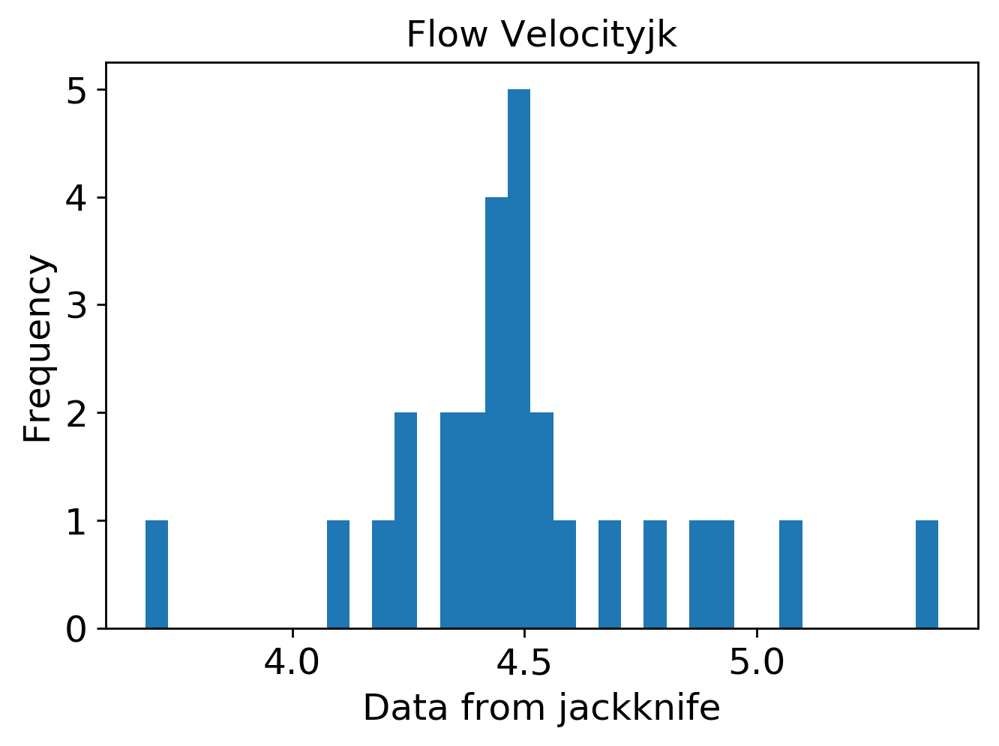

mean: 7.573823990322124
jk_e: 0.1407466778961747


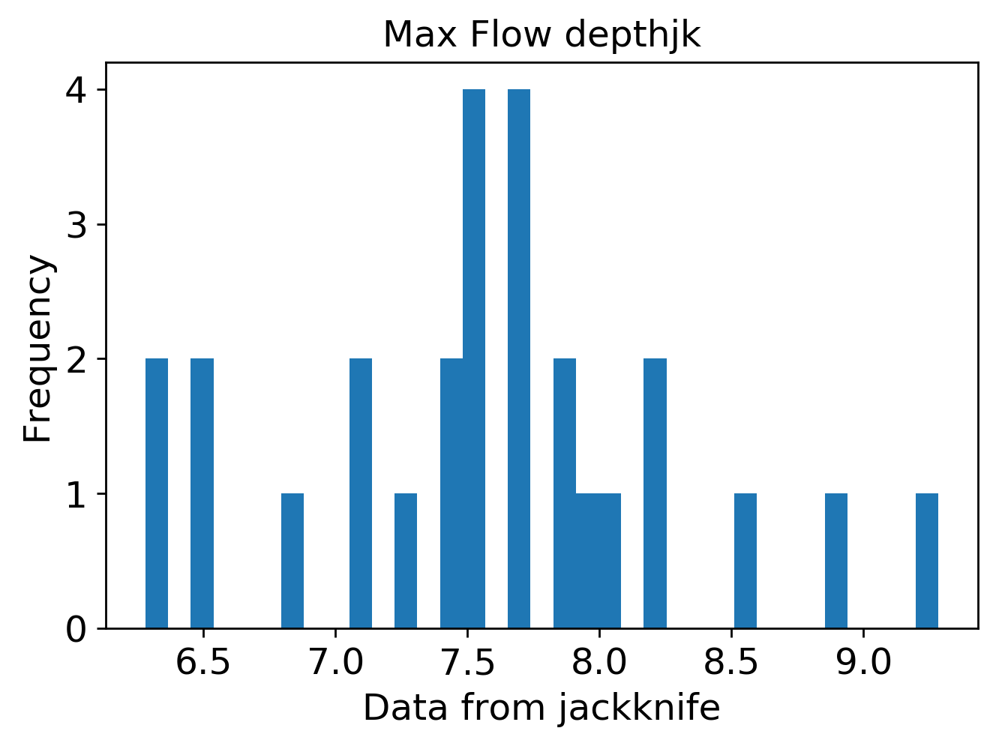

mean: 0.005819477756949309
jk_e: 0.00012864132420748551


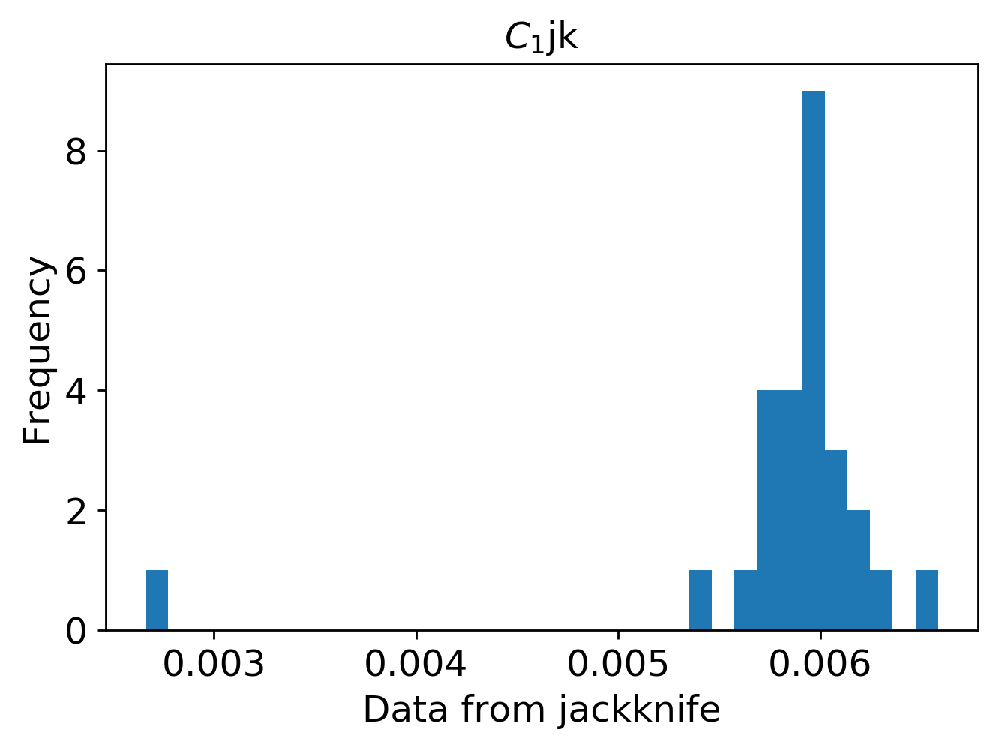

mean: 0.01754869237599208
jk_e: 0.0002464733156700854


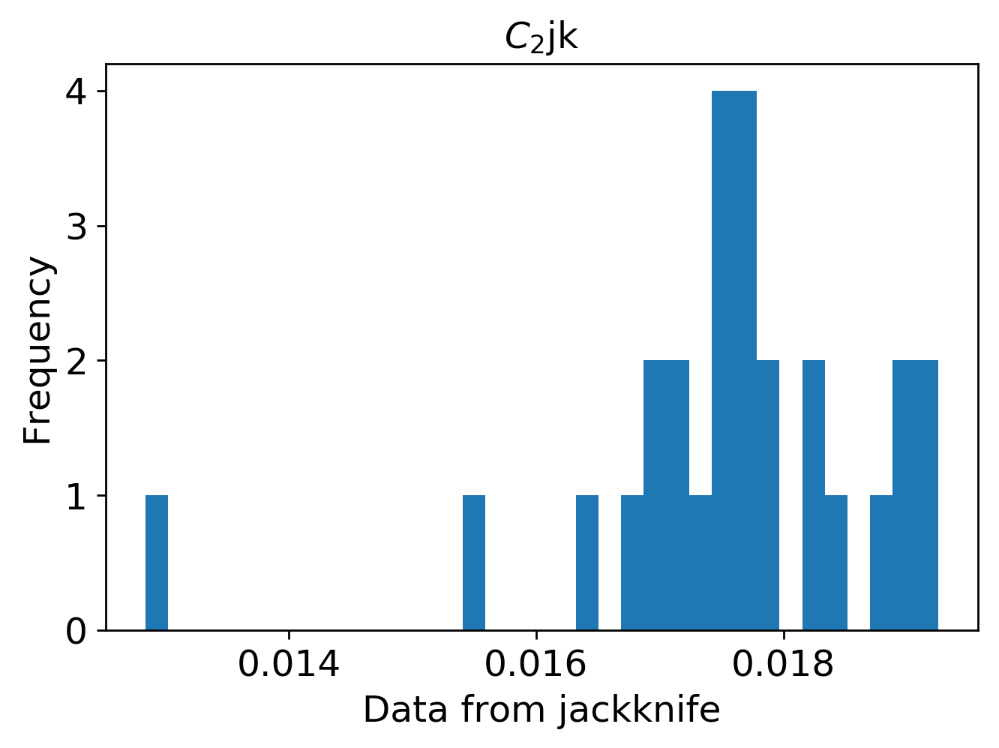

mean: 0.014395502059763188
jk_e: 0.0002987250064343152


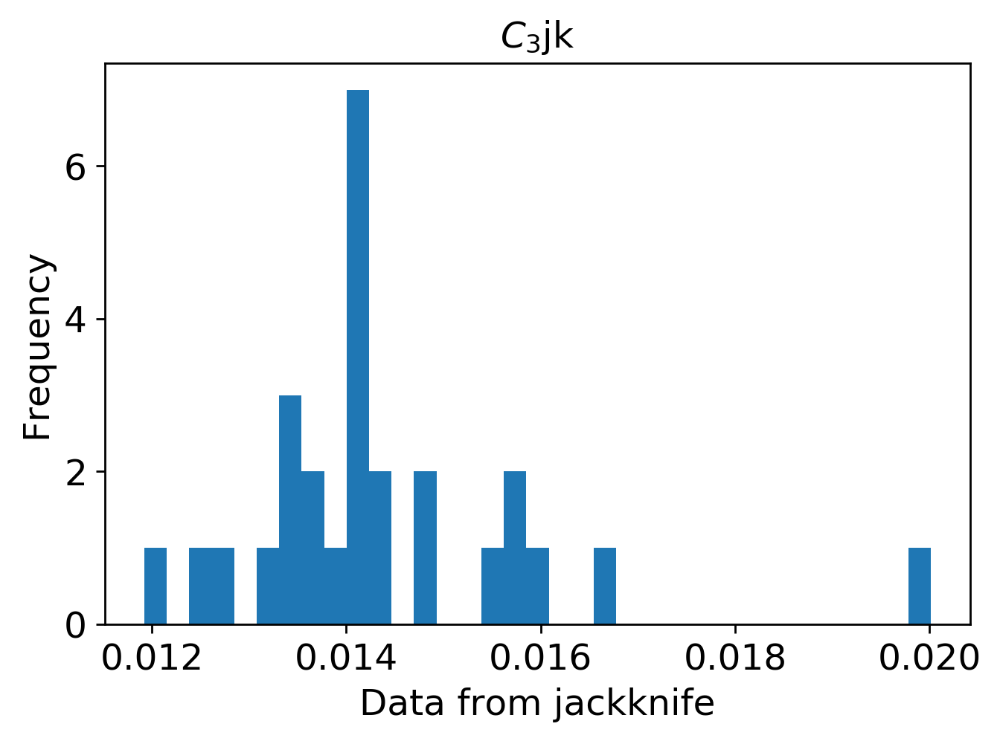

mean: 0.001199777367650561
jk_e: 3.154630688069397e-05


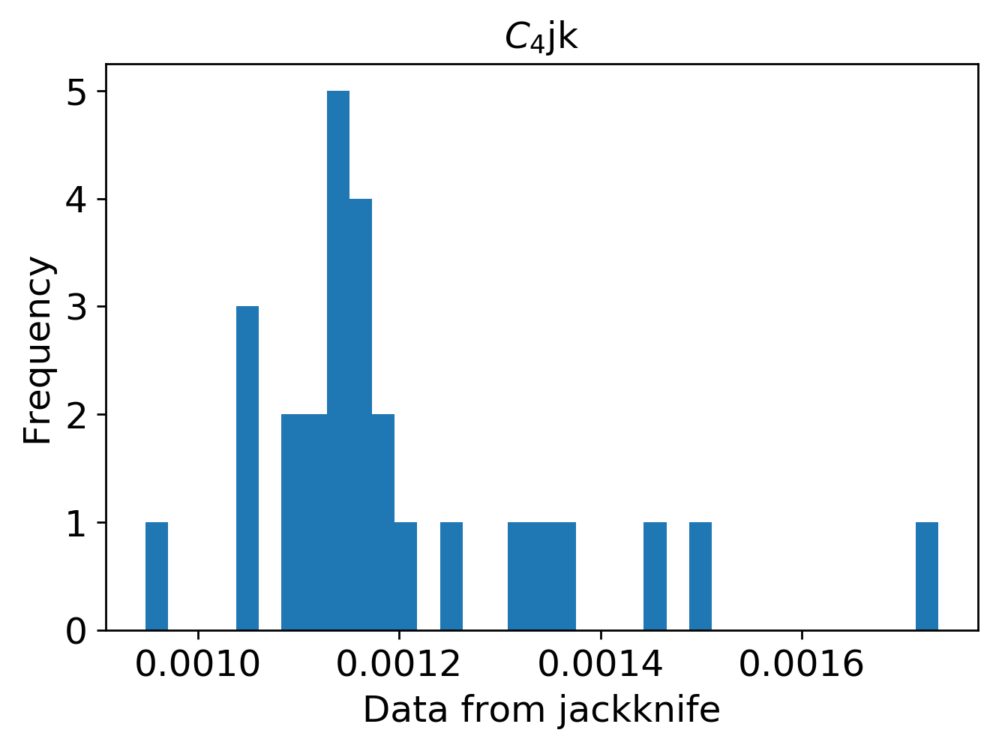

mean: 0.00010136096021857652
jk_e: 0.0


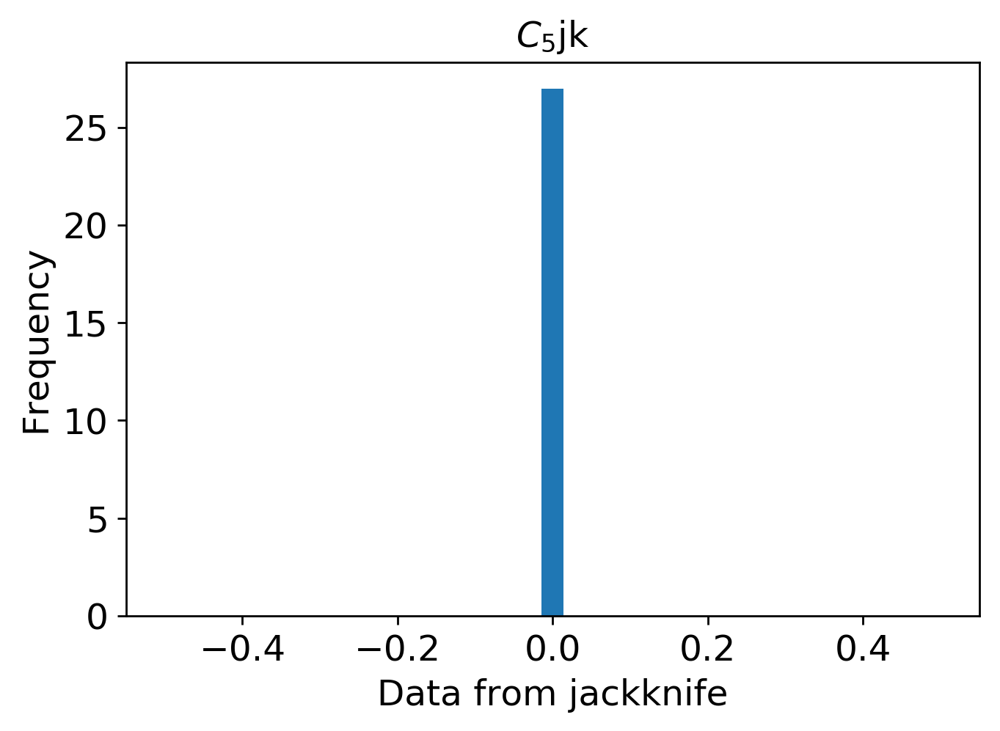

mean: 0.00040989205287197126
jk_e: 2.22981753061511e-05


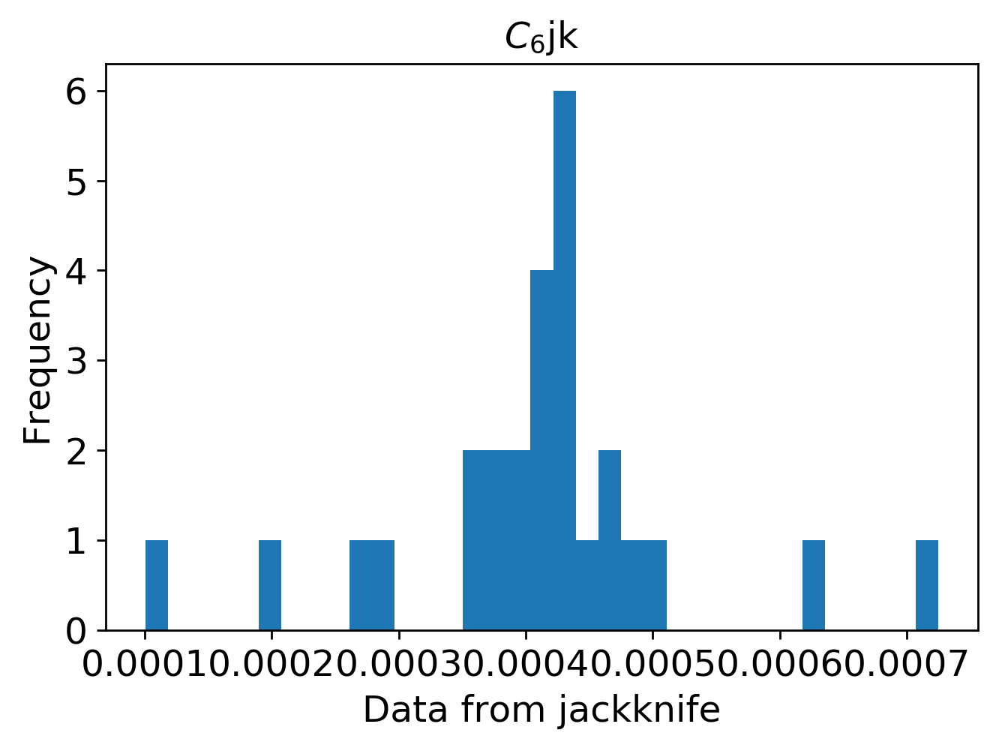

In [1]:
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3000/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3000/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3000.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3000.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3000.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()

# ROI 4000

In [7]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi4000"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=4000)
        
        
    

In [ ]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi4000/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi4000/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 527us/step - loss: 0.0979 - mean_squared_error: 0.0979 - val_loss: 0.0704 - val_mean_squared_error: 0.0704
Epoch 2/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0651 - mean_squared_error: 0.0651 - val_loss: 0.0563 - val_mean_squared_error: 0.0563
Epoch 3/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0555 - mean_squared_error: 0.0555 - val_loss: 0.0479 - val_mean_squared_error: 0.0479
Epoch 4/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0484 - mean_squared_error: 0.0484 - val_loss: 0.0403 - val_mean_squared_error: 0.0403
Epoch 5/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0429 - mean_squared_error: 0.0429 - val_loss: 0.0348 - val_mean_squared_error: 0.0348
Epoch 6/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0379 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 378us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 98/2000
3600/3600 [==============================] - 2s 428us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0070 - val_mean_squared_error: 0.0070
Epoch 99/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0052 - val_mean_squared_error: 0.0052
Epoch 100/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 101/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0054 - val_mean_squared_error: 0.0054
Epoch 102/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0057 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 374us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 194/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 195/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 196/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 197/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 198/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0038 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 384us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 290/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 291/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 292/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 293/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 294/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0028 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 379us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 386/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 387/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 388/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 389/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 390/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0024 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 382us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 482/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 483/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 484/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 485/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 486/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 383us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 578/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 579/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 580/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 581/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 582/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 393us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 674/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 675/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 676/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 677/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 678/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 388us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 770/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 771/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 772/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 773/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 774/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 389us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 866/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 867/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 868/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 869/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 870/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 393us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 962/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 963/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 964/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 965/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 966/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 388us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1058/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1059/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1060/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1061/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1062/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 382us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1106/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1107/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1108/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1109/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1110/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 394us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1154/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1155/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1156/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1157/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1158/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 387us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1202/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1203/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1204/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1205/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1206/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 387us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1250/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1251/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1252/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1253/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1254/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 381us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1298/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1299/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1300/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1301/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1302/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 384us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1346/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1347/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1348/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1349/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1350/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 386us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1394/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1395/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1396/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1397/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1398/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 378us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1442/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1443/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1444/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1445/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1446/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 398us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1490/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1491/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1492/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1493/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1494/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 377us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1538/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1539/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1540/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1541/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1542/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 381us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1586/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1587/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1588/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1589/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1590/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi4000/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi4000/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

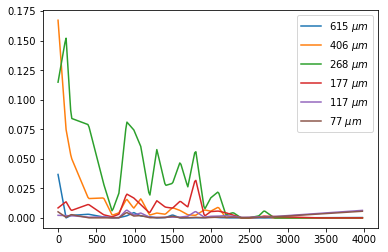

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi4000/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi4000/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi4000.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi4000.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi4000.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi4000.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi4000.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi4000.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi4000.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi4000.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi4000.eps")
plt.show()

Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


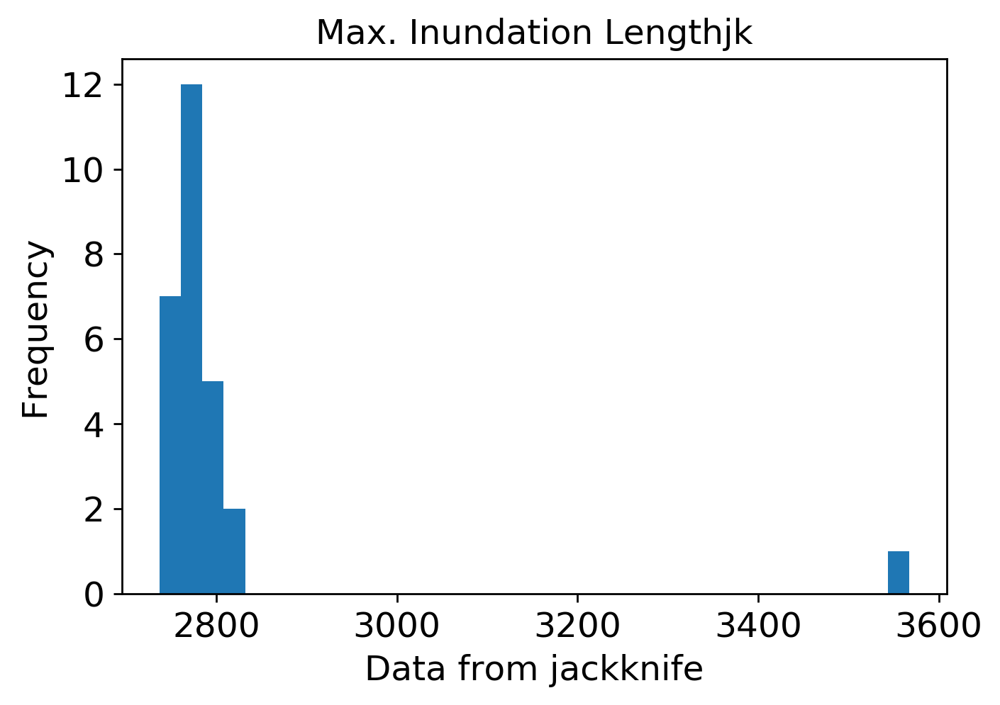

mean: 5.203397778943186
jk_e: 0.09785675504992701


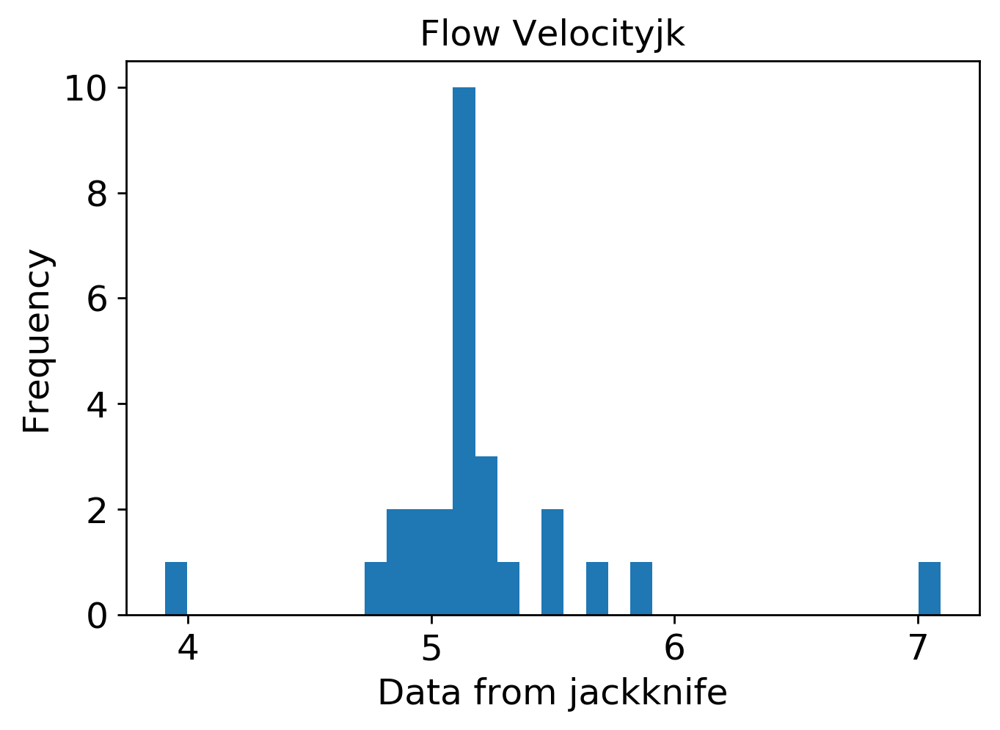

mean: 6.202182894603141
jk_e: 0.14803621267911932


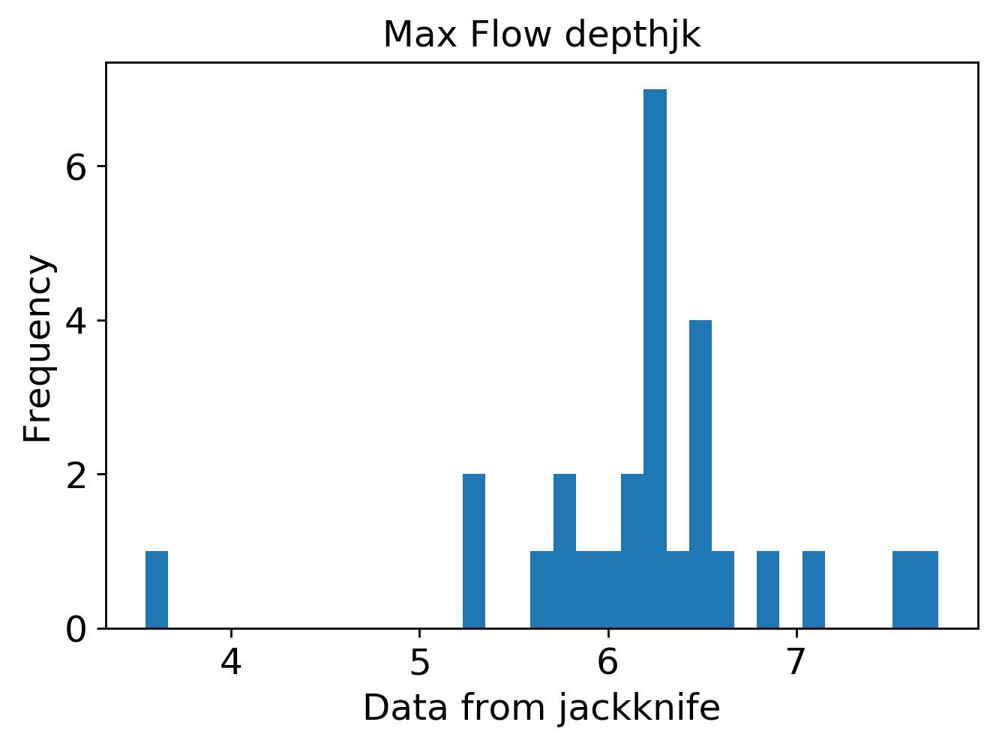

mean: 0.006324136197115053
jk_e: 0.000163783842458382


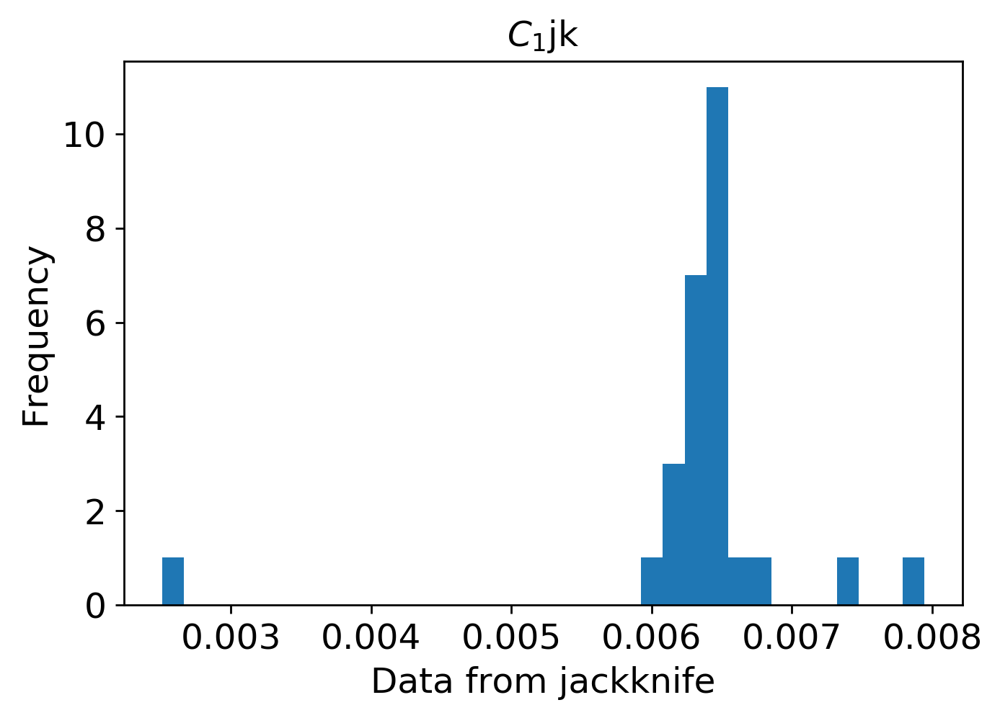

mean: 0.01925047459771814
jk_e: 0.0003419609166645373


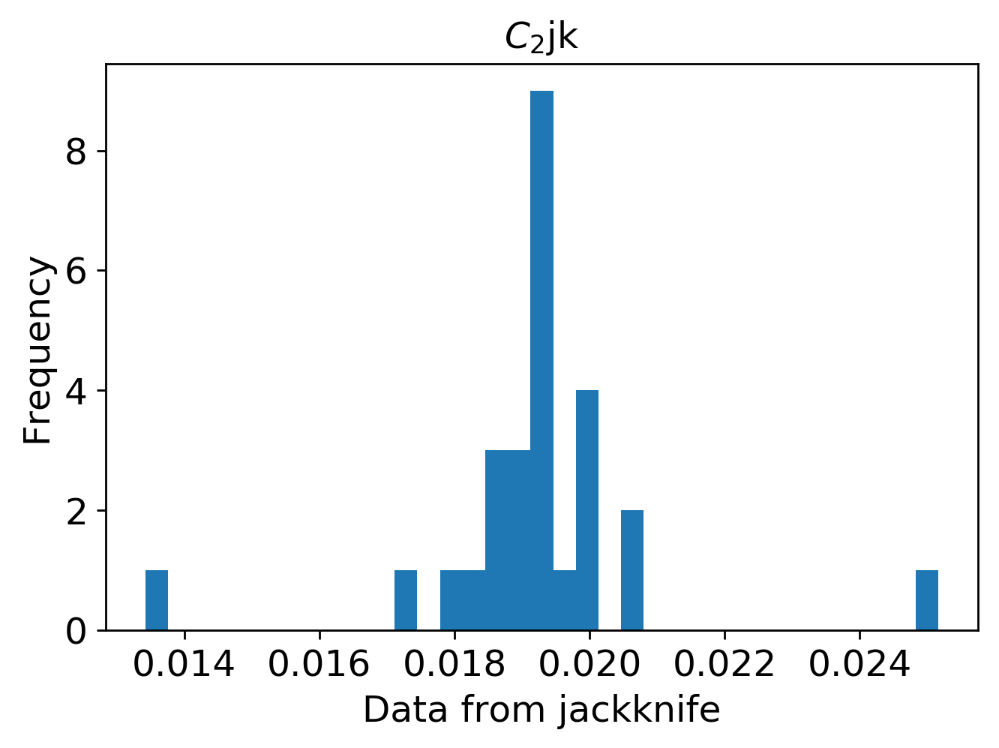

mean: 0.016350711911434154
jk_e: 0.00038417832524203626


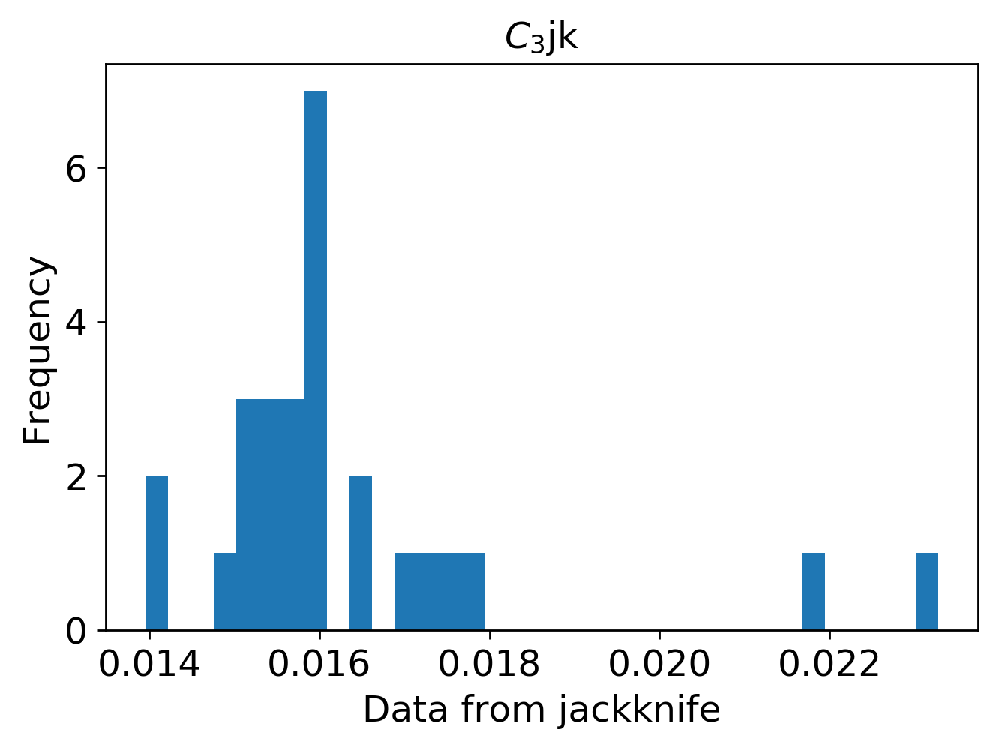

mean: 0.0007655288702823242
jk_e: 6.943686131893712e-05


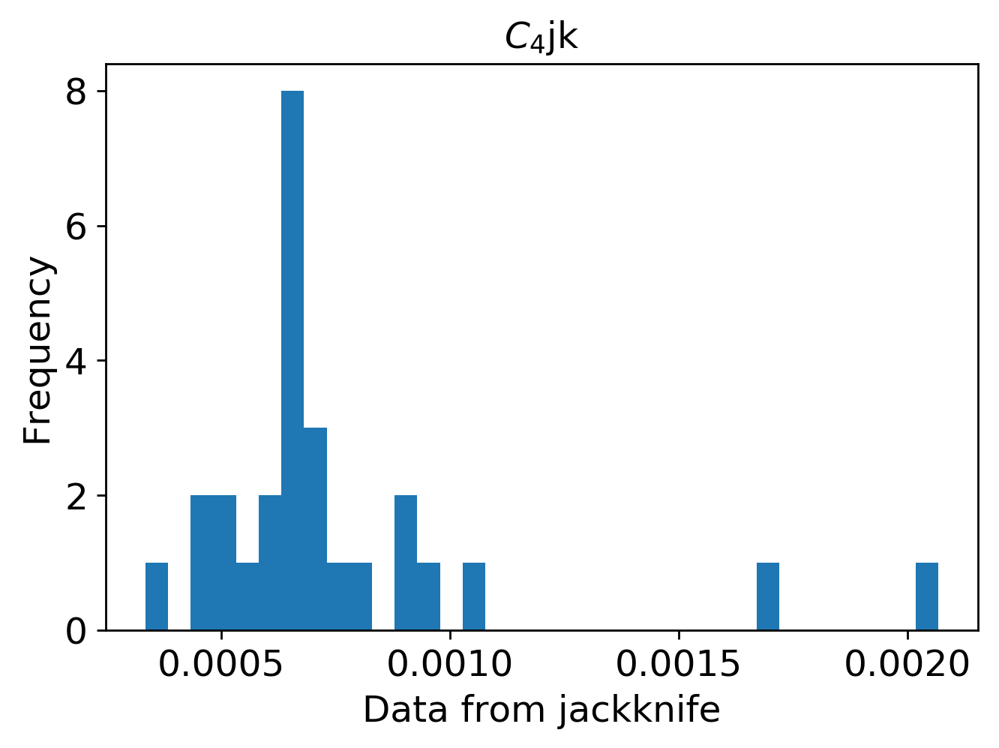

mean: 0.000225502855687054
jk_e: 8.655752228070706e-05


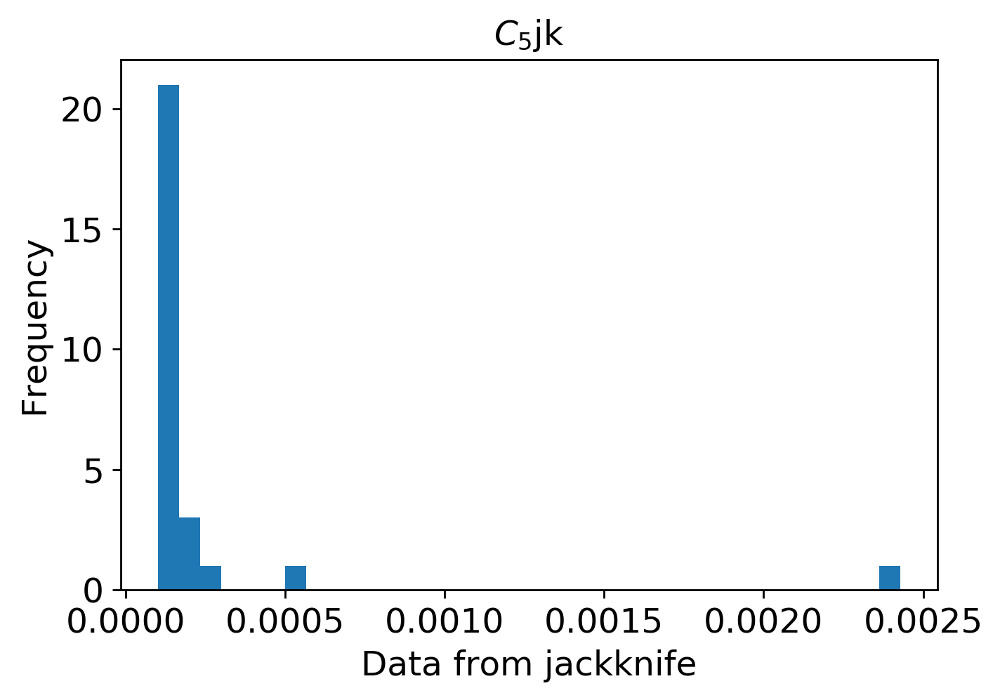

mean: 0.00016370008560802395
jk_e: 6.292639178743771e-05


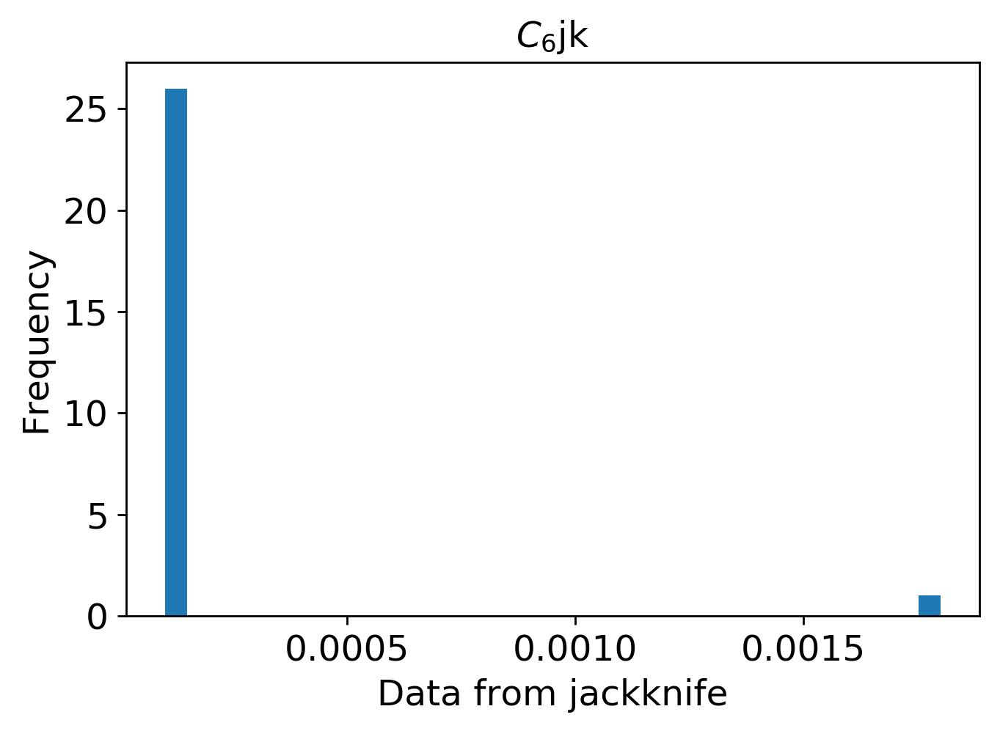

In [1]:
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi4000/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi4000/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi4000.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi4000.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi4000.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()

# ROI 3500

In [3]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3500"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3500)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 3s 699us/step - loss: 0.0924 - mean_squared_error: 0.0924 - val_loss: 0.0700 - val_mean_squared_error: 0.0700
Epoch 2/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0647 - mean_squared_error: 0.0647 - val_loss: 0.0558 - val_mean_squared_error: 0.0558
Epoch 3/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0553 - mean_squared_error: 0.0553 - val_loss: 0.0473 - val_mean_squared_error: 0.0473
Epoch 4/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0483 - mean_squared_error: 0.0483 - val_loss: 0.0405 - val_mean_squared_error: 0.0405
Epoch 5/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0429 - mean_squared_error: 0.0429 - val_loss: 0.0344 - val_mean_squared_error: 0.0344
Epoch 6/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0378 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 373us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 98/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 99/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 100/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 101/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 102/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0062 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 386us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 194/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 195/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 196/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 197/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 198/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0036 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 369us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 290/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 291/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 292/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 293/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 294/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0032 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 382us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 386/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 387/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 388/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 389/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 390/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 377us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 482/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 483/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 484/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 485/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 486/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 377us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 578/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 579/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 580/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 581/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 582/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 380us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 674/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 675/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 676/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 677/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 678/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 363us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 770/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 771/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 772/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 773/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 774/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 383us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 866/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 867/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 868/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 869/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 870/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0016 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 382us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 962/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 963/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 964/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 965/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 966/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 369us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1058/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1059/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1060/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1061/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1062/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_erro

3600/3600 [==============================] - 1s 377us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1106/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1107/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1108/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1109/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1110/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 374us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1154/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1155/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1156/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1157/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1158/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 378us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1202/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1203/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1204/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1205/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1206/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 360us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1250/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1251/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1252/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1253/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1254/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1298/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1299/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1300/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1301/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1302/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 385us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1346/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1347/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1348/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1349/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1350/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 381us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1394/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1395/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1396/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1397/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1398/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 387us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1442/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1443/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1444/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1445/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1446/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 370us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1490/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1491/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1492/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1493/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1494/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 370us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1538/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1539/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1540/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1541/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1542/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 374us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1586/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1587/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1588/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1589/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1590/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1634/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1635/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1636/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1637/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1638/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 388us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1682/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1683/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1684/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1685/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1686/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 413us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1730/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1731/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1732/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1733/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1734/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 370us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1778/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1779/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1780/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1781/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1782/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 377us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1826/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1827/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1828/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1829/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1830/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_erro

Epoch 1873/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1874/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1875/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1876/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1877/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1878/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_m

Epoch 1921/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1922/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1923/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1924/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1925/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1926/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1970/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1971/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1972/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1973/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1974/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_m

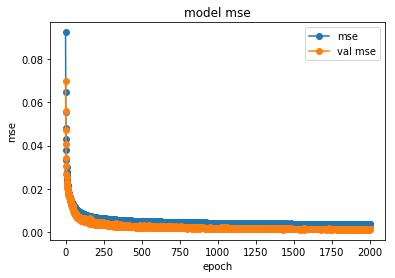

save the model


In [4]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3500/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3500/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3500/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3500/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

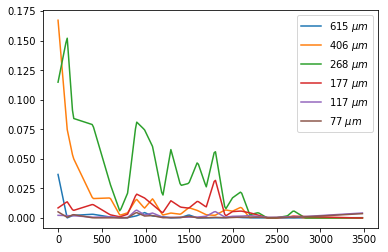

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3500/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3500/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3500.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3500.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3500.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3500.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3500.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3500.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3500.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3500.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3500.eps")
plt.show()

Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


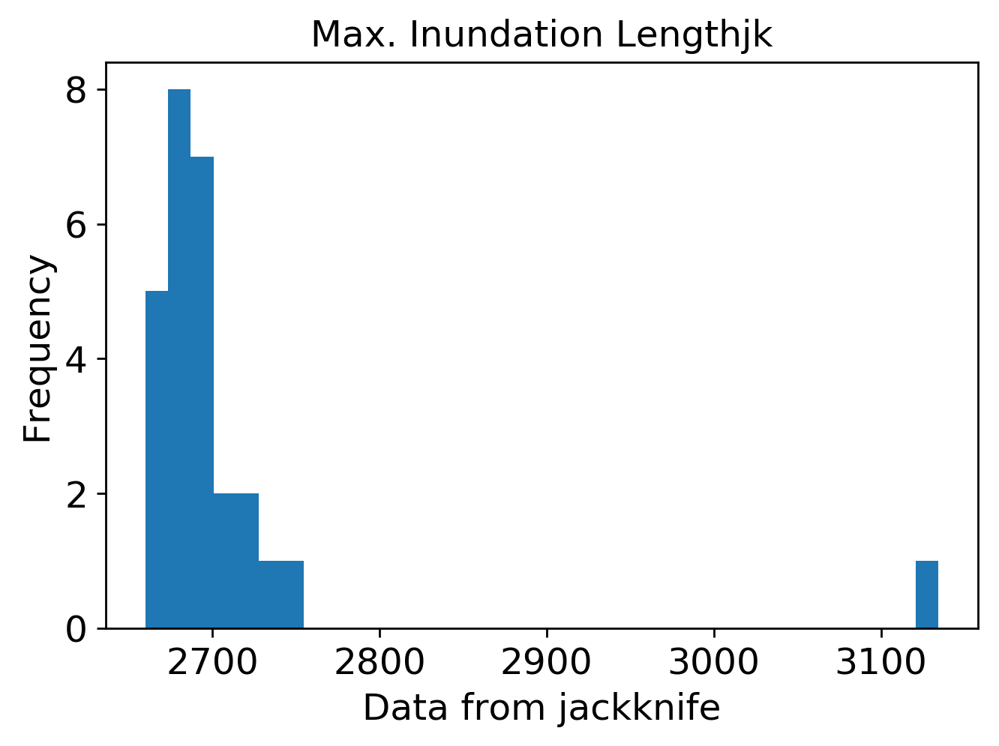

mean: 4.961433230179624
jk_e: 0.0729098387600563


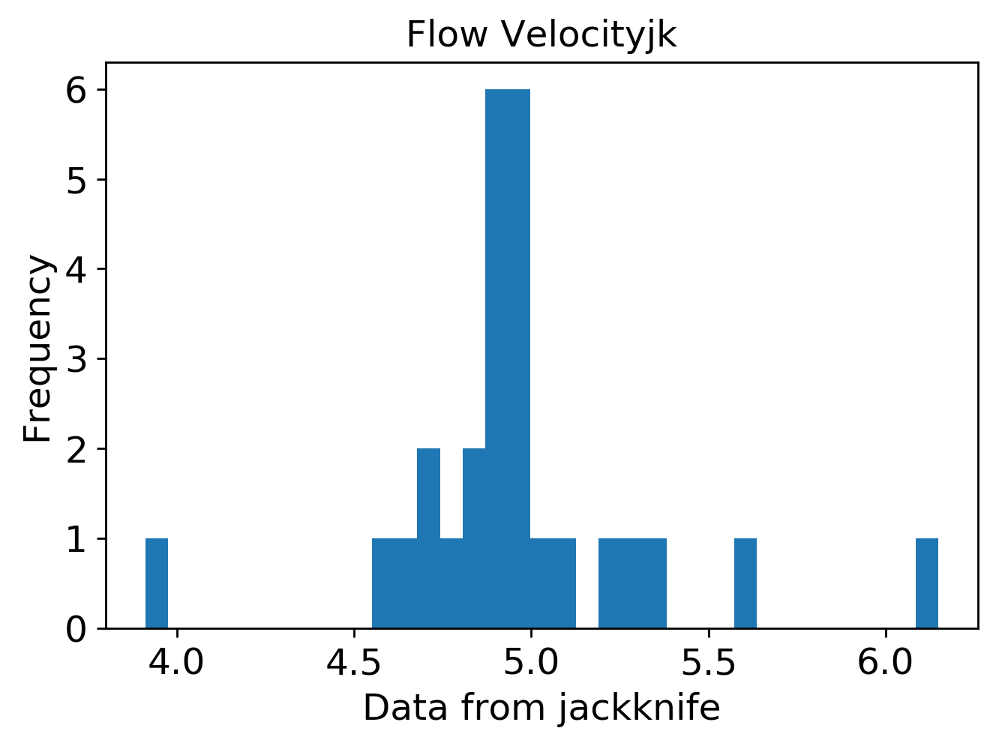

mean: 6.931590711673742
jk_e: 0.16721584243937085


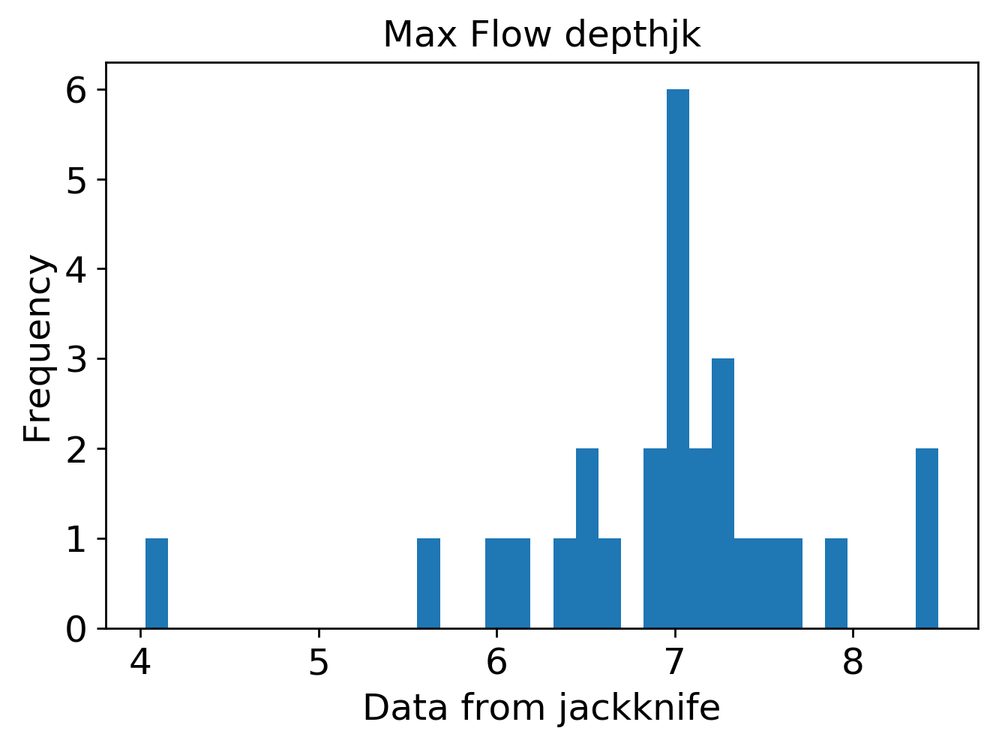

mean: 0.006097539675157835
jk_e: 0.00014333548960443522


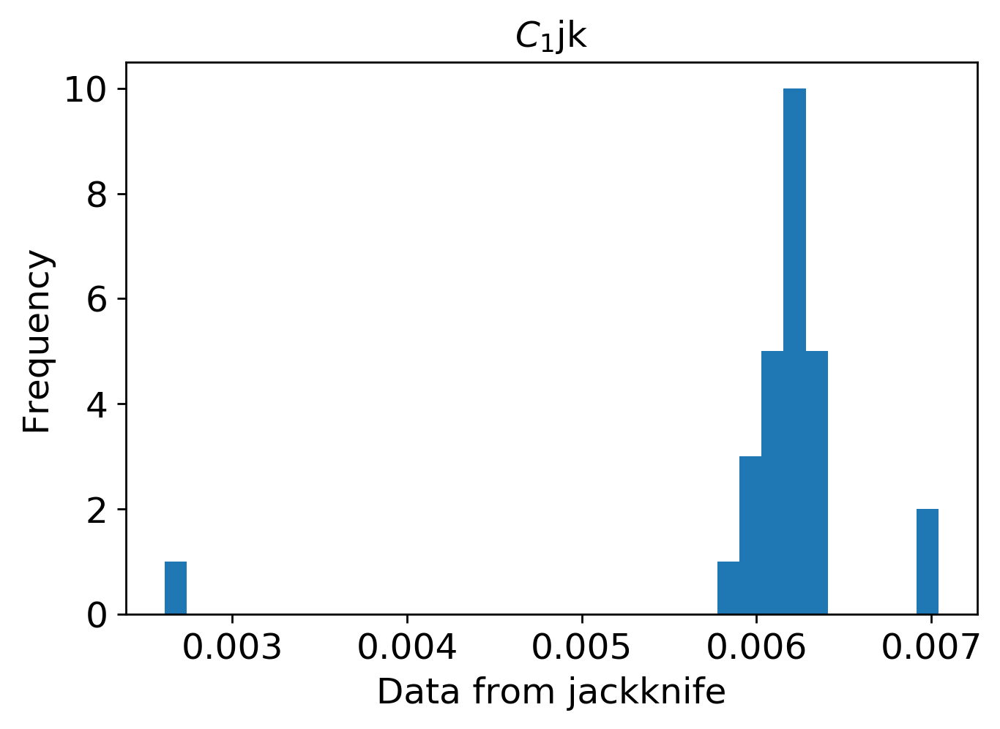

mean: 0.018438473018426698
jk_e: 0.00030936956293354953


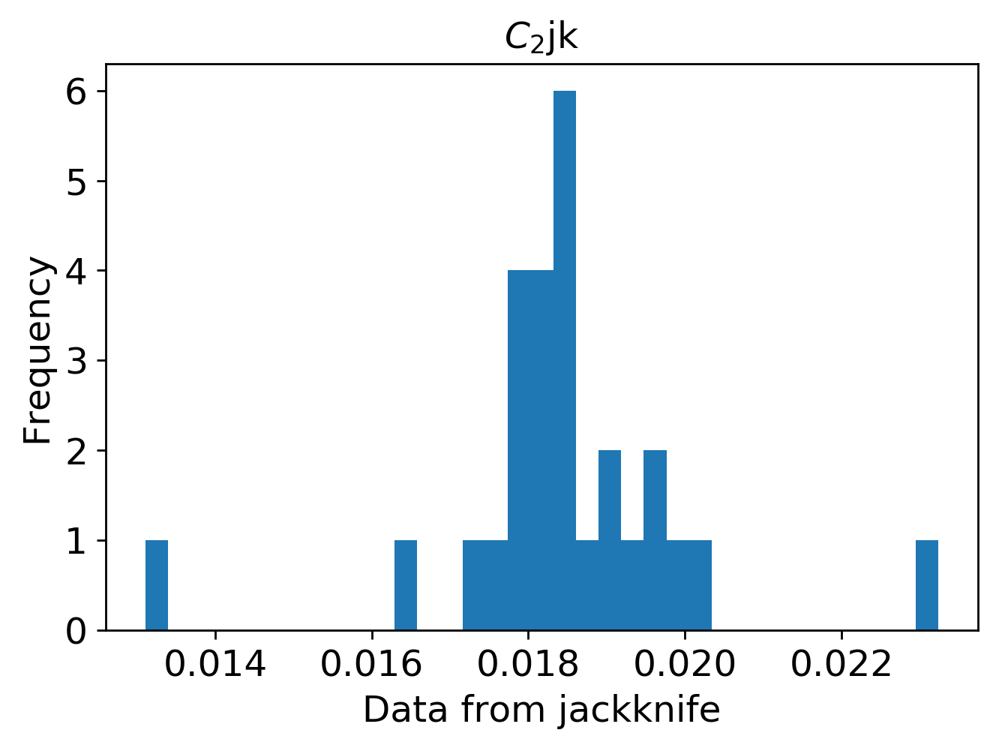

mean: 0.01594368542377634
jk_e: 0.00032807806599860864


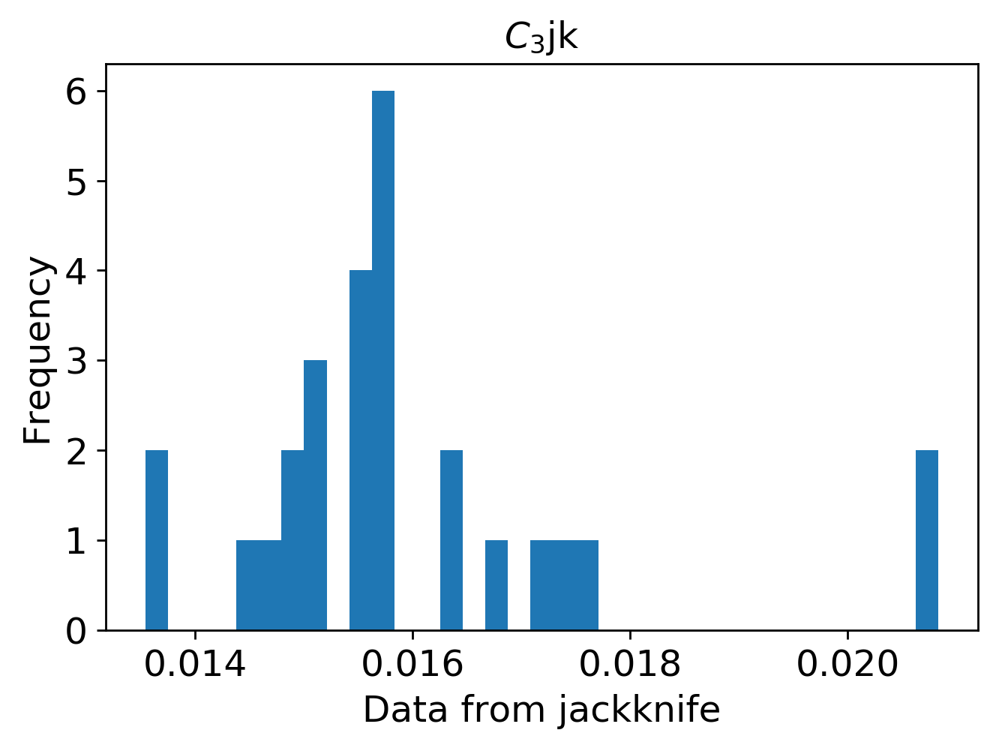

mean: 0.0011221118707438
jk_e: 3.540638989402596e-05


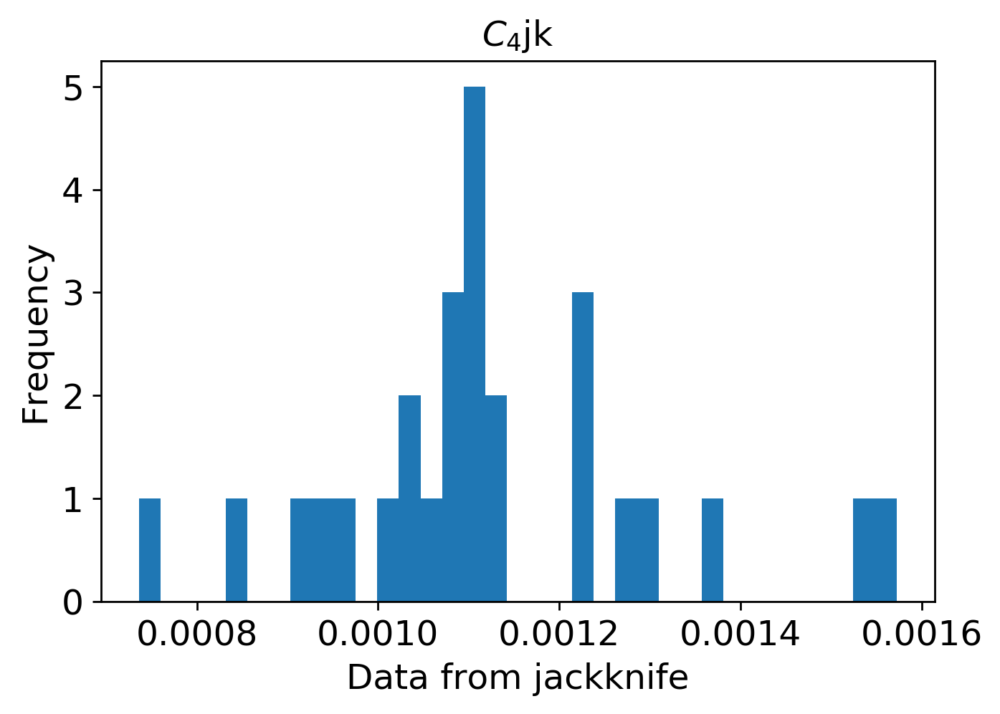

mean: 0.0001545849921135167
jk_e: 4.36865523084919e-05


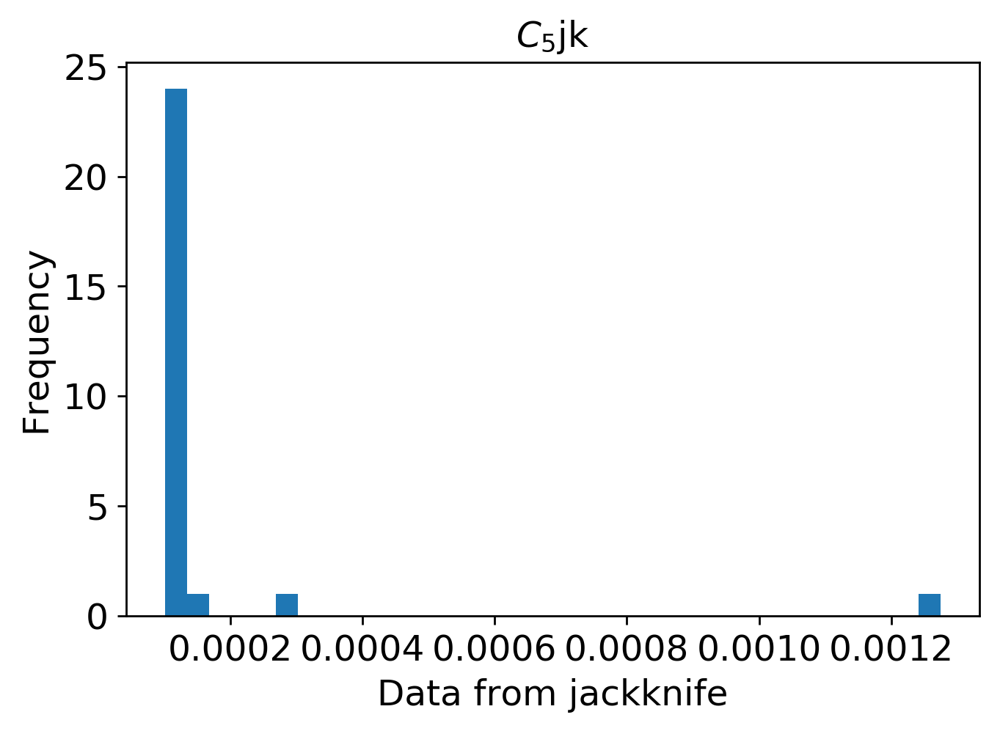

mean: 0.00011536151949344493
jk_e: 1.23148586323837e-05


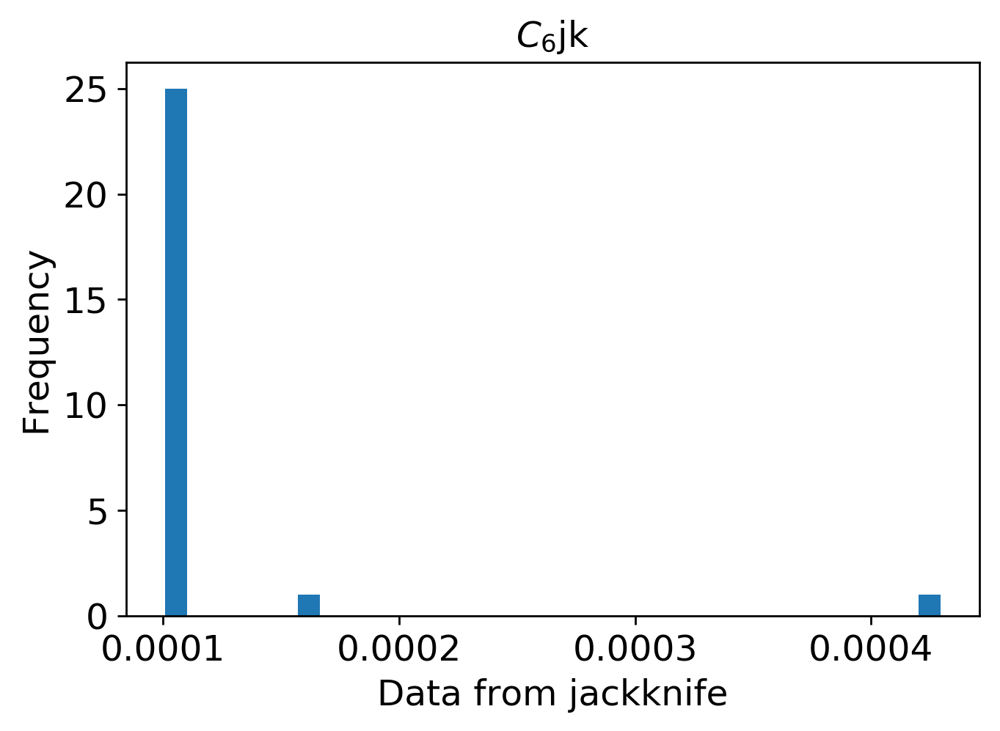

In [1]:
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3500/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3500/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3500.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3500.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3500.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()